## Setup, Loading Data and CDFs

In [1]:
DATA_NAME = 'agriVision-full' 
TRANSFORM = 'learned'
CHANNEL = ''

In [2]:
path_list = DATA_NAME.split("-") + TRANSFORM.split("-")
if CHANNEL:
    path_list.append(CHANNEL)
print(f"Name the notebook:\n{'_'.join(path_list[::-1])}.ipynb")
FULL_DATA_NAME='-'.join(path_list)

Name the notebook:
learned_full_agriVision.ipynb


In [3]:
import git
from pathlib import Path
import os

ROOT_DIR = Path(git.Repo('.', search_parent_directories=True).working_tree_dir)
CWD = os.path.join(ROOT_DIR, "results", "case-studies", *path_list)

assert CWD == os.getcwd()
Path(os.path.join(CWD, "CSVs")).mkdir(exist_ok=True)
Path(os.path.join(CWD, "plots")).mkdir(exist_ok=True)
Path(os.path.join(CWD, "cache")).mkdir(exist_ok=True)

GROUP = 'layer' if TRANSFORM.split("-")[0] == 'wavelet' else ('band' if TRANSFORM.split("-")[0] == 'fourier' else 'filter_idx')
RERUN = False
SKIP_OPTIMIZE_STEP = False
CWD

'/Users/brandonmarks/Desktop/hierarchical-bayesian-model-validation/results/case-studies/agriVision/full/learned'

In [4]:
os.chdir(os.path.join(ROOT_DIR, "utilities"))
from testing import * # If MATLAB is not installed, open utilities and set to False
from plotting import *
from learned import *
os.chdir(CWD)
np.random.seed(0)

In [5]:
group_data_map = pd.read_pickle(os.path.join(ROOT_DIR, "transformed-data", f'{FULL_DATA_NAME}.pickle'))
group_total_samples = pd.read_pickle(os.path.join(ROOT_DIR, "transformed-data", f'{FULL_DATA_NAME}-size.pickle'))
nonskewed_df = pd.read_csv(os.path.join(ROOT_DIR, 'learned-filters', 'nonskewed_filter_idxs_df.csv')).set_index(['dataset', 'num_images', 'num_bootstrap'])
nonskewed_filter_idxs = eval(nonskewed_df.loc[DATA_NAME].sort_values('num_images', ascending=False)['nonskewed_filter_idxs'].iloc[0])
filter_group_map = pd.read_pickle(os.path.join(ROOT_DIR, 'learned-filters', 'filter_group_map.pickle'))

In [6]:
if 'fourier' in TRANSFORM:
    GROUPS = np.arange(2, sorted(group_data_map)[-1] + 1)[::3]
elif 'wavelet' in TRANSFORM:
    GROUPS = np.arange(2, sorted(group_data_map)[-1] + 1)
elif 'learned' in TRANSFORM: 
    GROUPS = nonskewed_filter_idxs # can set to filter_group_map.keys() to include all prepared filters

cdfs_dir = os.path.join(ROOT_DIR, "results", "CDFs")
cdfs_list = sorted([os.path.join(cdfs_dir, i) for i in os.listdir(cdfs_dir)])
all_cdfs = combine_pickles(cdfs_list[0])
for cdf_dir in cdfs_list[:6]: # TODO For quick testing purposes. Currently excluding 20000 CDFs. Use cdfs_list[5:6] to access CDFs/_test
    all_cdfs = all_cdfs | combine_pickles(cdf_dir)
    
# group_data_map = {g : group_data_map[g][::100] for g in GROUPS} # TODO For quick testing purposes
group_total_samples

{0: 786432000,
 1: 786432000,
 2: 786432000,
 3: 786432000,
 4: 786432000,
 5: 786432000,
 6: 786432000,
 7: 786432000,
 8: 786432000,
 9: 786432000,
 10: 786432000,
 11: 786432000,
 12: 786432000,
 13: 786432000,
 14: 786432000,
 15: 786432000,
 16: 786432000,
 17: 786432000,
 18: 786432000,
 19: 786432000,
 20: 786432000,
 21: 786432000,
 22: 786432000,
 23: 786432000,
 24: 786432000,
 25: 786432000,
 26: 786432000,
 27: 786432000,
 28: 786432000,
 29: 786432000,
 30: 786432000,
 31: 786432000,
 32: 786432000,
 33: 786432000,
 34: 786432000,
 35: 786432000,
 36: 786432000,
 37: 786432000,
 38: 786432000,
 39: 786432000,
 40: 786432000,
 41: 786432000,
 42: 786432000,
 43: 786432000,
 44: 786432000,
 45: 786432000,
 46: 786432000,
 47: 786432000,
 48: 786432000,
 49: 786432000,
 50: 786432000,
 51: 786432000,
 52: 786432000,
 53: 786432000,
 54: 786432000,
 55: 786432000,
 56: 786432000,
 57: 786432000,
 58: 786432000,
 59: 786432000,
 60: 786432000,
 61: 786432000,
 62: 786432000,
 6

Running 12760 CDFs


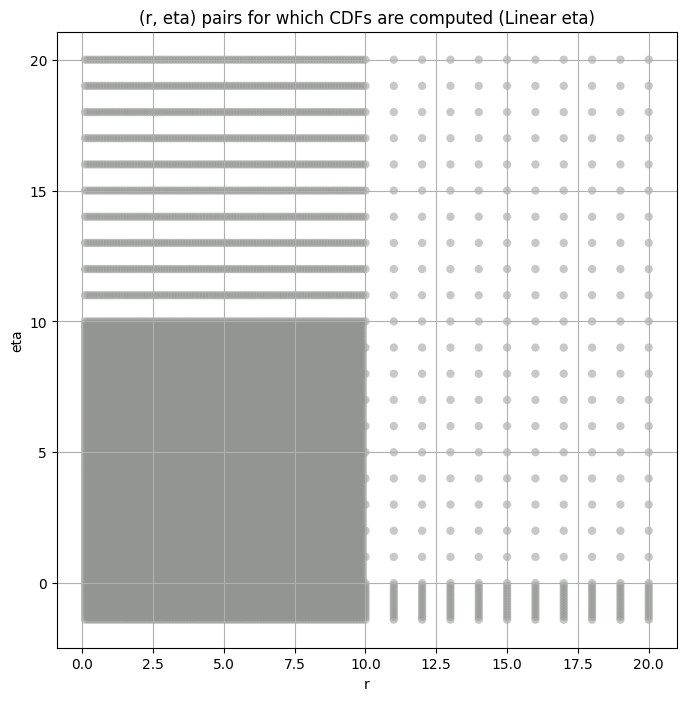

,"(r,eta),cdf",r,eta,cdf,variance,kurtosis
0,"((0.1, -1.4), <scipy.interpolate._fitpack2.Int...",0.1,-1.4,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.628800e+06,554265.000000
1,"((0.1, -1.3), <scipy.interpolate._fitpack2.Int...",0.1,-1.3,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.991680e+07,96192.272727
2,"((0.1, -1.2), <scipy.interpolate._fitpack2.Int...",0.1,-1.2,<scipy.interpolate._fitpack2.InterpolatedUniva...,2.395008e+08,29390.000000
3,"((0.1, -1.1), <scipy.interpolate._fitpack2.Int...",0.1,-1.1,<scipy.interpolate._fitpack2.InterpolatedUniva...,1.037837e+09,11997.692308
4,"((0.1, -1.0), <scipy.interpolate._fitpack2.Int...",0.1,-1.0,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.632429e+09,5874.890110


In [7]:
warnings.filterwarnings('ignore', category=RuntimeWarning)

all_cdfs_df = create_kurt_var_ksstat_df(all_cdfs)
fine_cdfs_df = all_cdfs_df.copy()
all_cdfs_df = all_cdfs_df[(np.round(all_cdfs_df['r'], 1) == all_cdfs_df['r']) & (np.round(all_cdfs_df['eta'], 1) == all_cdfs_df['eta'])]
all_cdfs_df = all_cdfs_df.reset_index(drop=True)
all_cdfs = {x[0] : x[1] for x in all_cdfs_df["(r,eta),cdf"]}
                                             
var_values_dict = dict()
kurt_values_dict = dict()
master_df = pd.DataFrame(columns=[GROUP]).set_index(GROUP)
temp_cdf = all_cdfs_df
print(f"Running {all_cdfs_df.shape[0]} CDFs")
create_scatter_plot(all_cdfs_df);
all_cdfs_df.head()

## Bootstrapping the Variance and Kurtosis

In [8]:
n_bootstrap = int(1e3) # TODO For quick testing purposes
bootstrap_size = int(1e3) # TODO For quick testing purposes
ci = 0.99

In [9]:
bootstrap_path = Path(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))
master_df_var_kurt_path = Path(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))

if True or not master_df_var_kurt_path.exists(): # TODO For quick testing purposes
    for group in GROUPS:
        print(f'{GROUP.capitalize()} {group}')
        obs_var, var_lower, var_upper, var_values_dict[group] = bootstrap_metric(group_data_map[group], 
                                                                                n_bootstrap=n_bootstrap, 
                                                                                bootstrap_size=min(group_data_map[group].size, bootstrap_size), 
                                                                                metric= np.var, 
                                                                                ci=ci)
        obs_kurt, kurt_lower, kurt_upper, kurt_values_dict[group] = bootstrap_metric(group_data_map[group], 
                                                                                    n_bootstrap=n_bootstrap, 
                                                                                    bootstrap_size=min(group_data_map[group].size, bootstrap_size), 
                                                                                    metric= stats.kurtosis, ci=ci)  
        master_df.loc[group, 'obs_var'], master_df.loc[group, 'var_lower'], master_df.loc[group, 'var_upper'] = obs_var, var_lower, var_upper
        master_df.loc[group, 'obs_kurt'], master_df.loc[group, 'kurt_lower'], master_df.loc[group, 'kurt_upper'] = obs_kurt, kurt_lower, kurt_upper
        master_df.loc[group, 'total_samples'] = group_total_samples[group]
        master_df.loc[group, 'filter_group'] = filter_group_map[group]

    master_df.to_csv(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))

master_df = pd.read_csv(master_df_var_kurt_path, index_col=GROUP)
var_kurt_df = pd.read_csv(bootstrap_path, index_col=GROUP)
master_df

Filter_idx 0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 2


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 3


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 4


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 5


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 6


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 7


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 8


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 9


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 10


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 11


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 12


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 13


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 14


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 15


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 16


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 17


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 18


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 19


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 20


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 21


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 22


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 23


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 24


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 25


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 26


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 27


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 28


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 29


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 30


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 31


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 32


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 33


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 34


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 35


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 37


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 38


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 39


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 40


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 41


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 42


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 43


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 44


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 45


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 46


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 47


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 48


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 49


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 50


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 52


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 54


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 55


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 56


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 57


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 58


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 59


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 60


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 61


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 62


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 63


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group
filter_idx,,,,,,,,
0,105.627108,37.405882,872.914854,1200.635499,7.004659,839.339075,786432000.0,dual_color
2,160.716134,56.549257,1519.894028,1504.172784,6.669132,893.046912,786432000.0,dual_color
3,59.288343,17.905150,647.920804,4685.193534,14.040535,916.223182,786432000.0,single_edge
4,151.160931,51.854637,1313.650861,1464.834926,7.111011,828.869069,786432000.0,dual_color
5,60.719316,18.078568,688.166568,2347.202815,8.981808,920.485126,786432000.0,dual_color
6,53.370521,16.667455,734.884189,3356.859484,7.065387,907.363143,786432000.0,single_edge
7,75.992599,26.422622,442.863026,615.866020,6.994462,770.913021,786432000.0,inside_out
8,2.395725,0.557518,66.139435,9346.824402,9.244470,970.442983,786432000.0,misc
9,21.424416,3.685756,591.276779,12551.392811,13.515366,968.833048,786432000.0,multi_edge


## Initial Grid Search and Hypothesis Test Plots

In [10]:
EXCLUDE_CUTOFFS = [0, 50, 100, 200] # TODO For quick testing purposes
SCALE_CAP = 1e5

In [11]:
augmented_var_df_path = Path(os.path.join(CWD, "CSVs", "augmented_var_df.csv"))
augmented_var_df = var_kurt_df[['obs_var']].copy()
augmented_var_df
for val in EXCLUDE_CUTOFFS:
    temp_arr = []
    for group in GROUPS:
        if val != 0:
            temp_arr.append(np.var(group_data_map[group][val:-val]))
        else:
            temp_arr.append(np.var(group_data_map[group]))

    augmented_var_df[f"var_exclude_{val}"] = temp_arr
augmented_var_df

,obs_var,var_exclude_0,var_exclude_50,var_exclude_100,var_exclude_200
filter_idx,,,,,
0,105.627108,105.627108,56.316350,48.323839,41.546829
2,160.716134,160.716134,84.118939,72.286647,62.183615
3,59.288343,59.288343,29.144886,24.815208,20.318825
4,151.160931,151.160931,75.424613,65.548202,56.793735
5,60.719316,60.719316,28.017357,24.027981,20.419045
6,53.370521,53.370521,25.353849,22.006336,19.117563
7,75.992599,75.992599,41.357004,34.630677,28.993049
8,2.395725,2.395725,0.849908,0.727615,0.620991
9,21.424416,21.424416,6.194924,5.234136,4.370043


####
Filter_idx  0


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 0 0.019303431768044353 105.62710787719769


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 50 0.005567086230586493 56.316350064900696


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 100 0.0020433646445955356 48.323838683073184


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 200 0.0036003356175855483 41.546828883667466
Number of samples: 100000, Without approximation : 786432000.0


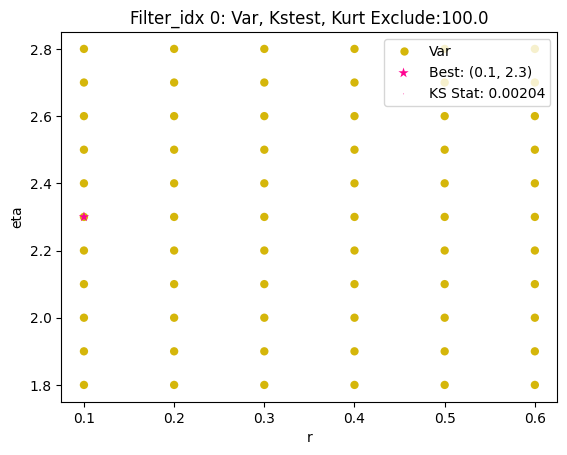

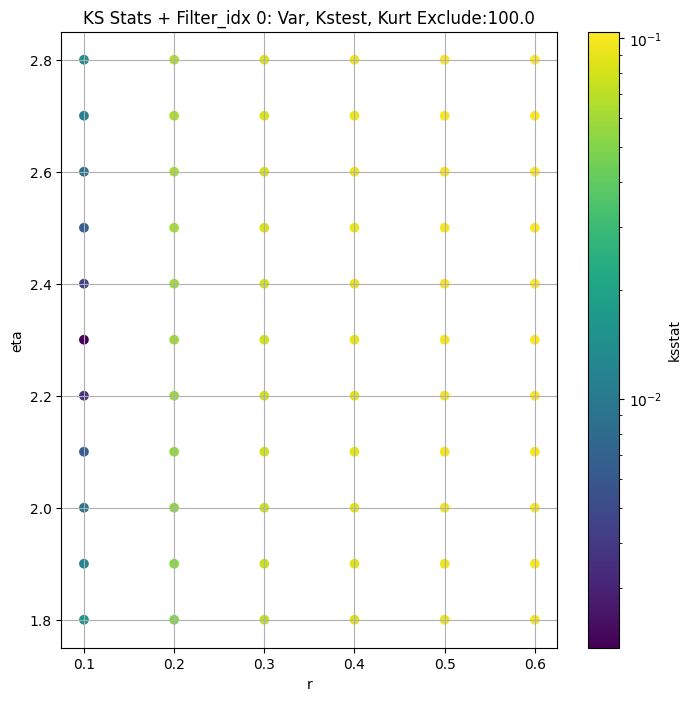

####
Filter_idx  2


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 0 0.019989911092417434 160.71613385273787


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 50 0.005036013717029331 84.11893917173289


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 100 0.0019009635628678412 72.28664733080382


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 200 0.0033992683128645056 62.183615188304465
Number of samples: 100000, Without approximation : 786432000.0


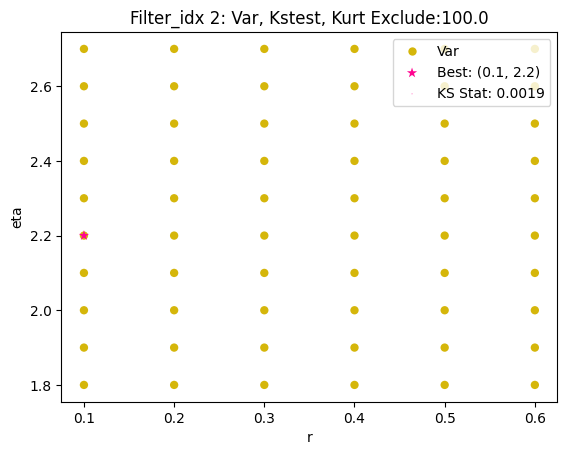

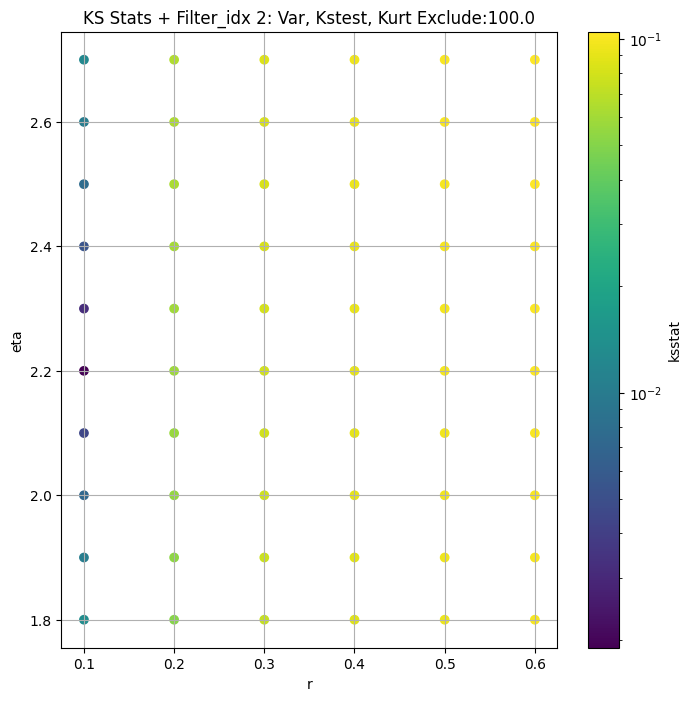

####
Filter_idx  3


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 0 0.027604091041098955 59.28834282217666


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 50 0.014450623264779305 29.144886296791146


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 100 0.0104810616317208 24.815208381334674


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 200 0.006503907607347481 20.318824867127162
Number of samples: 100000, Without approximation : 786432000.0


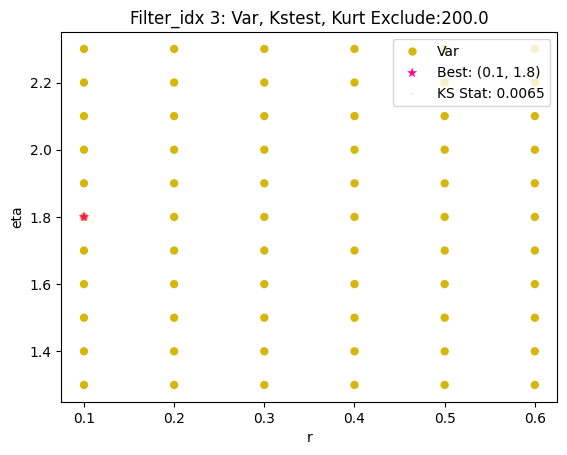

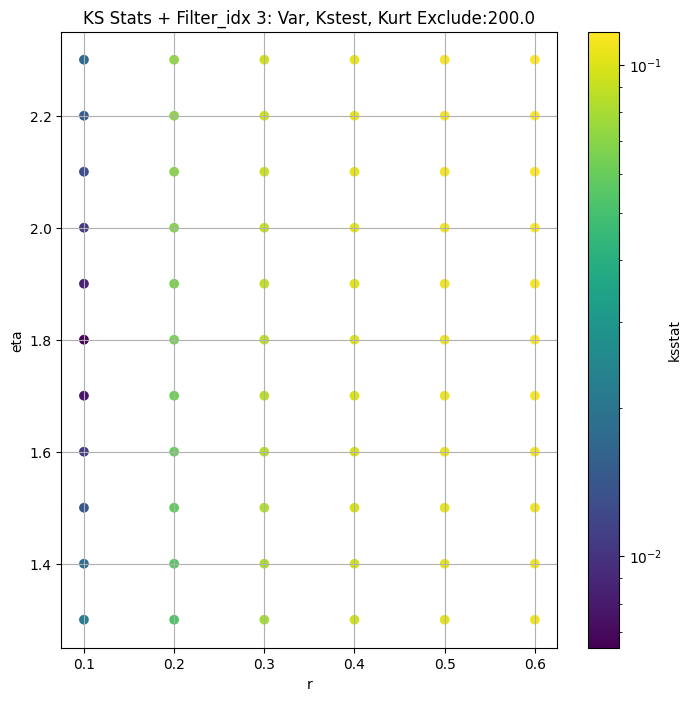

####
Filter_idx  4


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 0 0.018588332984909584 151.1609310936303


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 50 0.002558557252124505 75.4246131986221


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 100 0.0023764888363403958 65.54820189702058


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 200 0.003983972963079396 56.79373496779701
Number of samples: 100000, Without approximation : 786432000.0


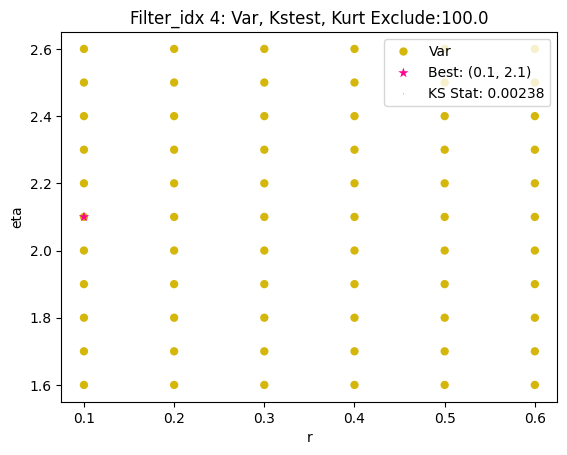

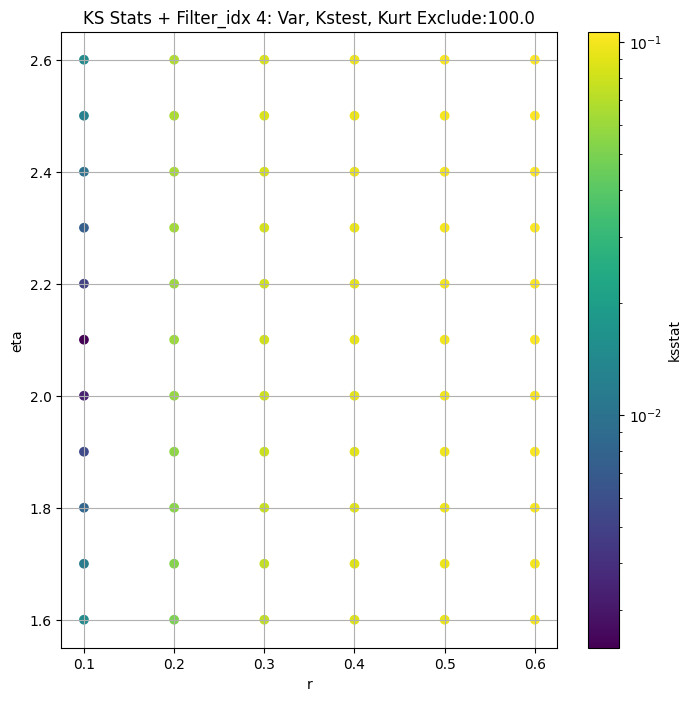

####
Filter_idx  5


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 0 0.023916780829156936 60.71931629055921


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 50 0.00729720716091109 28.0173572513147


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 100 0.005131888420917052 24.027980736958042


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 200 0.005097893414877264 20.41904540936176
Number of samples: 100000, Without approximation : 786432000.0


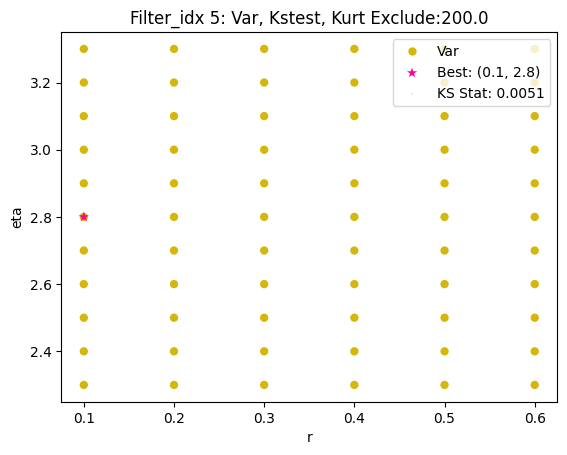

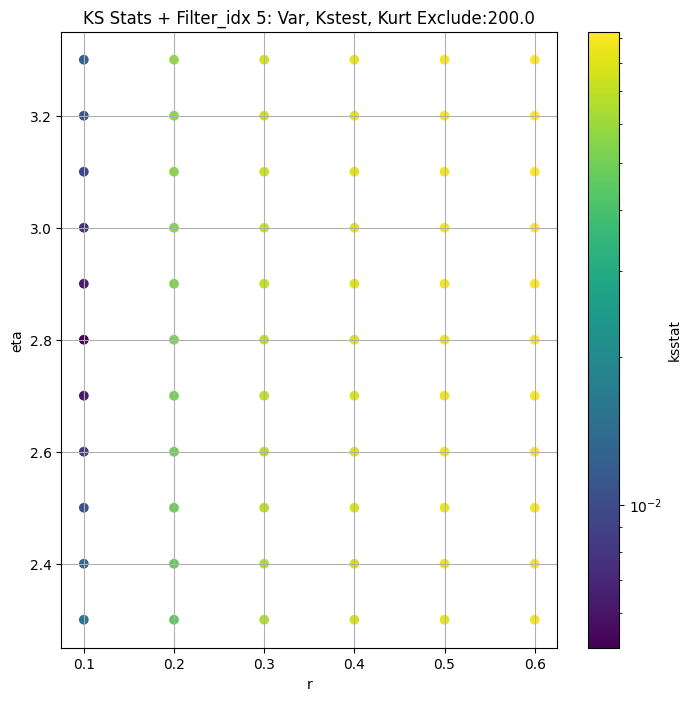

####
Filter_idx  6


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 0 0.02302972894535038 53.3705207237708


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 50 0.007226602005837024 25.353849072437114


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 100 0.004148131953410794 22.006336296281024


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 200 0.0039465569921342085 19.117563429942496
Number of samples: 100000, Without approximation : 786432000.0


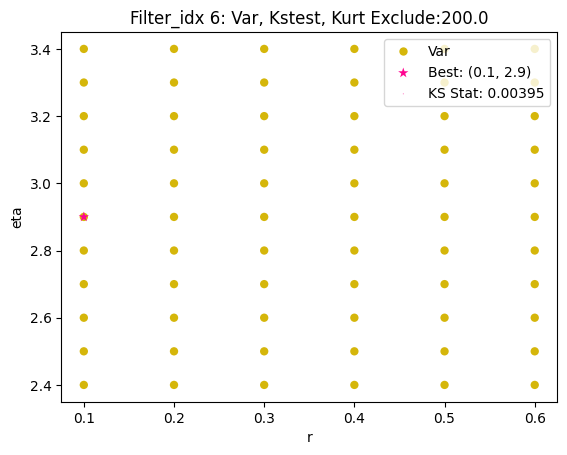

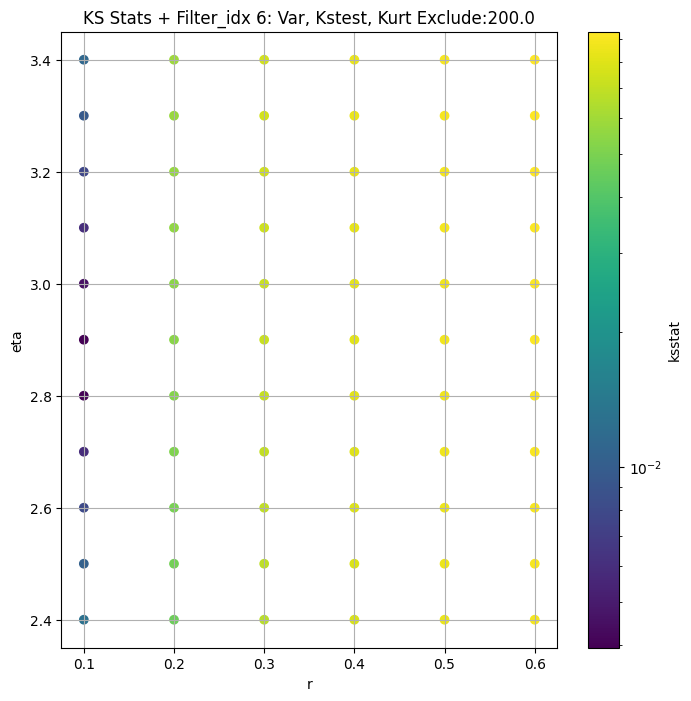

####
Filter_idx  7


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 0 0.03291721298506252 75.99259855308193


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 50 0.019287827718919848 41.357003917731625


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 100 0.016450530568321853 34.630676684402154


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 200 0.016454519195089612 28.993049026402396
Number of samples: 100000, Without approximation : 786432000.0


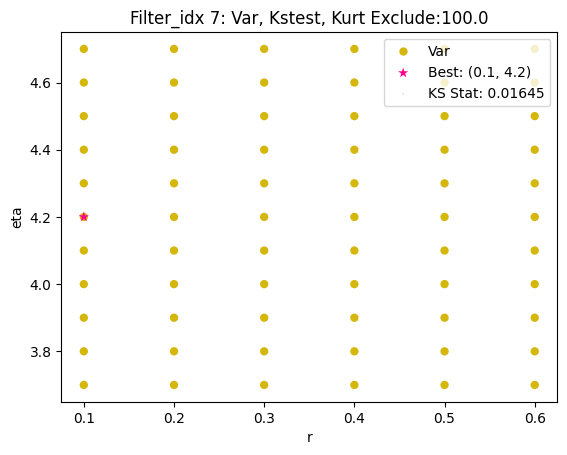

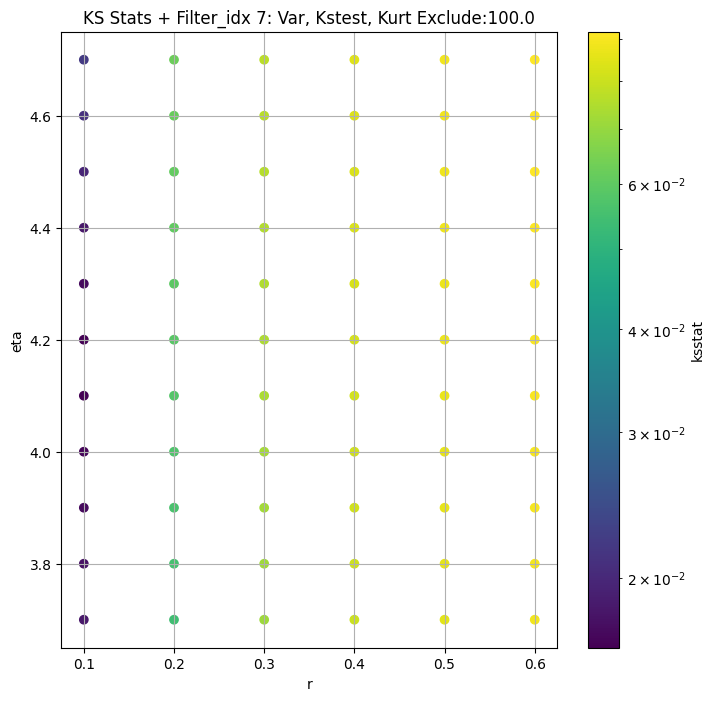

####
Filter_idx  8


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 0 0.04515475455710789 2.395724817489574


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 50 0.025739922009093252 0.8499077773104232


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 100 0.02262148191635127 0.7276147233432069


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 200 0.021073441637194157 0.6209907247602326
Number of samples: 100000, Without approximation : 786432000.0


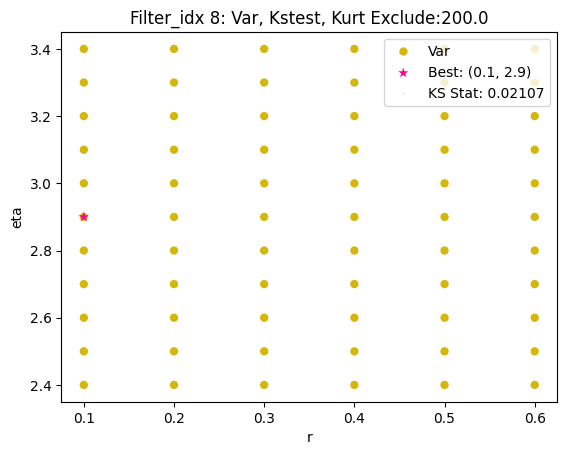

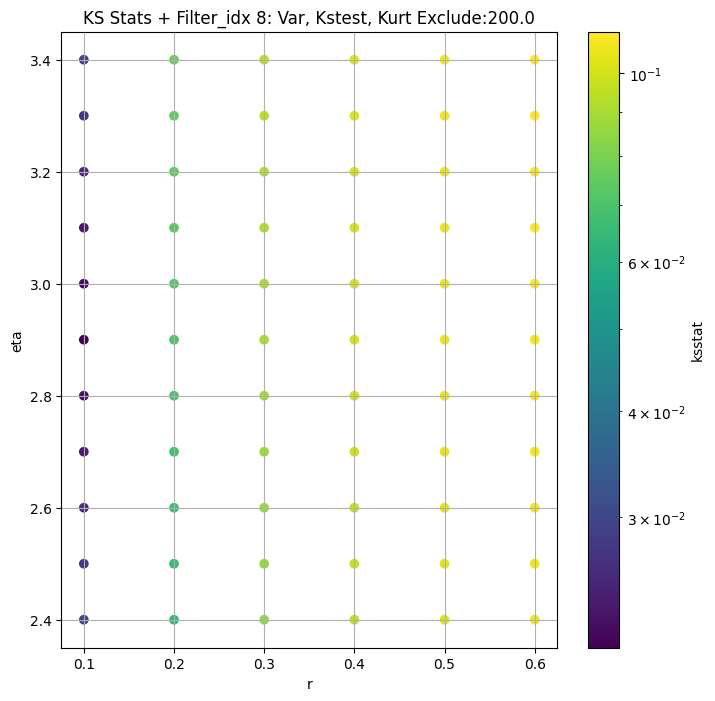

####
Filter_idx  9


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 0 0.033039461127583825 21.424416221165092


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 50 0.019744108592931298 6.19492415865034


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 100 0.014986993862455944 5.23413641776279


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 200 0.014014619140834461 4.3700432919530146
Number of samples: 100000, Without approximation : 786432000.0


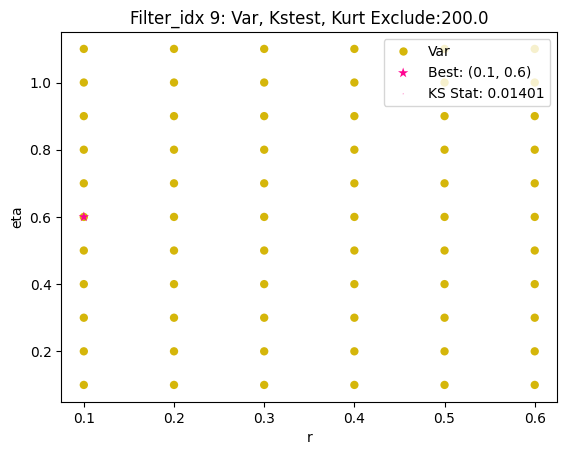

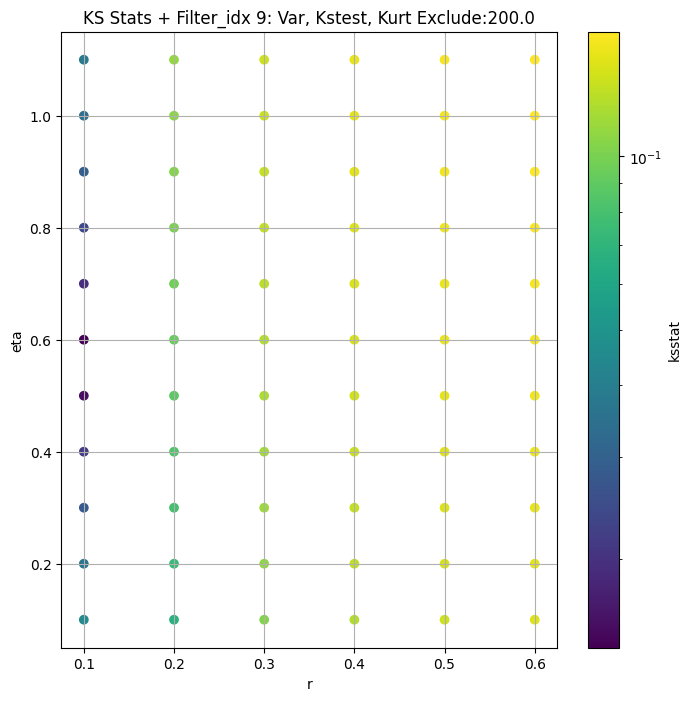

####
Filter_idx  10


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 0 0.023424941960959345 53.693168761016786


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 50 0.009237189617240127 26.986882640827368


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 100 0.006762888147366697 23.649530837765166


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 200 0.004821628559167734 20.493682752755877
Number of samples: 100000, Without approximation : 786432000.0


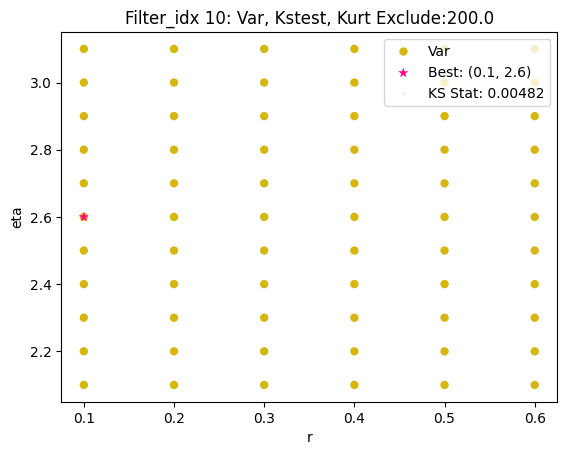

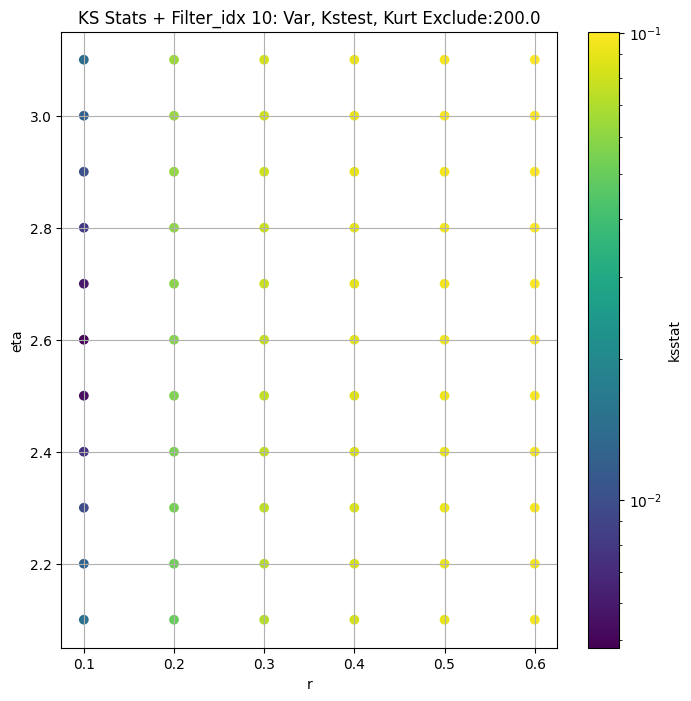

####
Filter_idx  11


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 0 0.02225241088080737 53.67341820575869


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 50 0.005467044975058677 24.75181737625767


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 100 0.0036304211385079777 21.497739434390102


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 200 0.0048486814746508955 18.641015521750987
Number of samples: 100000, Without approximation : 786432000.0


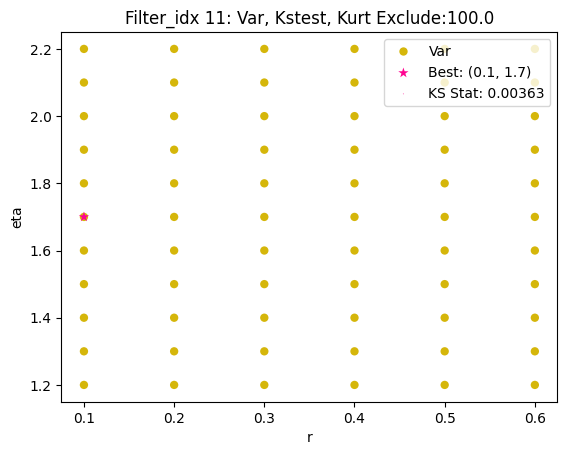

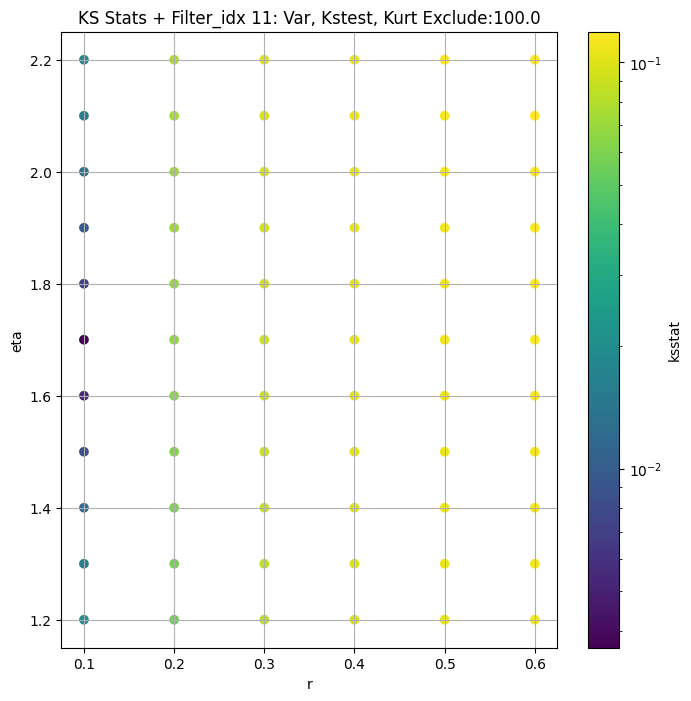

####
Filter_idx  12


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 0 0.02684186080335116 43.939313147650395


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 50 0.012335212137729812 21.195483139261285


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 100 0.010251062814155498 18.57782441250133


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 200 0.007353123963818486 16.110176850394517
Number of samples: 100000, Without approximation : 786432000.0


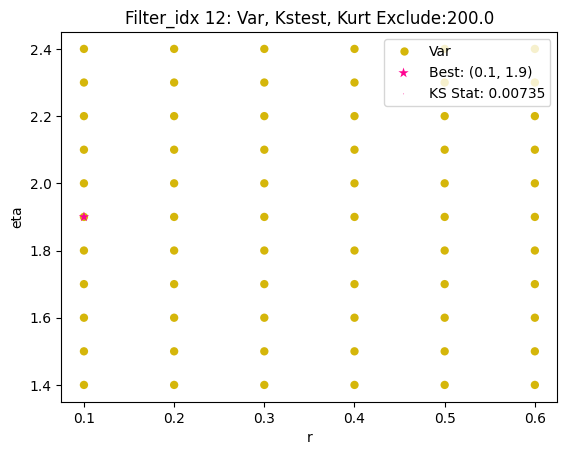

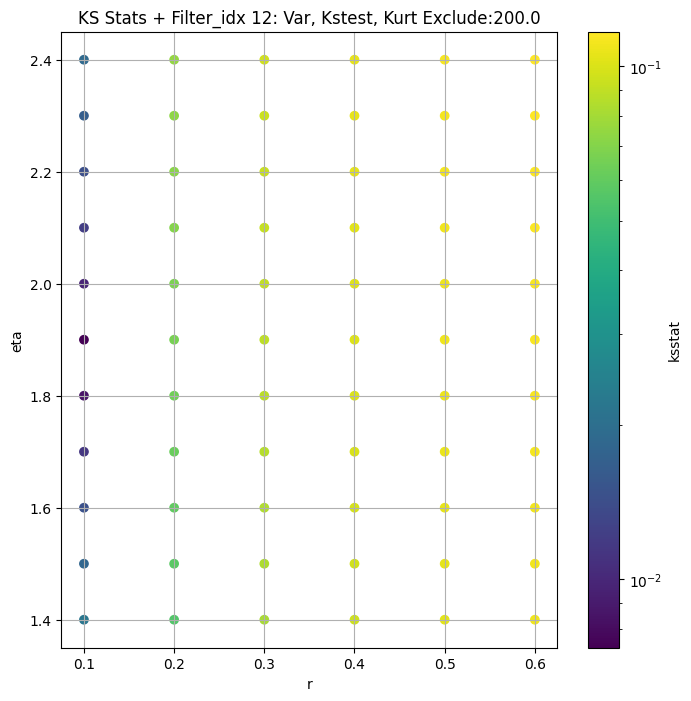

####
Filter_idx  13


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 0 0.023280308439312725 57.709281150983905


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 50 0.01084382022370467 31.342646740287574


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 100 0.008291811747857203 27.032433487537677


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 200 0.004291653859625044 22.722854198389527
Number of samples: 100000, Without approximation : 786432000.0


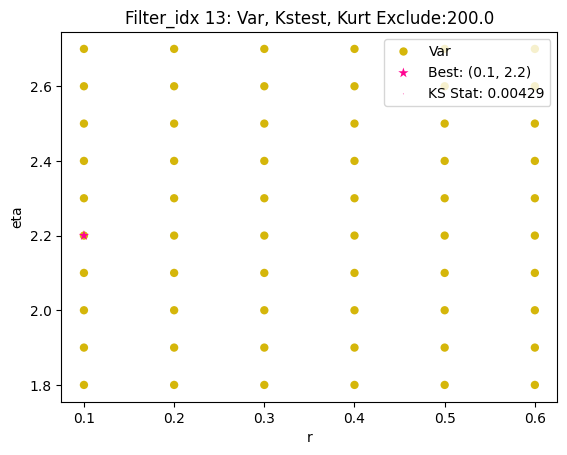

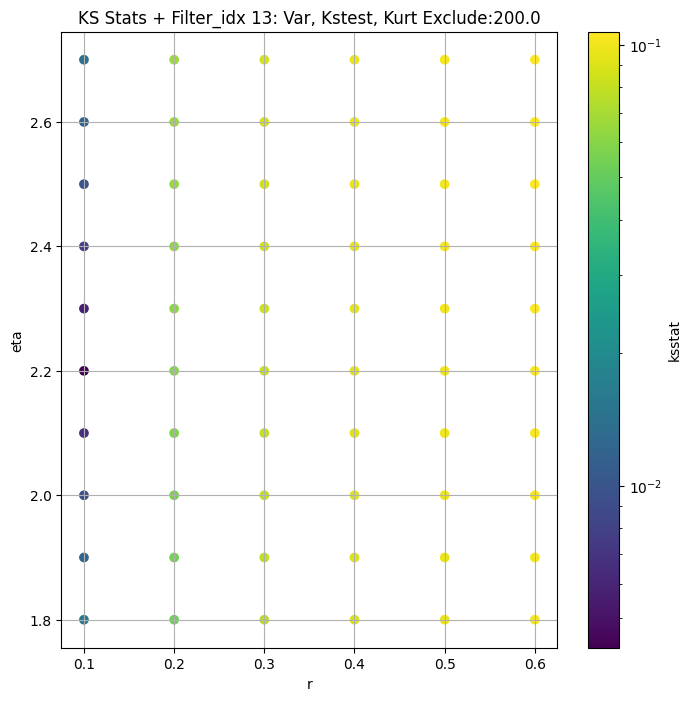

####
Filter_idx  14


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 0 0.022536454803873895 73.47427934380991


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 50 0.007095213041453552 36.6238820171314


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 100 0.005231420294774025 32.24016532927623


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 200 0.00483346735775364 27.90174399924602
Number of samples: 100000, Without approximation : 786432000.0


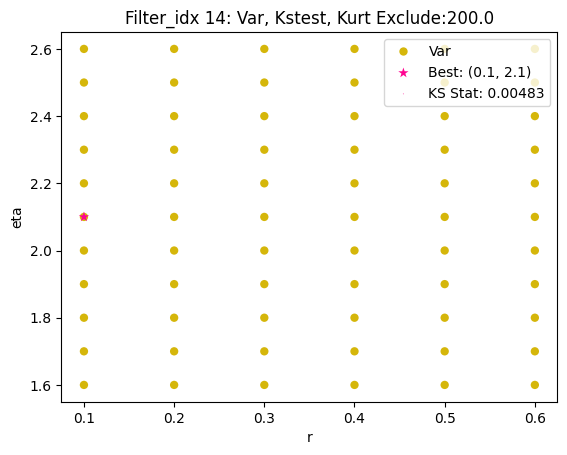

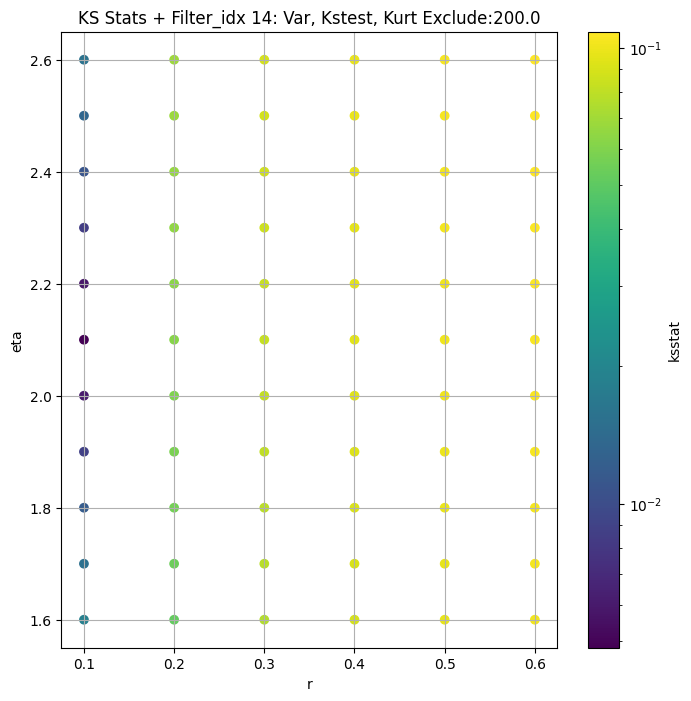

####
Filter_idx  15


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 0 0.03357346257999705 66.75872122694125


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 50 0.018066994449773333 35.73818552612748


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 100 0.013769005724423078 30.76009367585572


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 200 0.009634238028011666 26.450519839269703
Number of samples: 100000, Without approximation : 786432000.0


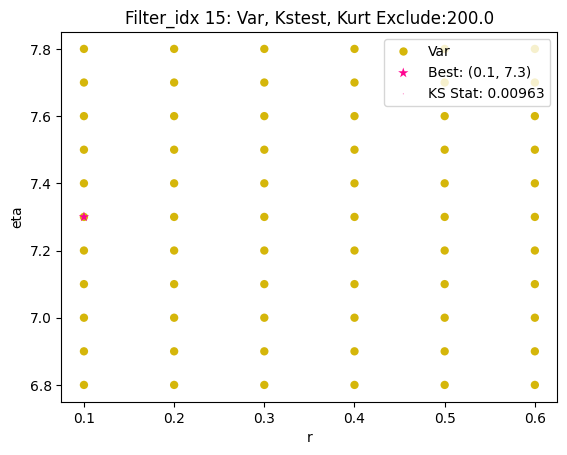

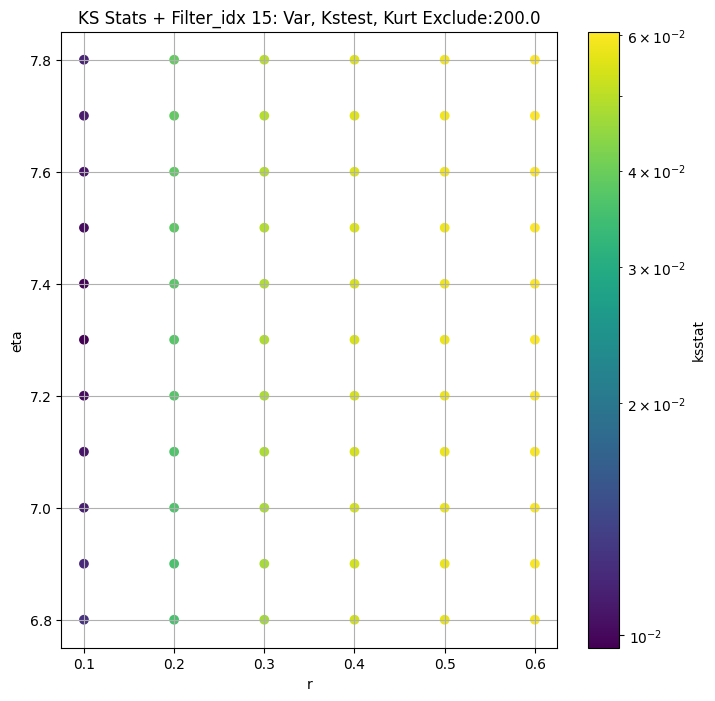

####
Filter_idx  16


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 0 0.02787598107981641 39.96663611792678


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 50 0.013434020793419349 18.799942439275654


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 100 0.010159583966626431 16.574839813887863


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 200 0.00712181477033369 14.297907458236338
Number of samples: 100000, Without approximation : 786432000.0


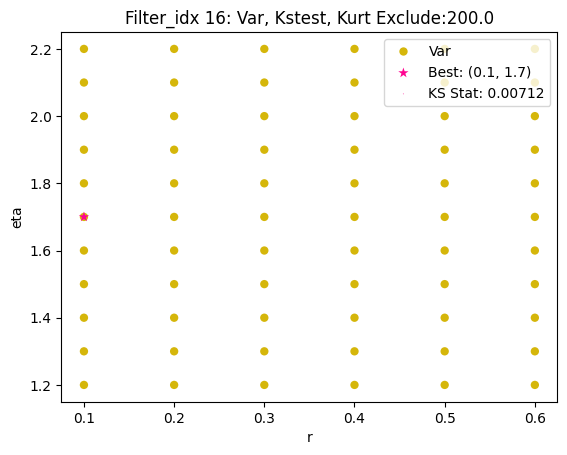

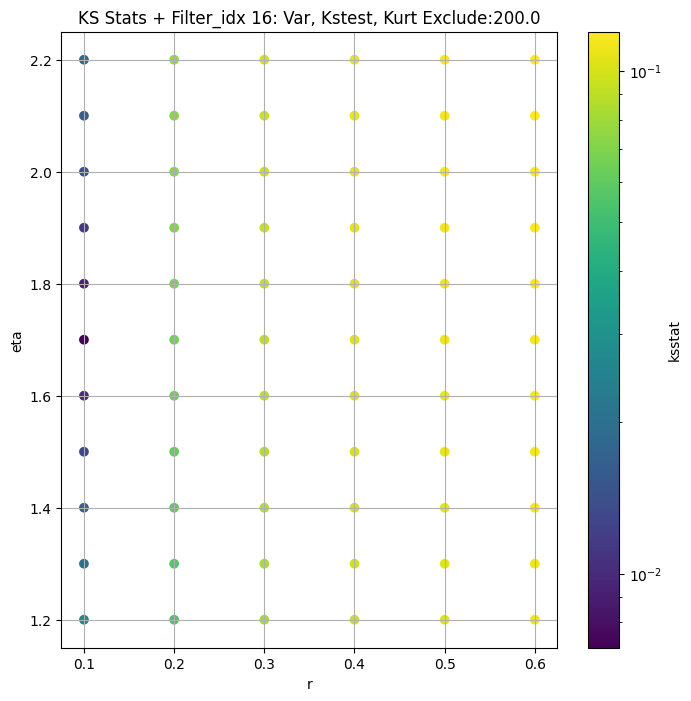

####
Filter_idx  17


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 0 0.019451808552564454 57.8736243530338


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 50 0.00263801929965235 23.020868371333073


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 100 0.004415263629739319 19.712127847432086


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 200 0.003953365441897394 16.85905961528033
Number of samples: 100000, Without approximation : 786432000.0


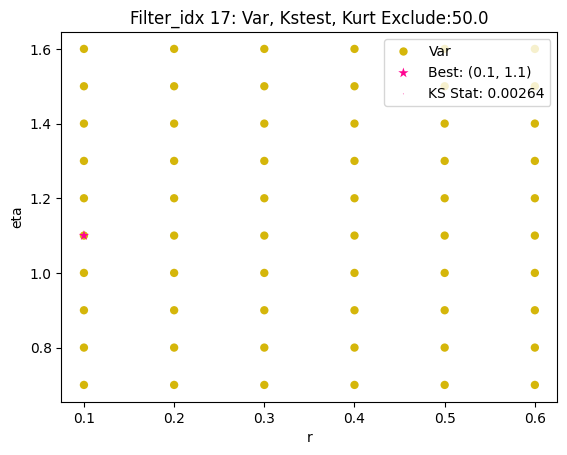

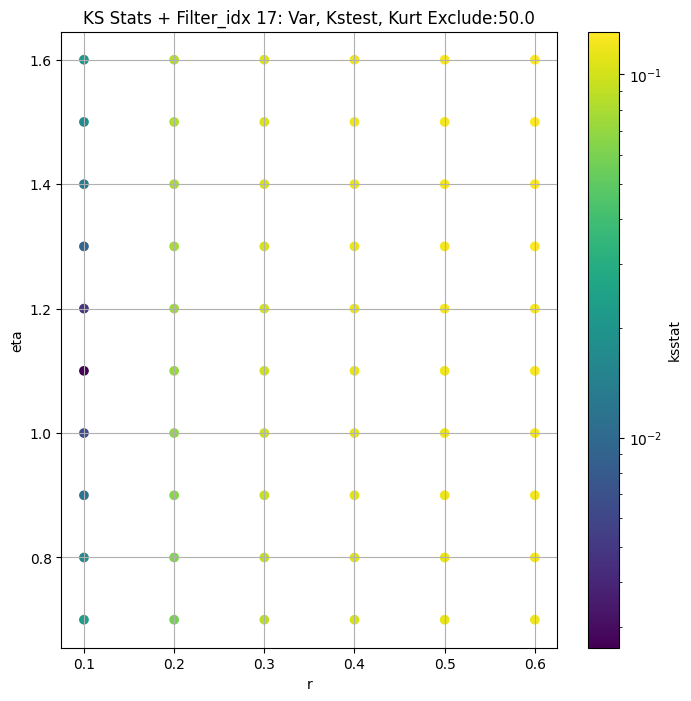

####
Filter_idx  18


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 0 0.02585080403380513 30.792823619111154


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 50 0.01435743366988912 15.033348406984933


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 100 0.011714941811561908 13.277919494351762


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 200 0.00906048918824398 11.511939327853758
Number of samples: 100000, Without approximation : 786432000.0


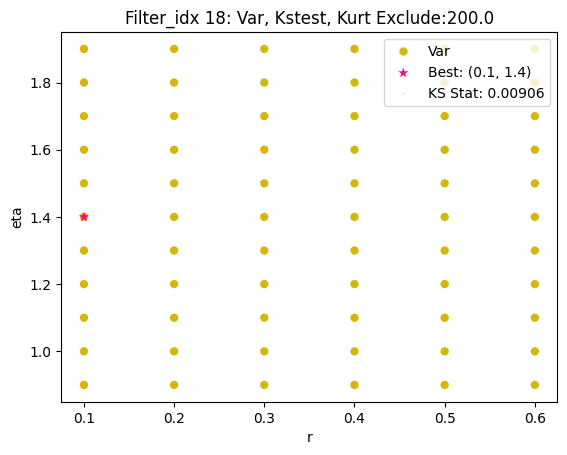

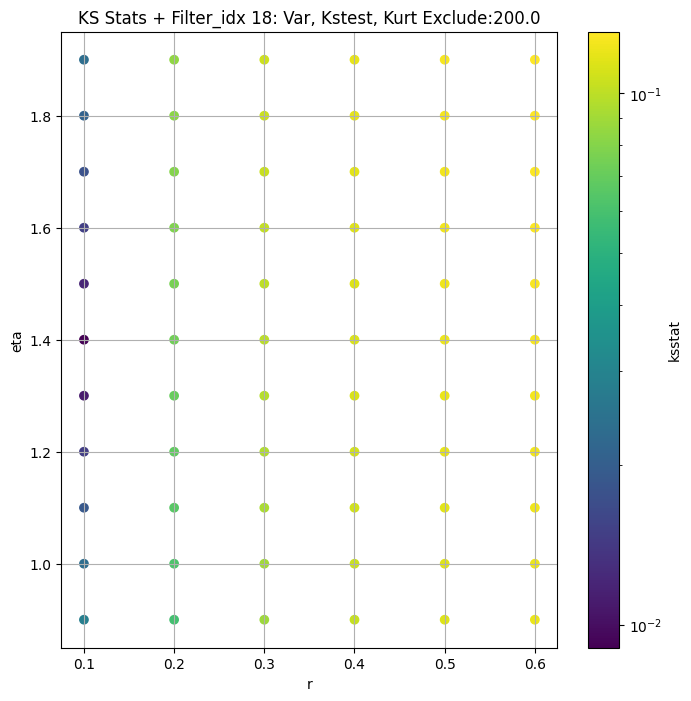

####
Filter_idx  19


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 0 0.029682914685127695 135.47787975882832


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 50 0.017164053434671755 76.16711197110538


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 100 0.015869657423763117 65.83664960552773


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 200 0.015614264293850488 56.08460570867921
Number of samples: 100000, Without approximation : 786432000.0


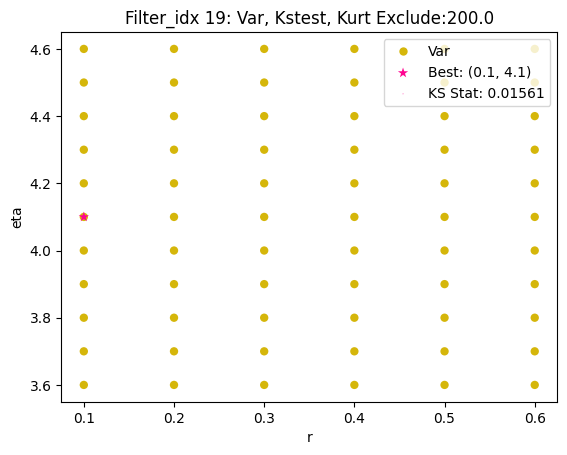

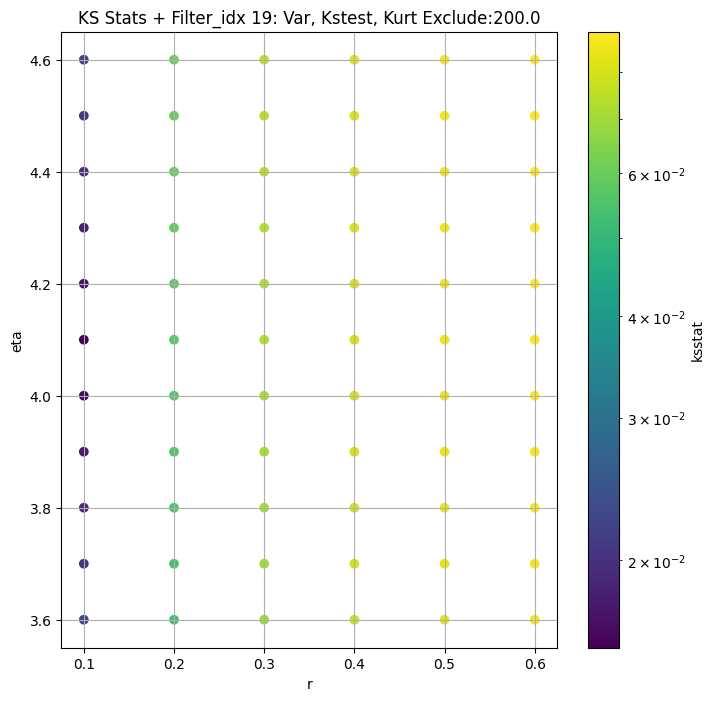

####
Filter_idx  20


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 0 0.021300225724968813 213.1505859531162


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 50 0.008353930986780389 114.7183583192069


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 100 0.004916666116563162 98.7296074365915


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 200 0.0033659110892825406 83.95780361661674
Number of samples: 100000, Without approximation : 786432000.0


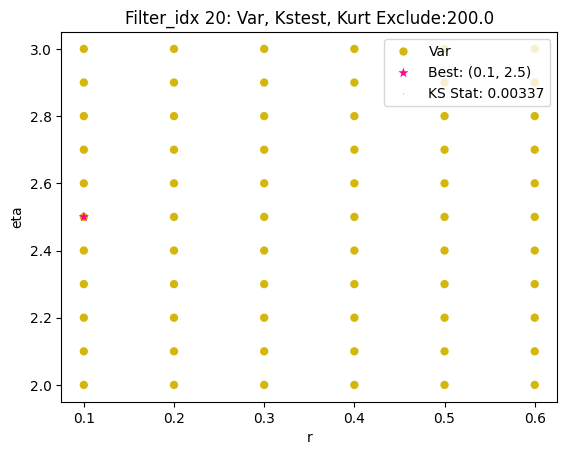

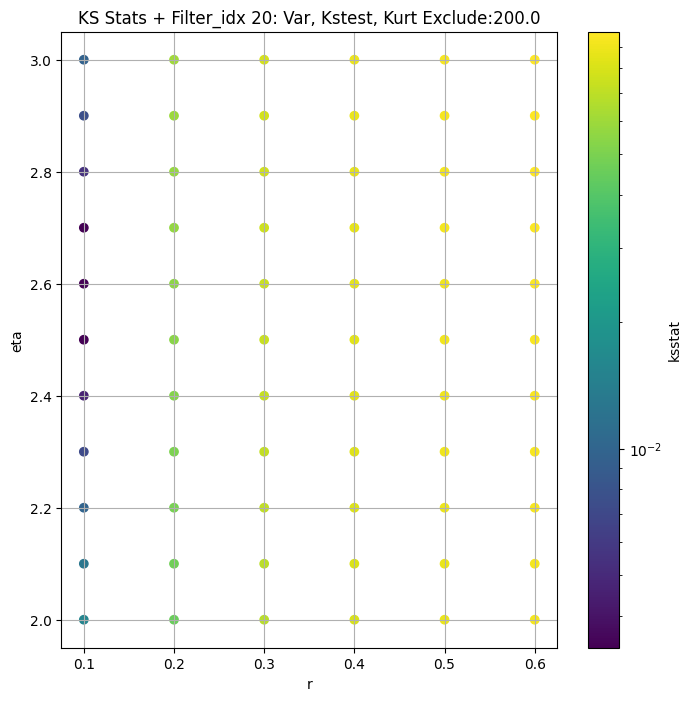

####
Filter_idx  21


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 0 0.03923379595307752 362.9707597892393


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 50 0.030738998559455 200.75773894459692


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 100 0.03072714065048604 172.30869204313527


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 200 0.030722914769347742 146.92050825141536
Number of samples: 100000, Without approximation : 786432000.0


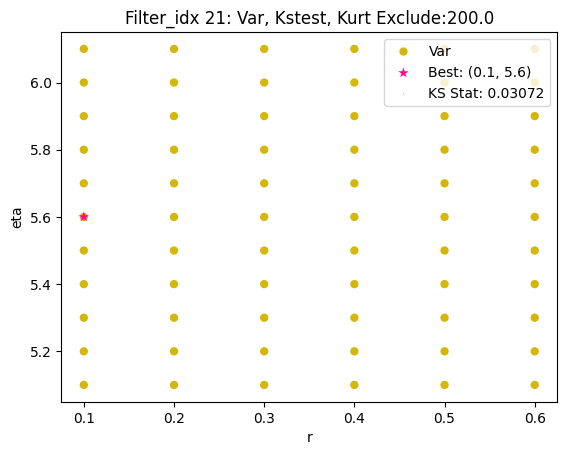

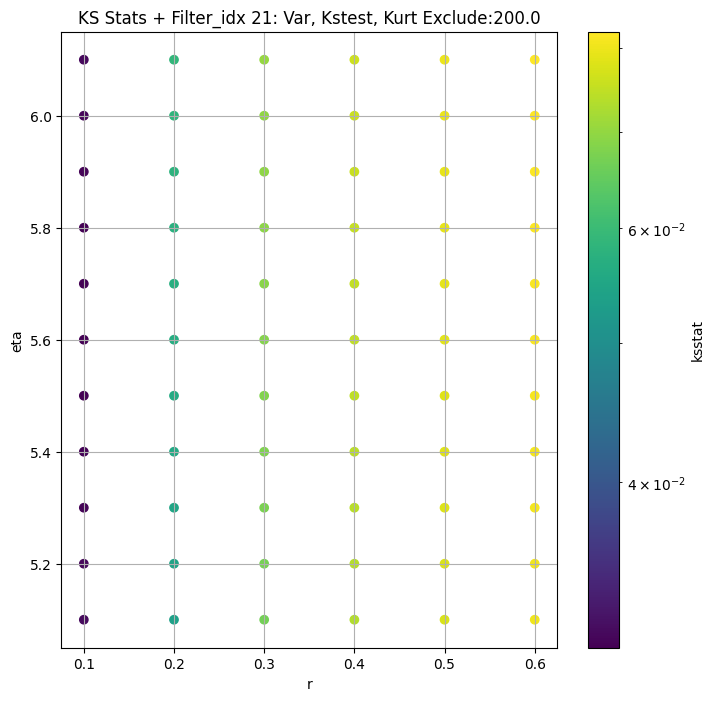

####
Filter_idx  22


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 0 0.02650061068689402 54.830565698114874


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 50 0.013879994406472043 29.280347228855085


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 100 0.010145865628177708 24.293058560690984


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 200 0.006573070522564173 19.480548533840793
Number of samples: 100000, Without approximation : 786432000.0


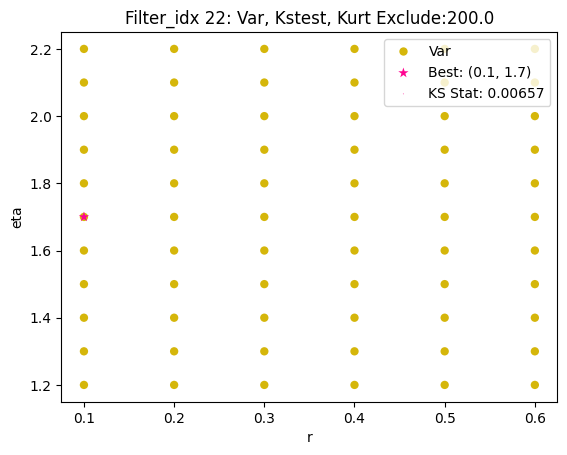

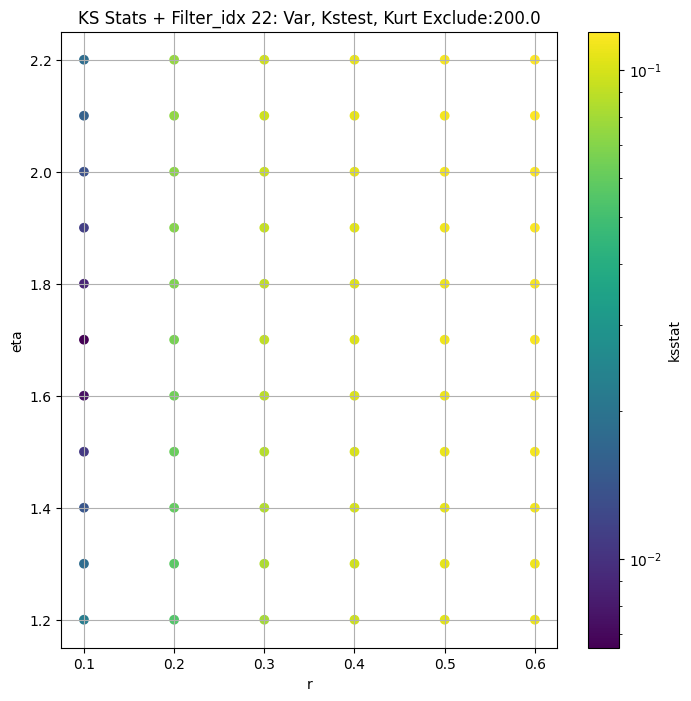

####
Filter_idx  23


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 0 0.025262045075819917 116.54536153905545


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 50 0.009150439735090998 43.57783143488504


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 100 0.006045181247068876 35.16867194070638


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 200 0.005740921491043216 29.56688017422593
Number of samples: 100000, Without approximation : 786432000.0


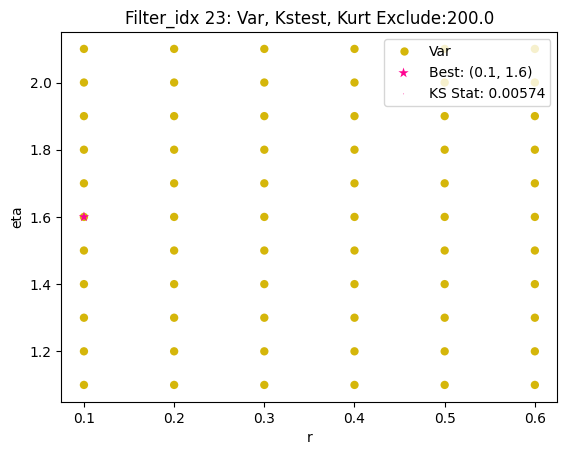

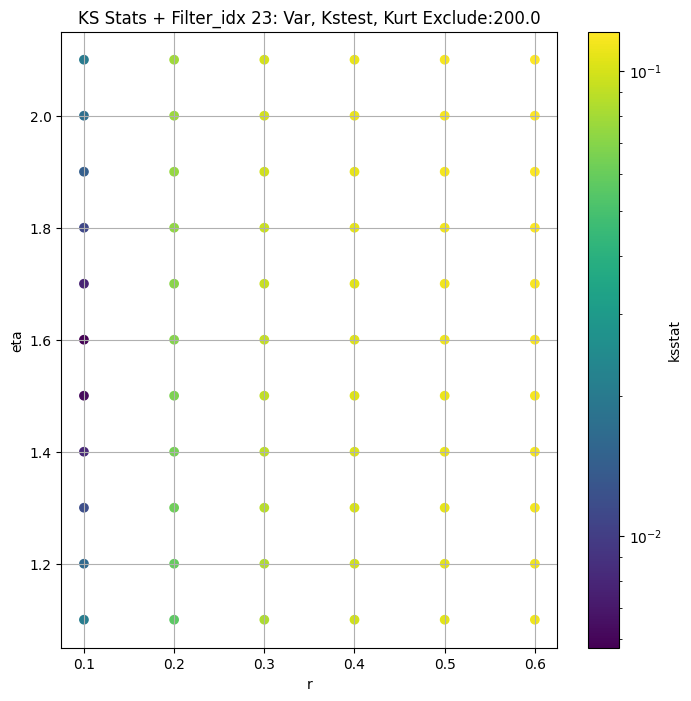

####
Filter_idx  24


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 0 0.03373997592587151 76.27278572069628


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 50 0.018015723464347128 31.384655642619112


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 100 0.014511166014677057 25.626395828560433


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 200 0.011967882735945234 20.611231289646003
Number of samples: 100000, Without approximation : 786432000.0


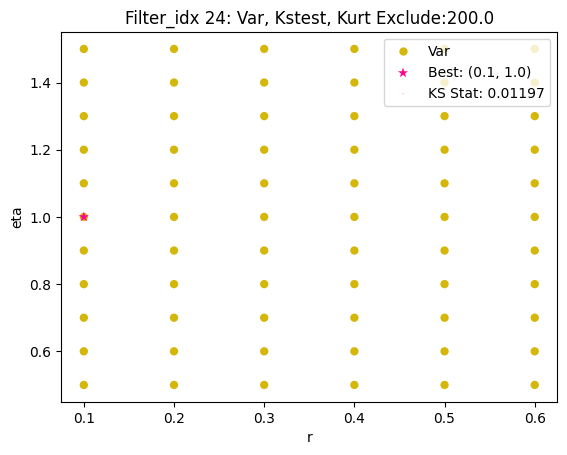

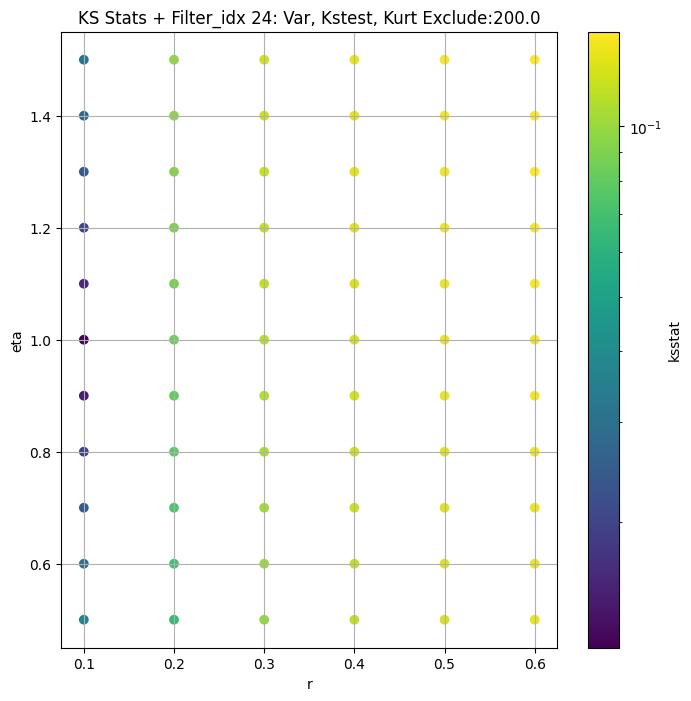

####
Filter_idx  25


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 0 0.03383449417780382 25.733448337525335


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 50 0.01622624112648441 9.527000354977856


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 100 0.014375413111975988 8.046451450273349


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 200 0.0090941949100245 6.4641386254829305
Number of samples: 100000, Without approximation : 786432000.0


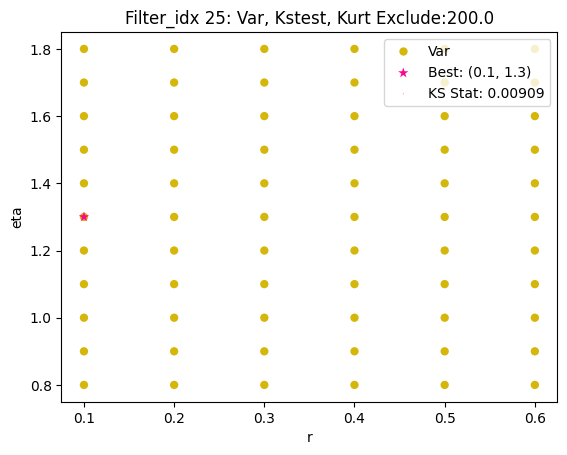

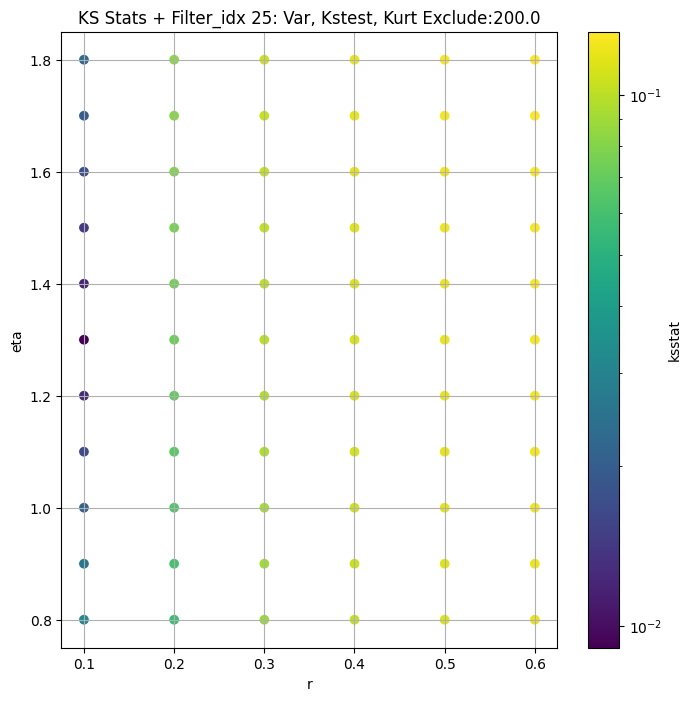

####
Filter_idx  26


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 0 0.02461962556583608 48.59658404214989


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 50 0.007928591003547661 23.463038273577368


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 100 0.005533242345194256 20.31105177870647


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 200 0.005630241640793288 17.59831114489898
Number of samples: 100000, Without approximation : 786432000.0


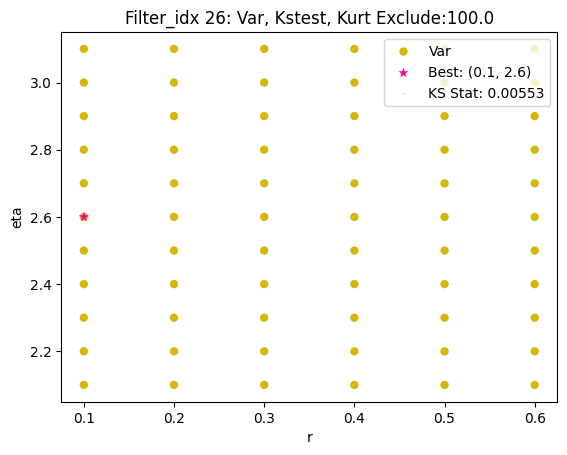

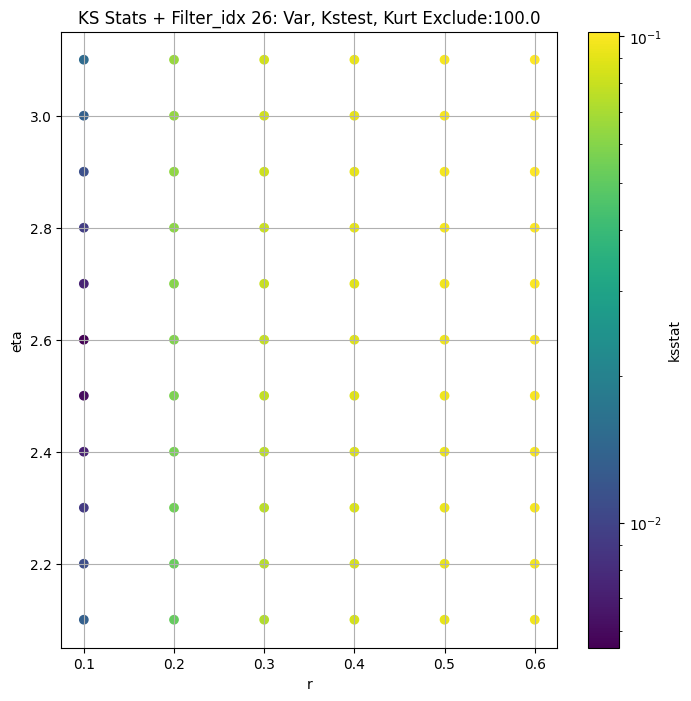

####
Filter_idx  27


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 0 0.032199767455075134 21.726803012733118


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 50 0.0199747569529114 7.224191228564936


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 100 0.01860713587852958 6.171766775541147


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 200 0.014550843499168853 5.192249953782891
Number of samples: 100000, Without approximation : 786432000.0


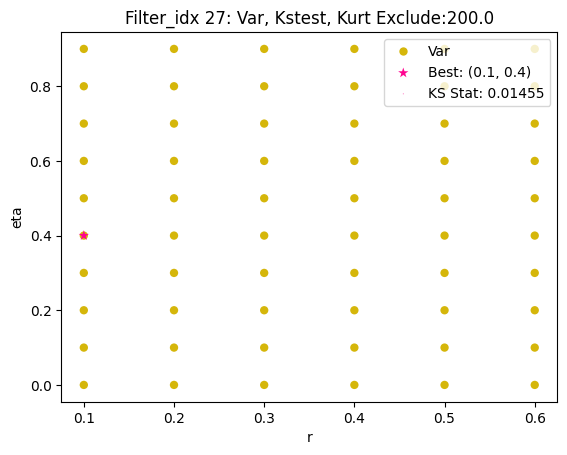

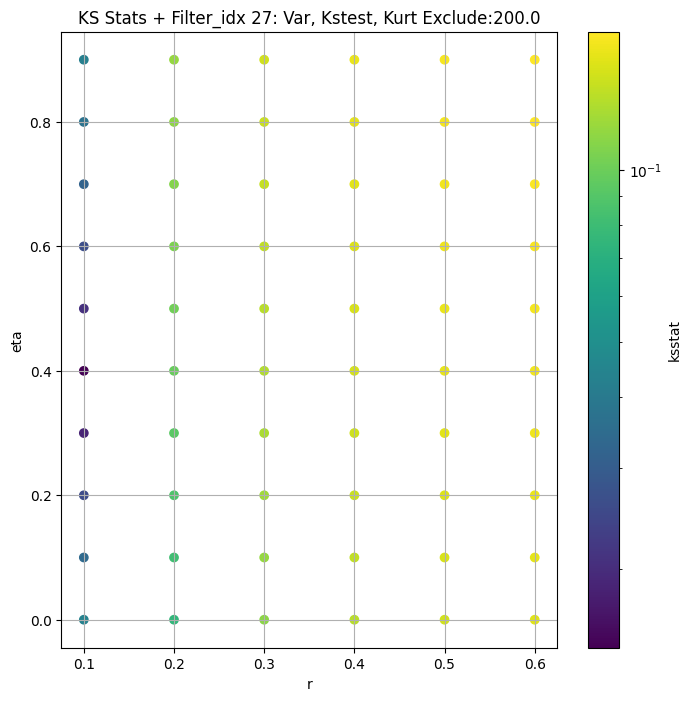

####
Filter_idx  28


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 0 0.03474741249399904 101.6833888949272


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 50 0.02044206904219631 41.62400839890786


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 100 0.015701020615053768 33.433629245679484


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 200 0.012750484478110363 26.549523094027368
Number of samples: 100000, Without approximation : 786432000.0


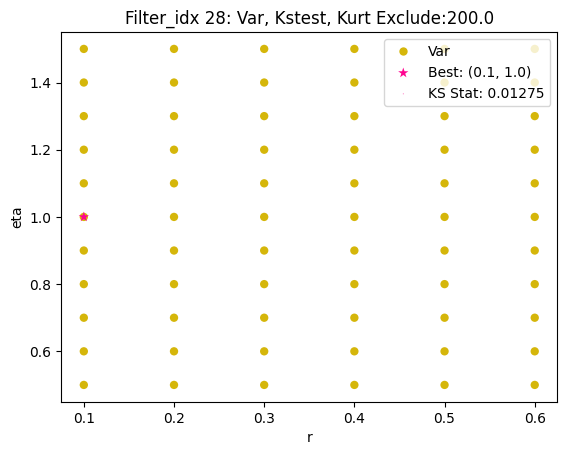

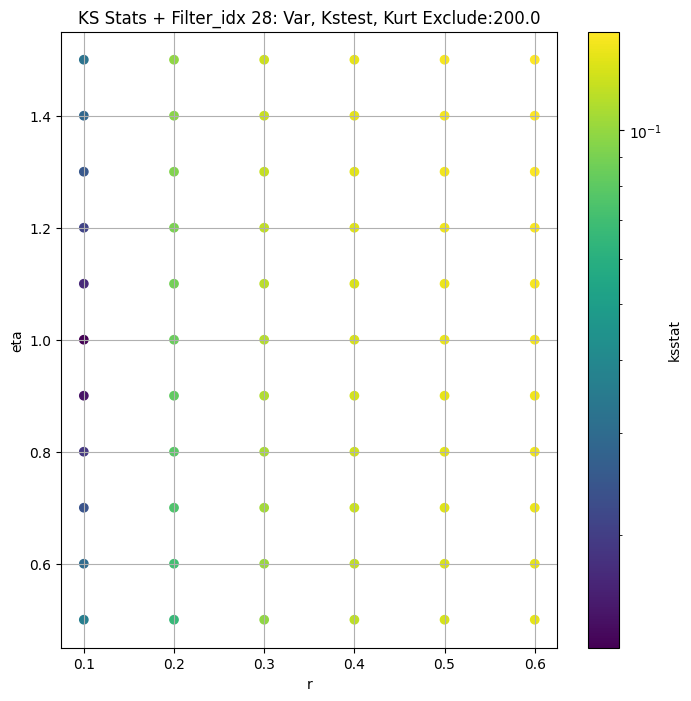

####
Filter_idx  29


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 0 0.024629375679077192 86.0651940439547


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 50 0.012491469254533372 34.1224261299899


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 100 0.010682720379086463 28.444269435048387


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 200 0.009487842899235766 24.037005065457596
Number of samples: 100000, Without approximation : 786432000.0


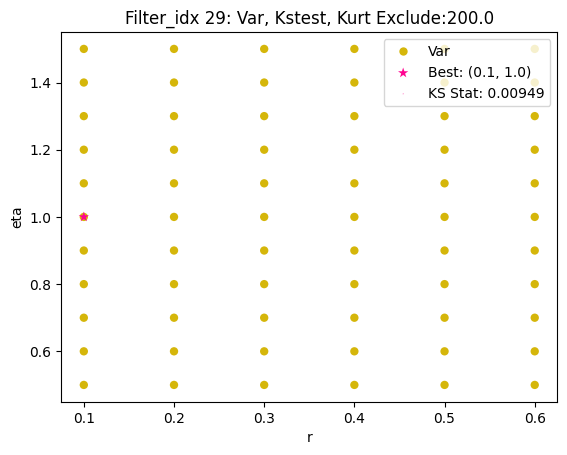

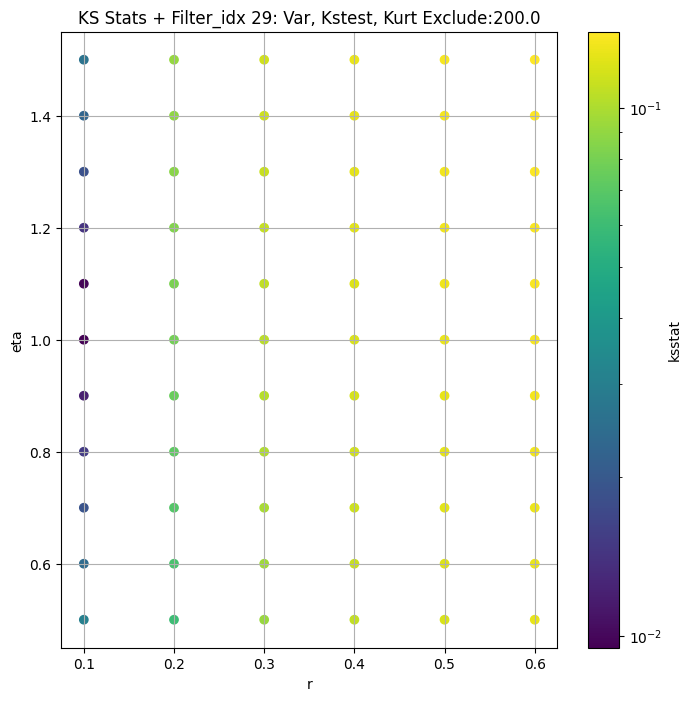

####
Filter_idx  30


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 0 0.031916391206665284 68.59156783508146


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 50 0.01745135271093462 28.749569392655832


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 100 0.014545121937020677 23.438105315285622


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 200 0.010844873164553515 18.999115808731403
Number of samples: 100000, Without approximation : 786432000.0


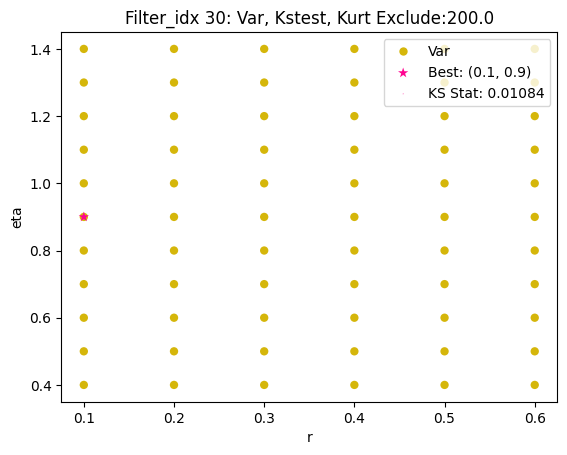

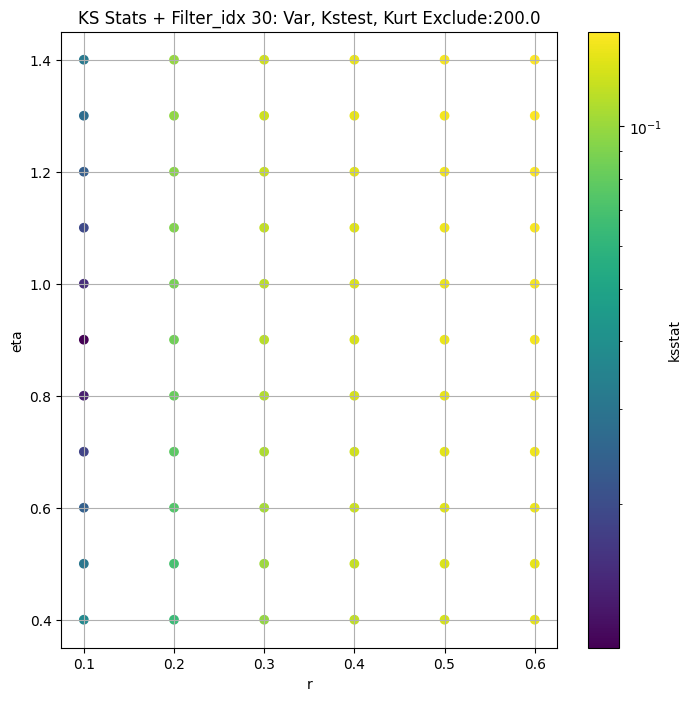

####
Filter_idx  31


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 0 0.02927768557379118 71.90181158846626


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 50 0.01886010866298954 37.94624079466153


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 100 0.01779668733440748 32.38310978564213


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 200 0.017831909408383417 27.846976968694406
Number of samples: 100000, Without approximation : 786432000.0


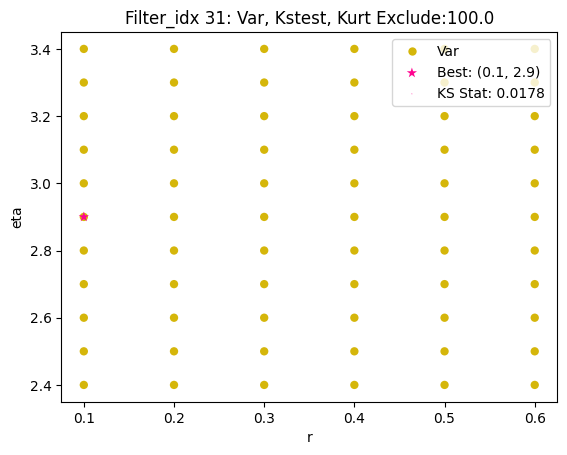

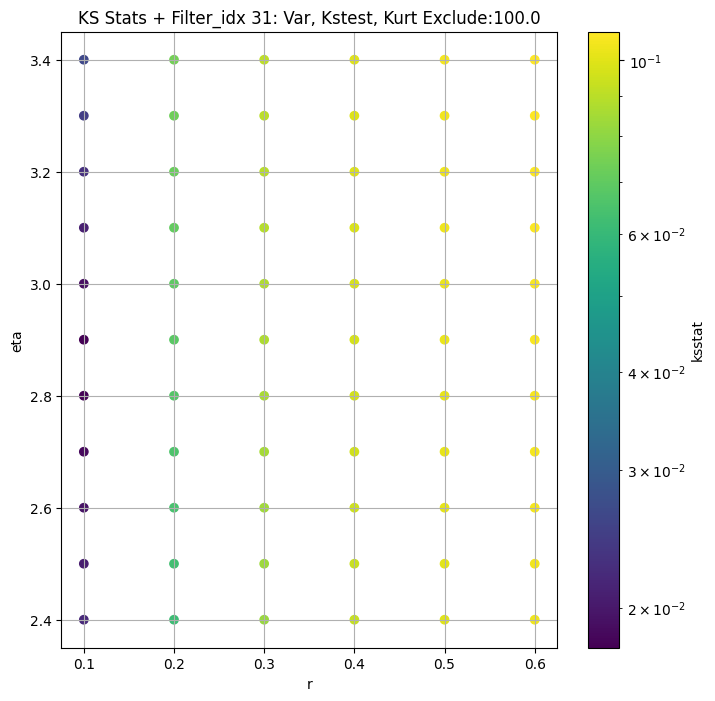

####
Filter_idx  32


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 0 0.024450116397427862 90.1116377423968


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 50 0.00832441614662005 38.172027389292715


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 100 0.005694449705263865 31.72591712705009


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 200 0.005387573699868024 27.01832800946264
Number of samples: 100000, Without approximation : 786432000.0


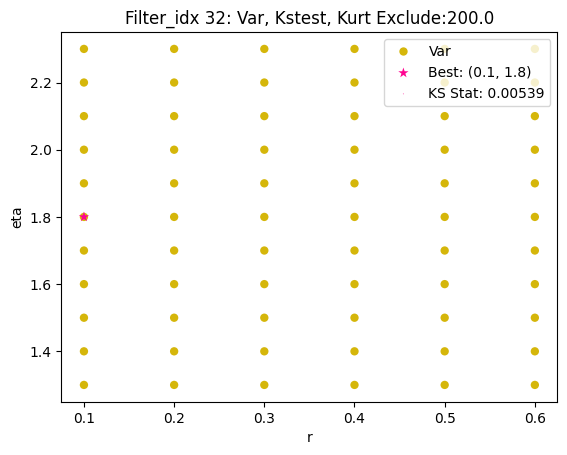

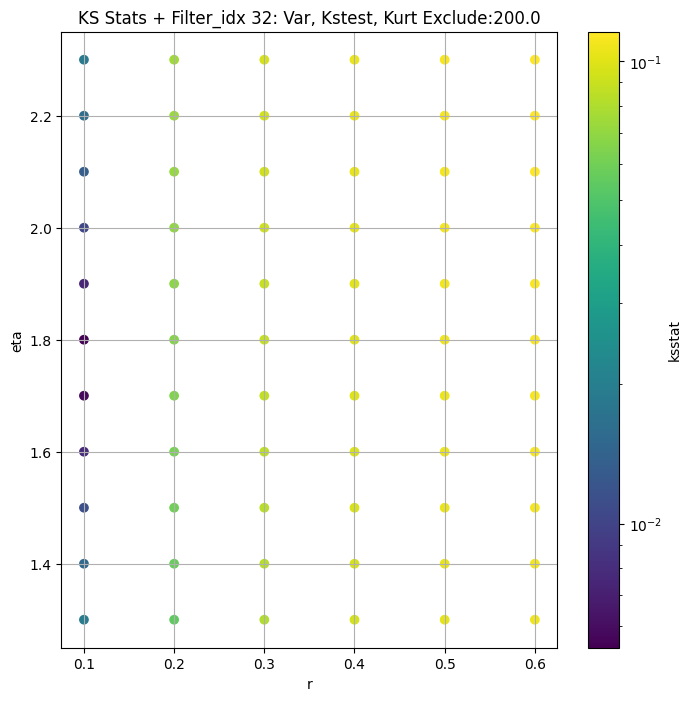

####
Filter_idx  33


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 0 0.028883338745915088 20.229951858074898


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 50 0.014489031992959284 9.185365174138767


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 100 0.012949919421815614 8.039005589300709


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 200 0.009653864866772638 6.95129366021007
Number of samples: 100000, Without approximation : 786432000.0


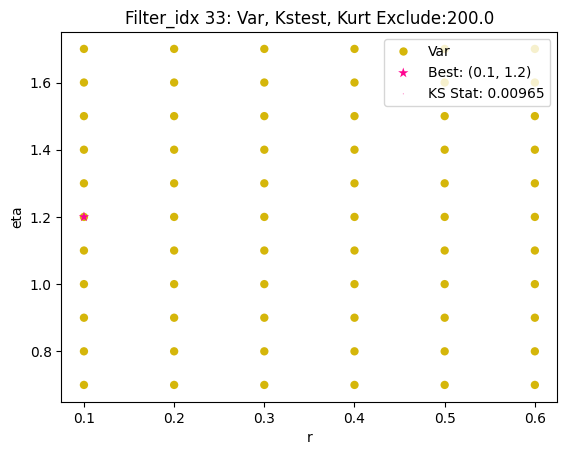

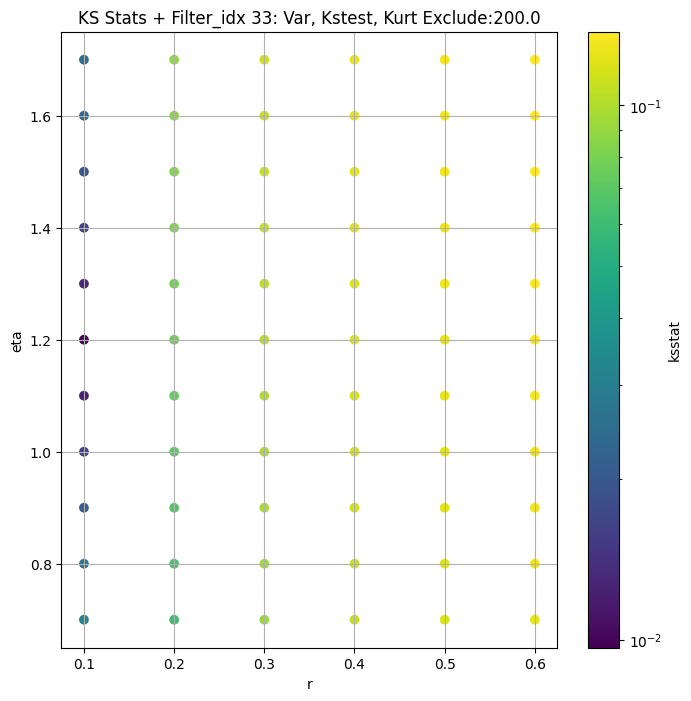

####
Filter_idx  34


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 0 0.029788775818281307 78.32334413539601


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 50 0.015614211390735377 30.228129969872036


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 100 0.013817217555118111 24.92821890862312


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 200 0.010162971037946167 20.413261244385385
Number of samples: 100000, Without approximation : 786432000.0


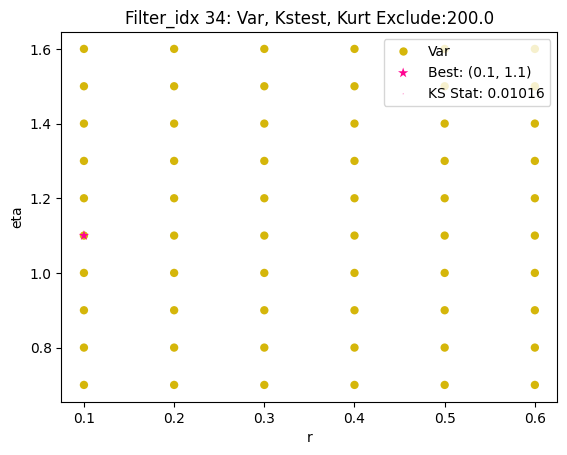

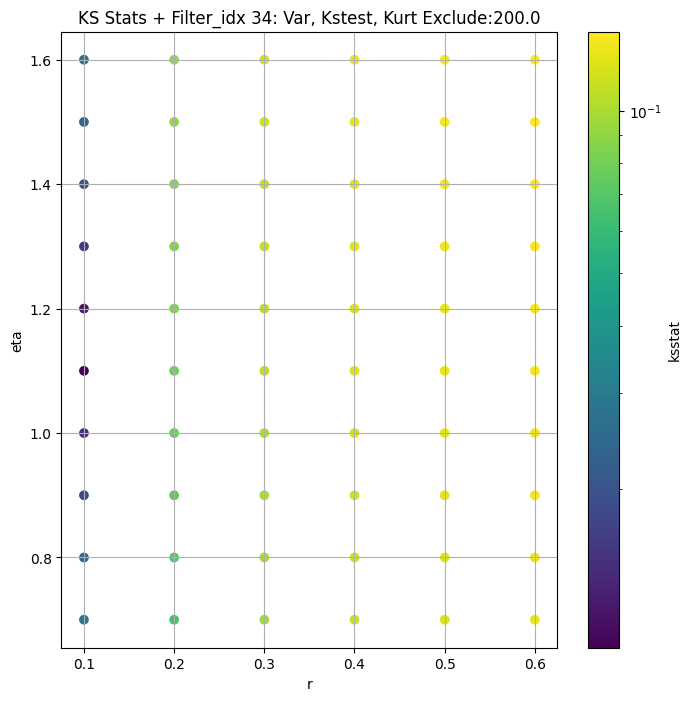

####
Filter_idx  35


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 0 0.03791851160364346 230.10197282418468


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 50 0.029930566302078965 120.01602815886166


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 100 0.02992911574976842 101.60158577346654


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 200 0.029928589520730187 86.25326034530437
Number of samples: 100000, Without approximation : 786432000.0


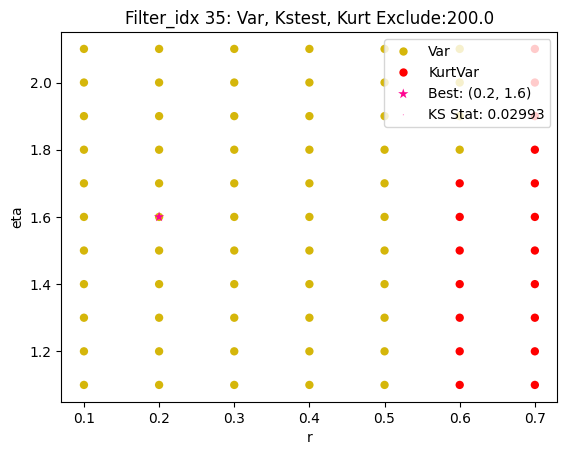

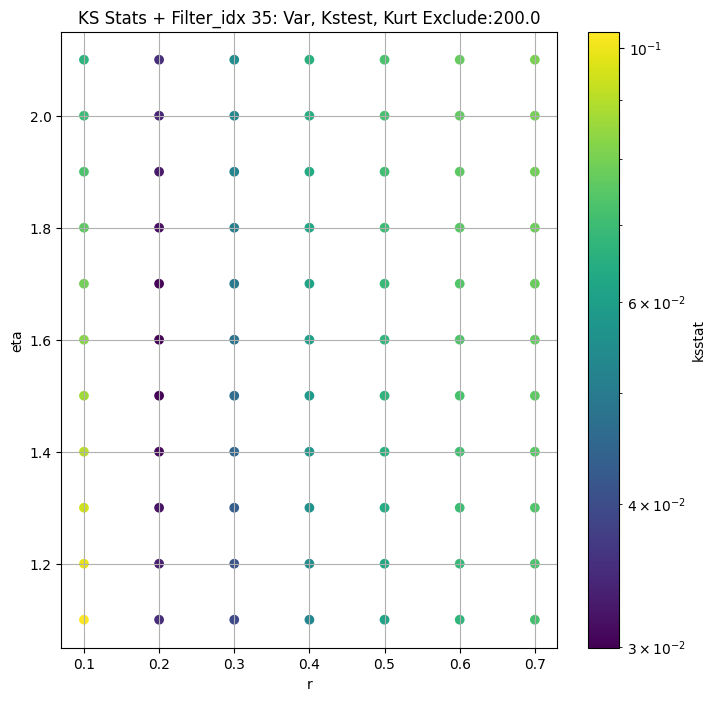

####
Filter_idx  37


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 0 0.037748518850994076 345.01553199844045


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 50 0.028808266575723107 187.7868572448685


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 100 0.028808355781639317 161.76247613449974


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 200 0.028797483198913176 138.52370799379963
Number of samples: 100000, Without approximation : 786432000.0


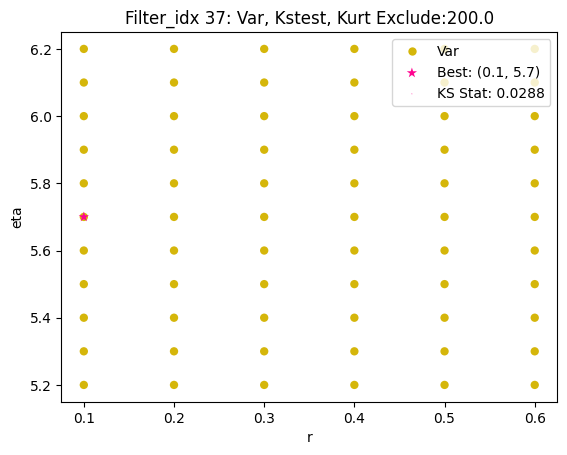

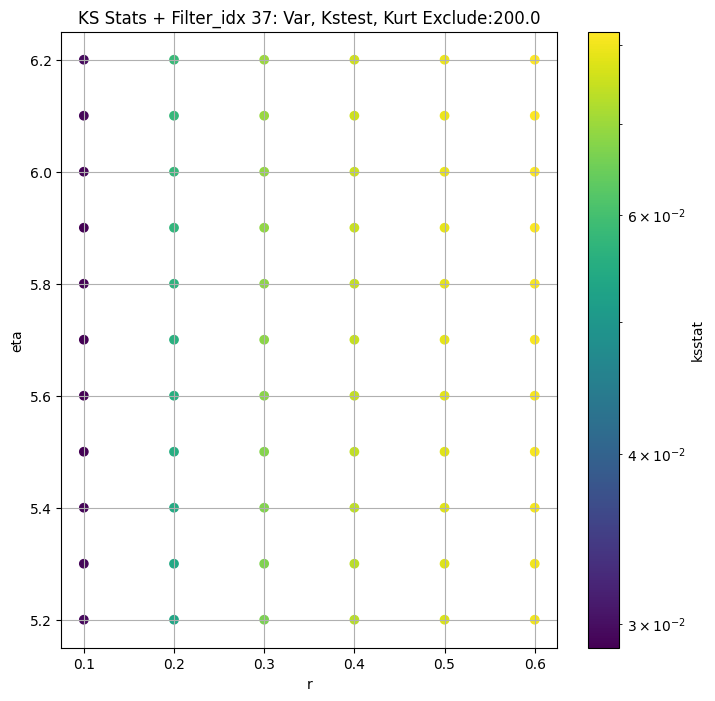

####
Filter_idx  38


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 0 0.021342098626829786 93.40590223770884


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 50 0.004413428726277813 42.83642692705092


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 100 0.002899842342394876 36.886035980279


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 200 0.0030275498515992573 31.86646730960739
Number of samples: 100000, Without approximation : 786432000.0


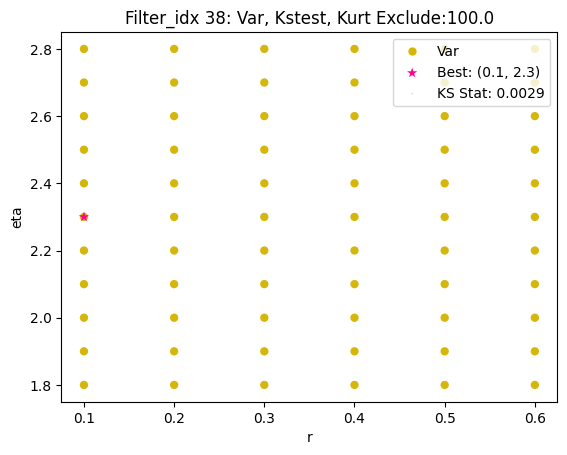

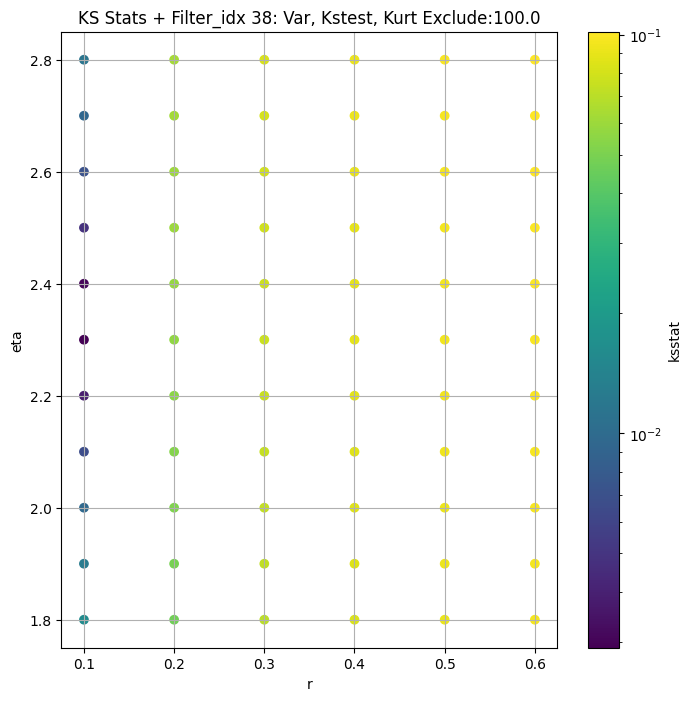

####
Filter_idx  39


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 0 0.033442619311241956 94.86164765695496


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 50 0.021663150123837682 46.53056745096227


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 100 0.020999632172760796 39.37299211427687


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 200 0.020929034976573502 33.68366525799421
Number of samples: 100000, Without approximation : 786432000.0


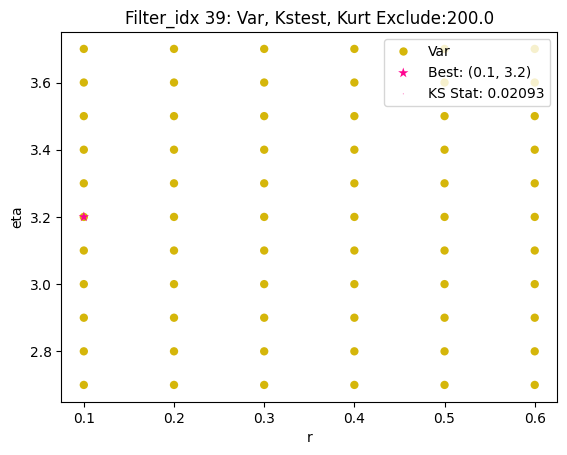

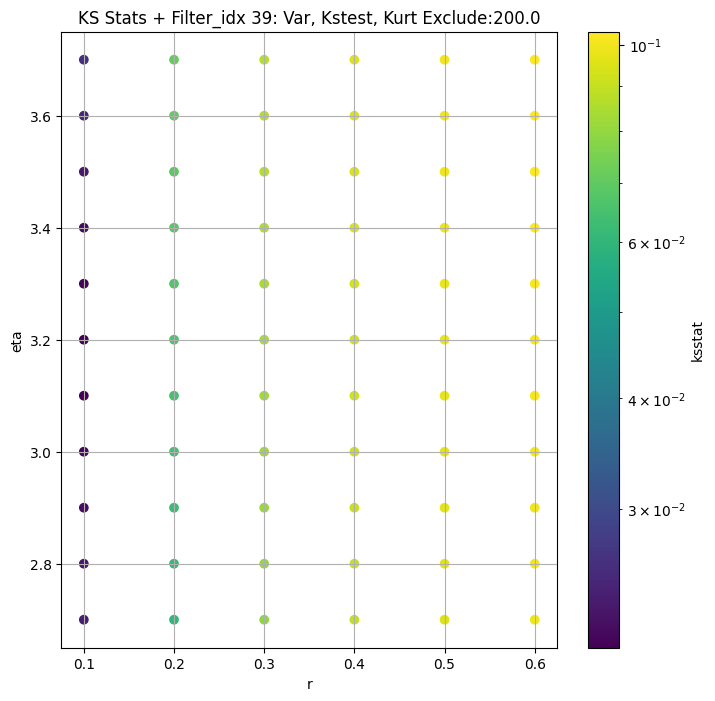

####
Filter_idx  40


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 0 0.031655094302618876 67.9482446126507


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 50 0.01607568661907878 38.14427063811084


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 100 0.011745923142208264 33.038419065914994


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 200 0.007982091395592195 28.367103284515313
Number of samples: 100000, Without approximation : 786432000.0


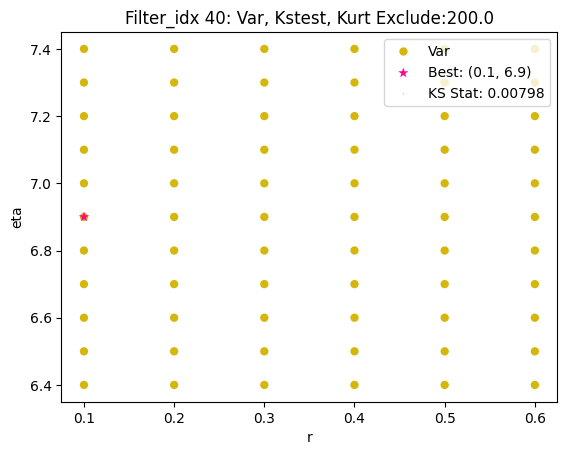

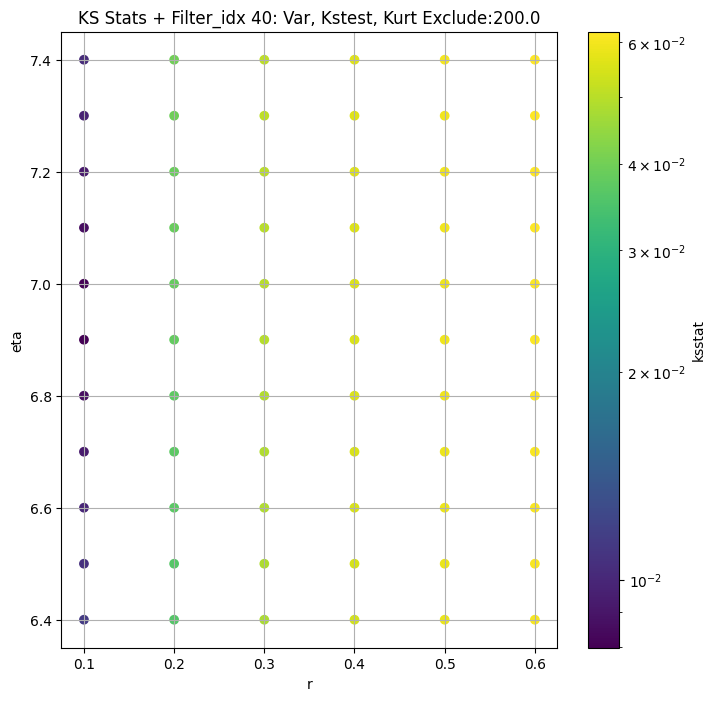

####
Filter_idx  41


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 0 0.025415666062004405 35.942762707893046


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 50 0.012745333362908284 17.46826954206213


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 100 0.00980238633904984 15.3325821994882


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 200 0.00706250682873355 13.27879984780716
Number of samples: 100000, Without approximation : 786432000.0


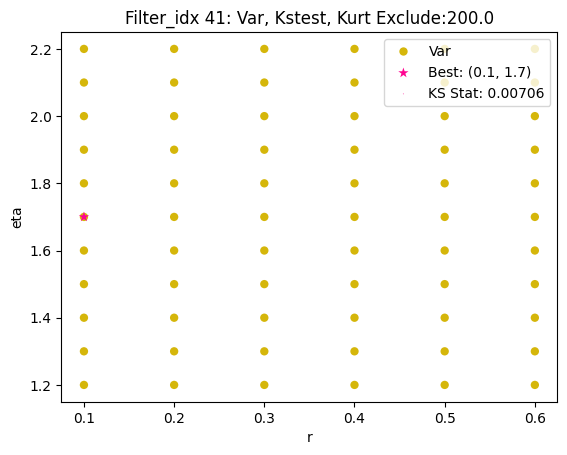

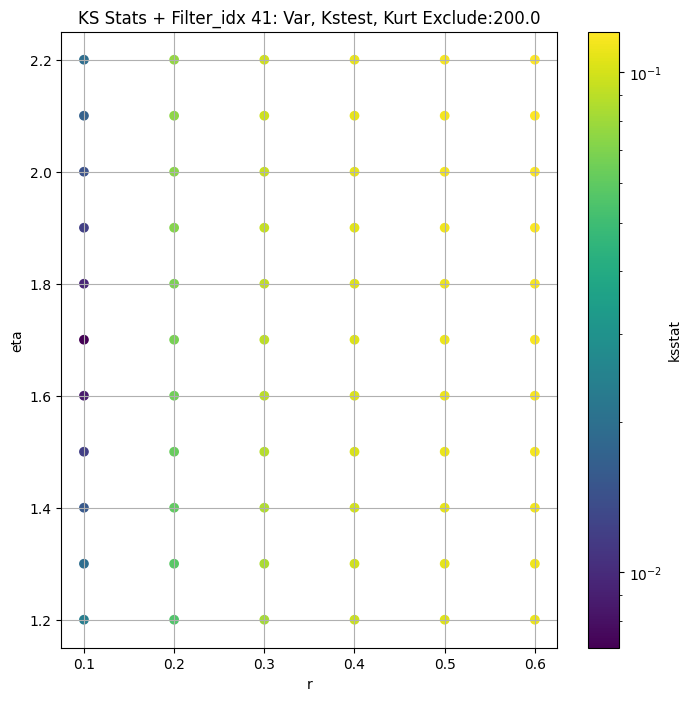

####
Filter_idx  42


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
42 0 0.02118228104189146 132.4124223827206


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
42 50 0.0037946695500293837 60.73052219182036


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
42 100 0.001857619440445879 52.63134057252037


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
42 200 0.003285081837285403 45.563284958806676
Number of samples: 100000, Without approximation : 786432000.0


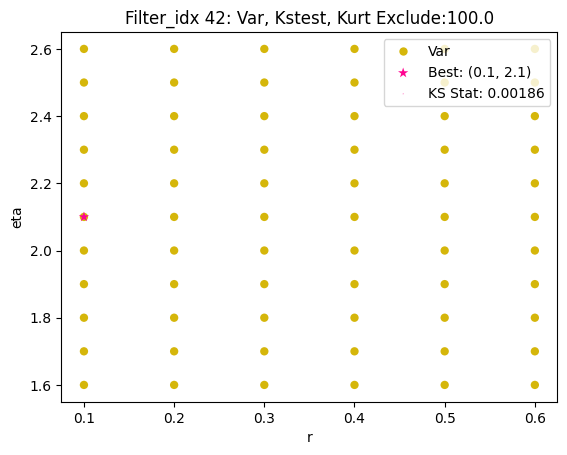

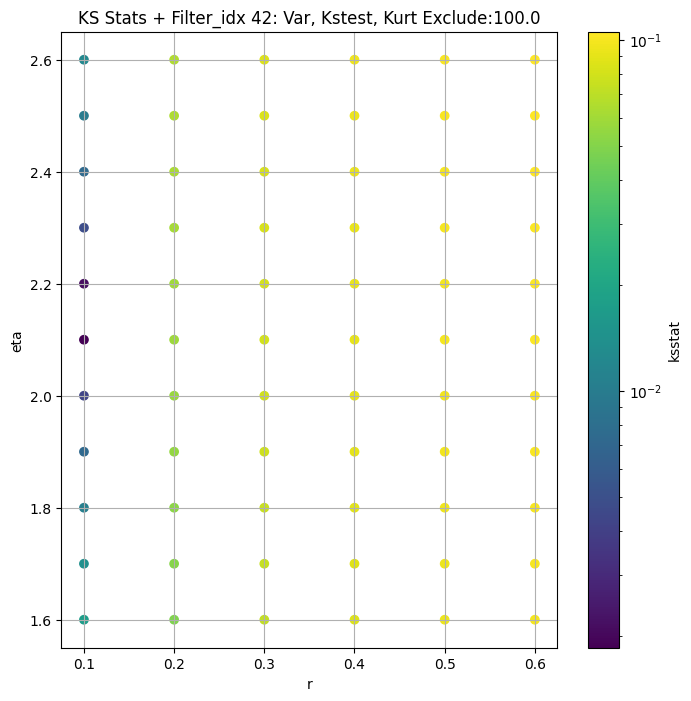

####
Filter_idx  43


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
43 0 0.021760198004796193 39.75424166570141


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
43 50 0.003974626336923359 17.609352945064042


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
43 100 0.0029562841502687176 15.394941839374763


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
43 200 0.0037272902288990606 13.453647953693164
Number of samples: 100000, Without approximation : 786432000.0


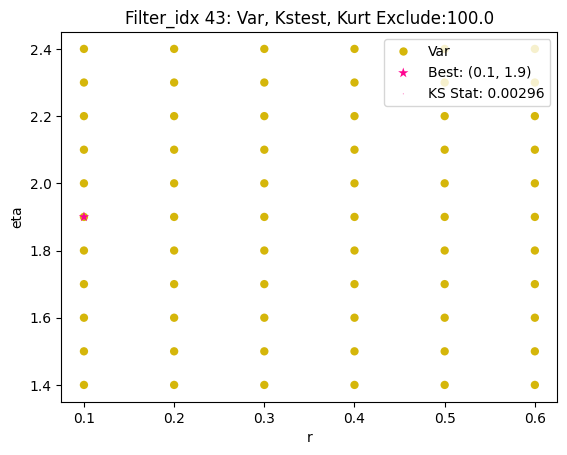

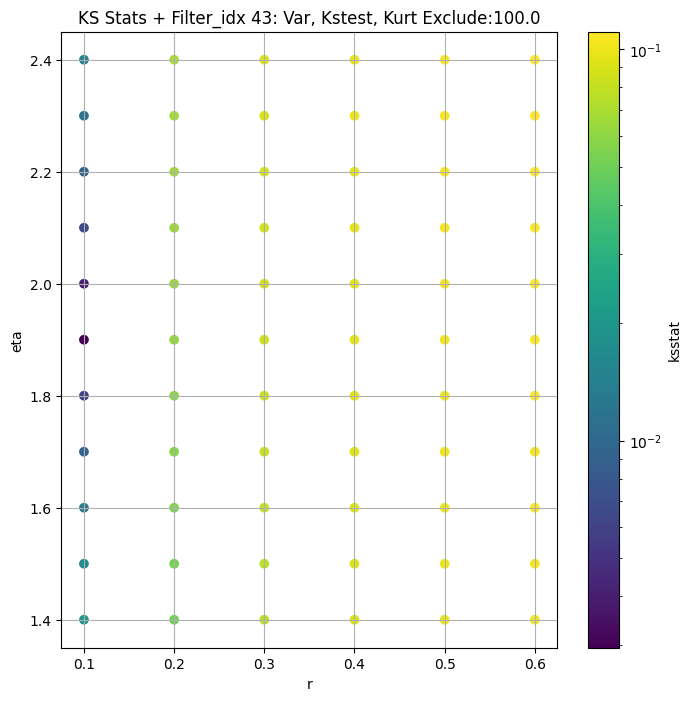

####
Filter_idx  44


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
44 0 0.02407153135042006 121.03275782701414


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
44 50 0.0067319006120715175 59.22387347221282


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
44 100 0.0036357924417760312 50.88648570903103


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
44 200 0.0032293377639963858 43.84519991894345
Number of samples: 100000, Without approximation : 786432000.0


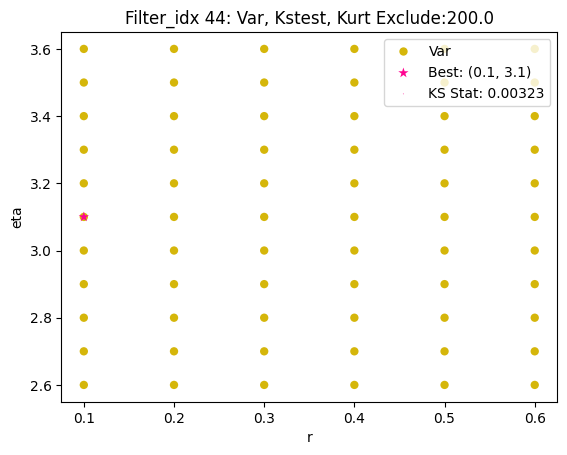

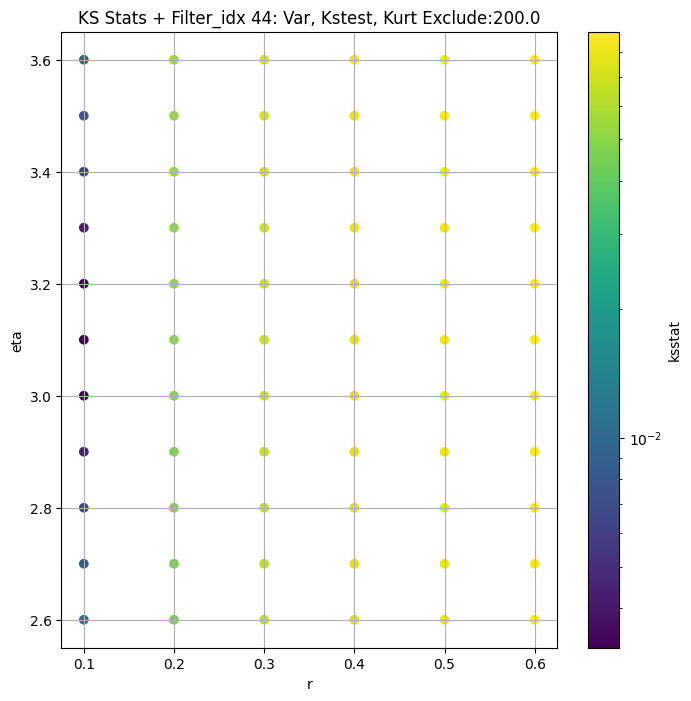

####
Filter_idx  45


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
45 0 0.022857143040689754 65.28569377704973


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
45 50 0.007489840180257223 30.40054878426764


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
45 100 0.004744009710828112 25.720636046020314


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
45 200 0.00450701602789727 22.15544235692223
Number of samples: 100000, Without approximation : 786432000.0


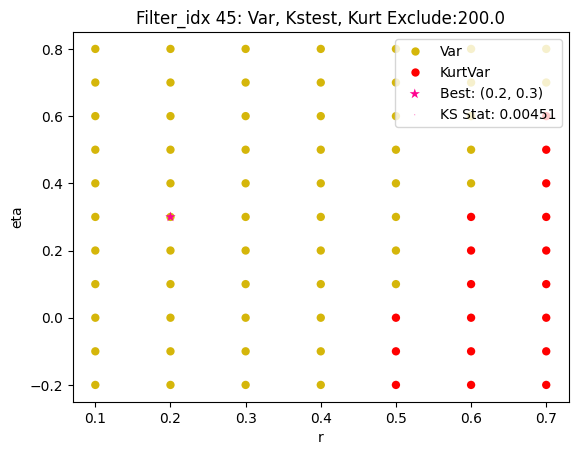

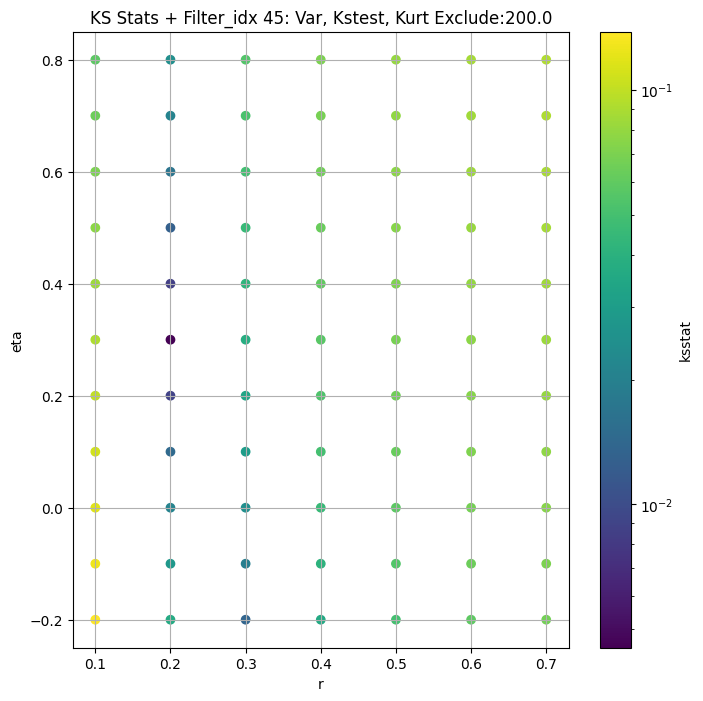

####
Filter_idx  46


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
46 0 0.033389038077046684 34.38249011462446


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
46 50 0.020349057159281383 18.785332323753668


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
46 100 0.018799509975959194 16.143036937704952


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
46 200 0.018783276852354924 13.904988773577681
Number of samples: 100000, Without approximation : 786432000.0


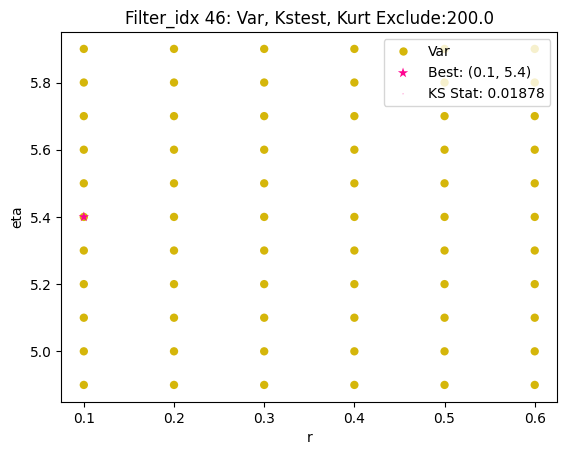

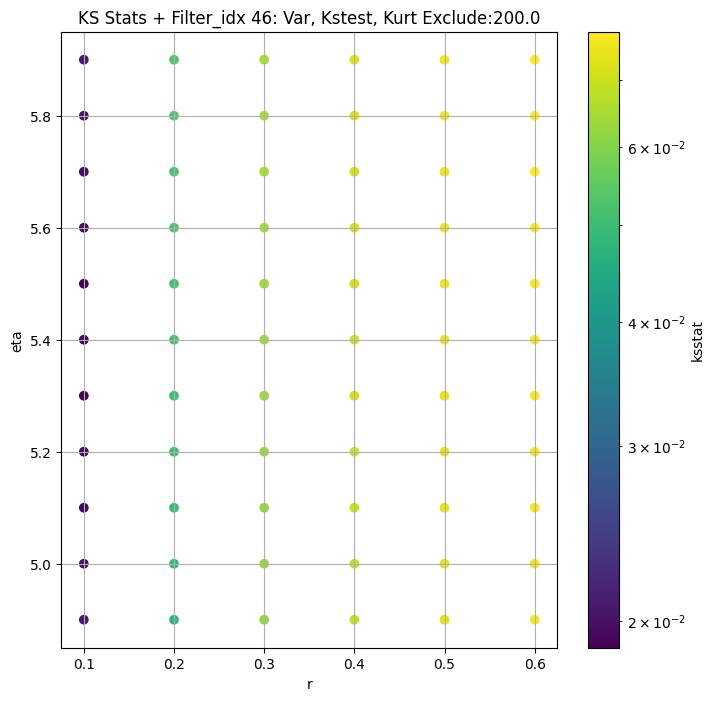

####
Filter_idx  47


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
47 0 0.022893252029193345 48.93792609994658


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
47 50 0.0053234824104686496 21.222981115115967


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
47 100 0.002937359096287895 18.11182047279774


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
47 200 0.0032561373294888174 15.376974783123917
Number of samples: 100000, Without approximation : 786432000.0


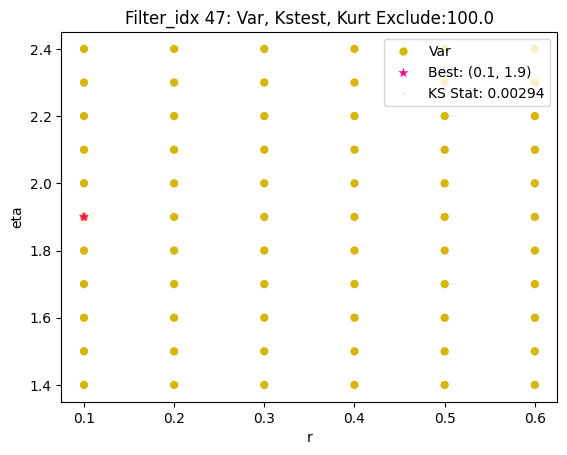

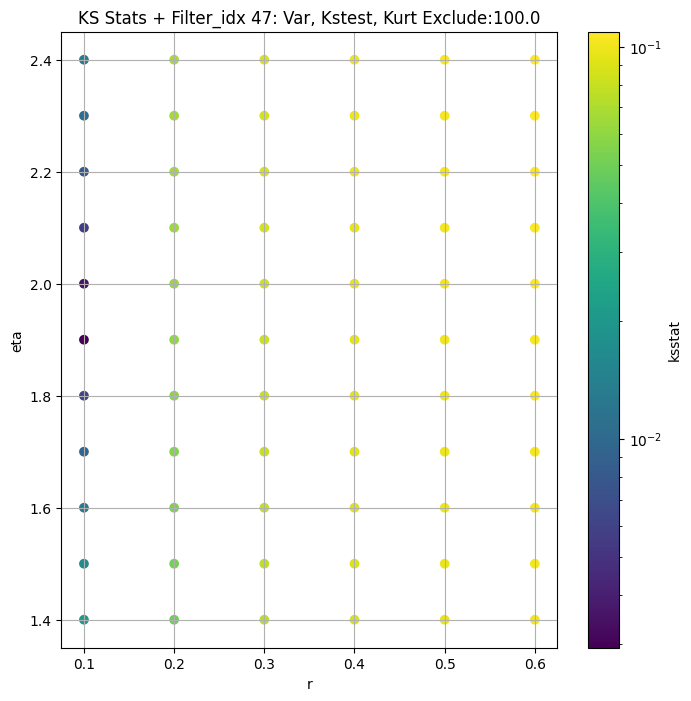

####
Filter_idx  48


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
48 0 0.022804298410269985 35.249836278824034


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
48 50 0.01214865300092921 20.260043287354048


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
48 100 0.009140898655183527 17.464348237242213


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
48 200 0.006660293593457989 14.664425266747925
Number of samples: 100000, Without approximation : 786432000.0


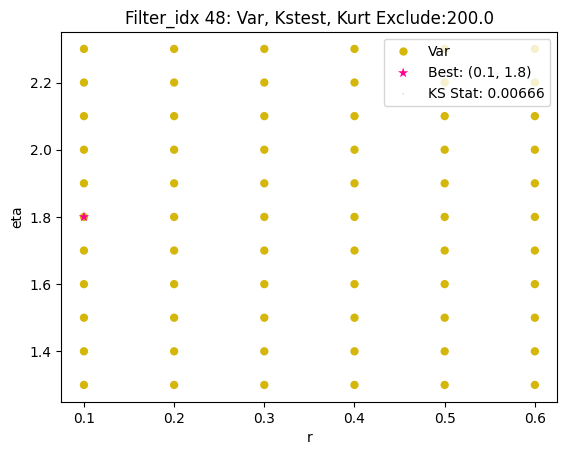

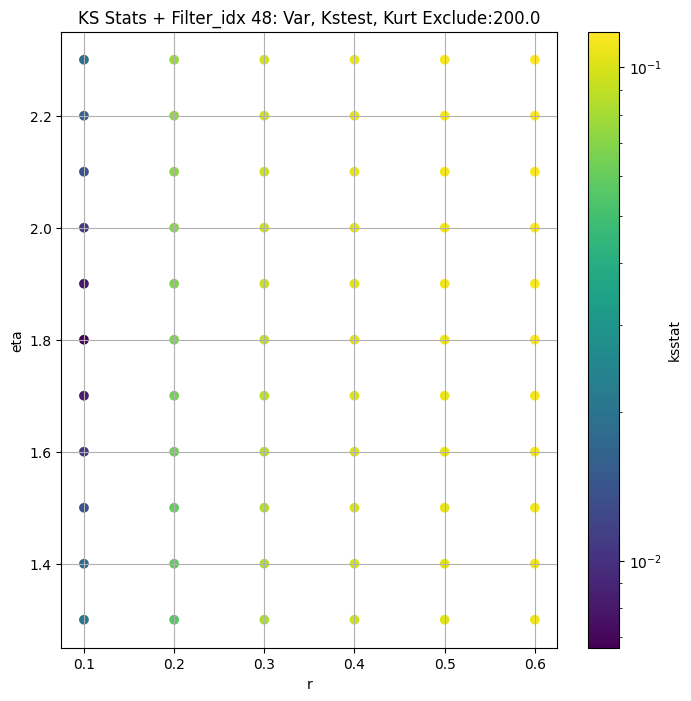

####
Filter_idx  49


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
49 0 0.02140815640069471 126.2091955107744


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
49 50 0.005370784660682193 62.786420514369595


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
49 100 0.001907591148167631 54.869640001576


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
49 200 0.003652979635952569 48.21855536984342
Number of samples: 100000, Without approximation : 786432000.0


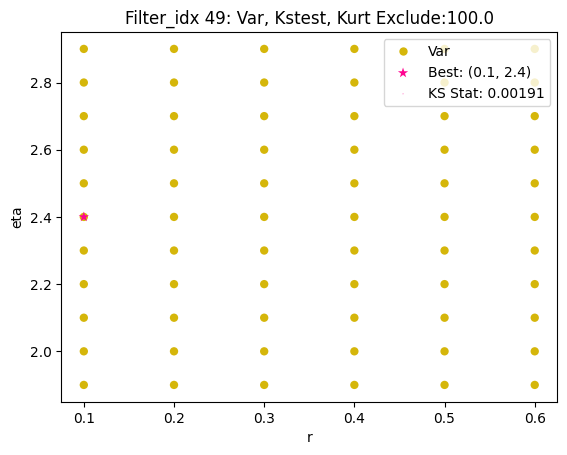

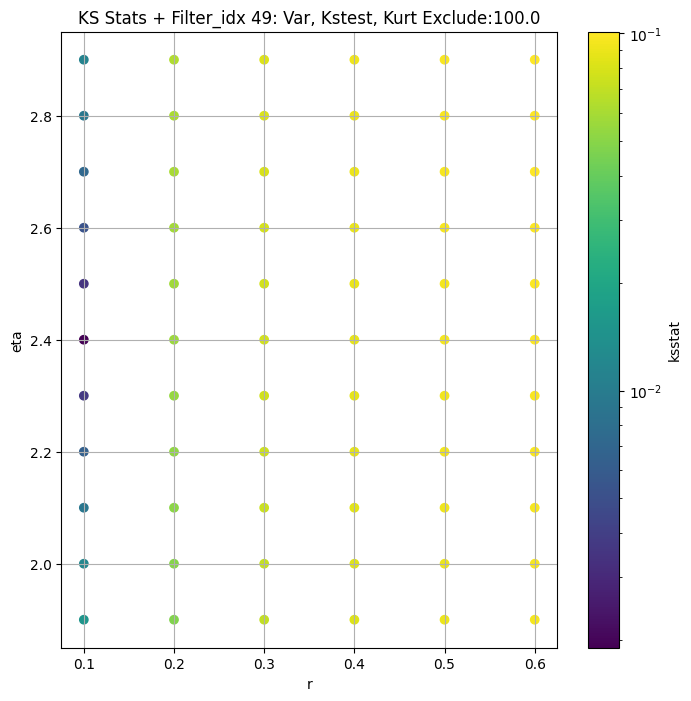

####
Filter_idx  50


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
50 0 0.02396321172034732 68.81887360422142


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
50 50 0.006955187604303248 31.70394381860075


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
50 100 0.005191129576585879 27.5608592278505


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
50 200 0.004499026924045912 23.958400774329736
Number of samples: 100000, Without approximation : 786432000.0


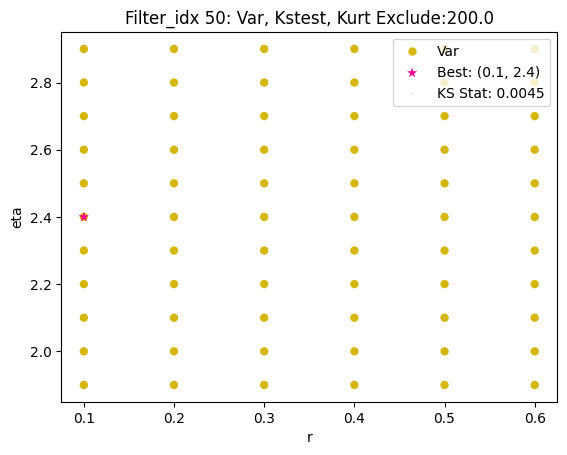

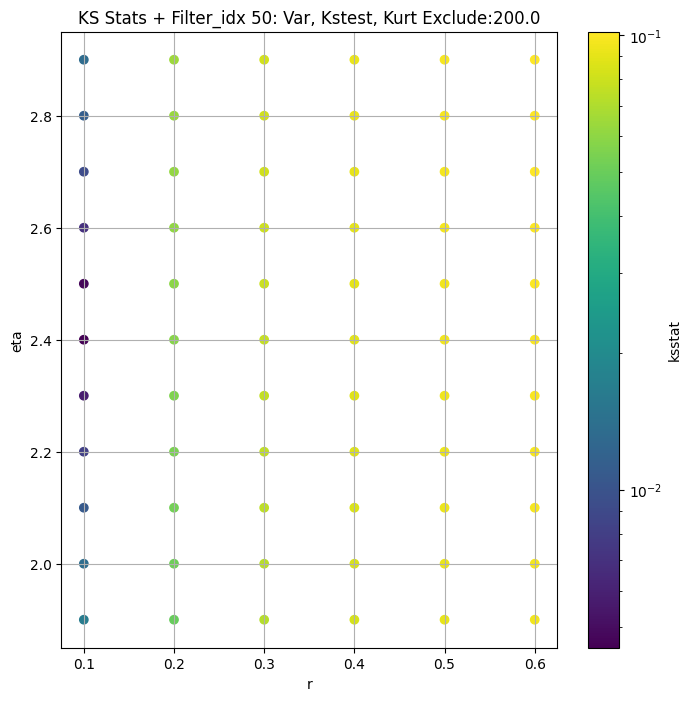

####
Filter_idx  52


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
52 0 0.030254761591933077 65.672394887816


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
52 50 0.014177587063610386 35.627225652994134


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
52 100 0.009697486573211483 30.871981499651493


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
52 200 0.0050416705419799035 26.622786154500233
Number of samples: 100000, Without approximation : 786432000.0


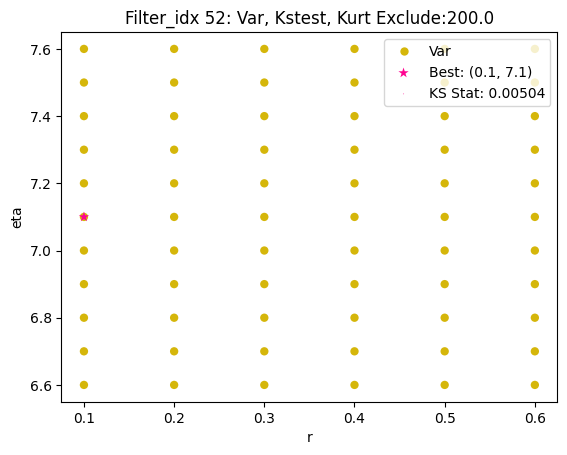

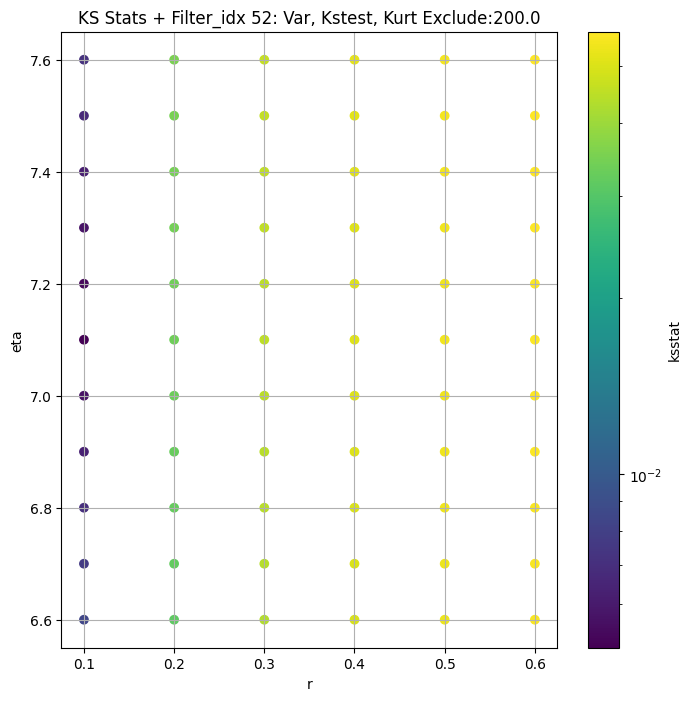

####
Filter_idx  54


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
54 0 0.035301538017744716 19.770719919758225


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
54 50 0.01813408509907255 6.65721713980135


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
54 100 0.013052814015602487 5.459016446798316


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
54 200 0.008641790862216336 4.273539631994978
Number of samples: 100000, Without approximation : 786432000.0


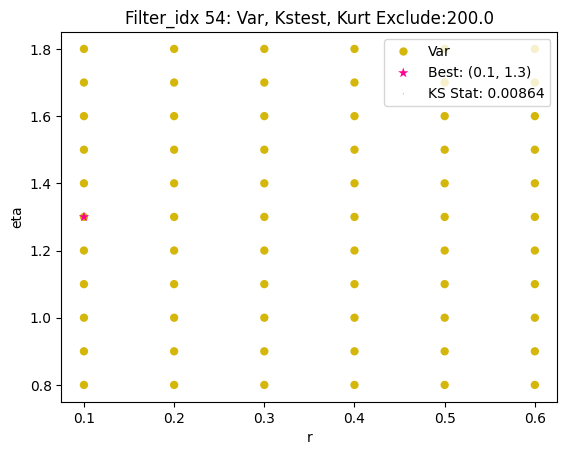

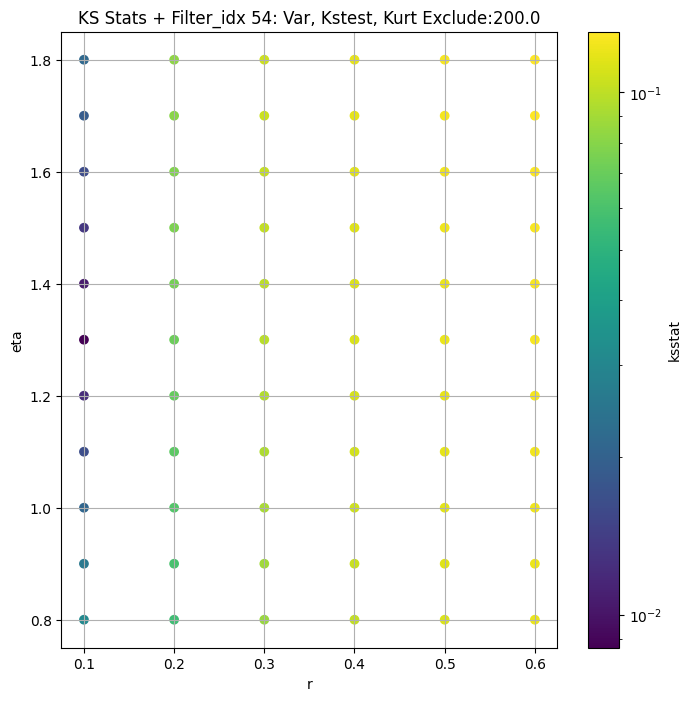

####
Filter_idx  55


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
55 0 0.025563841237908183 44.74500565499701


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
55 50 0.010417318124798666 22.520929877958107


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
55 100 0.007526055202647819 19.65311509774849


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
55 200 0.0040490181332279995 16.928446101161608
Number of samples: 100000, Without approximation : 786432000.0


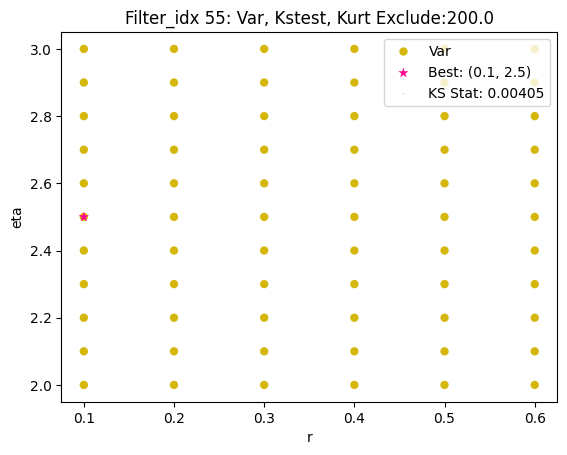

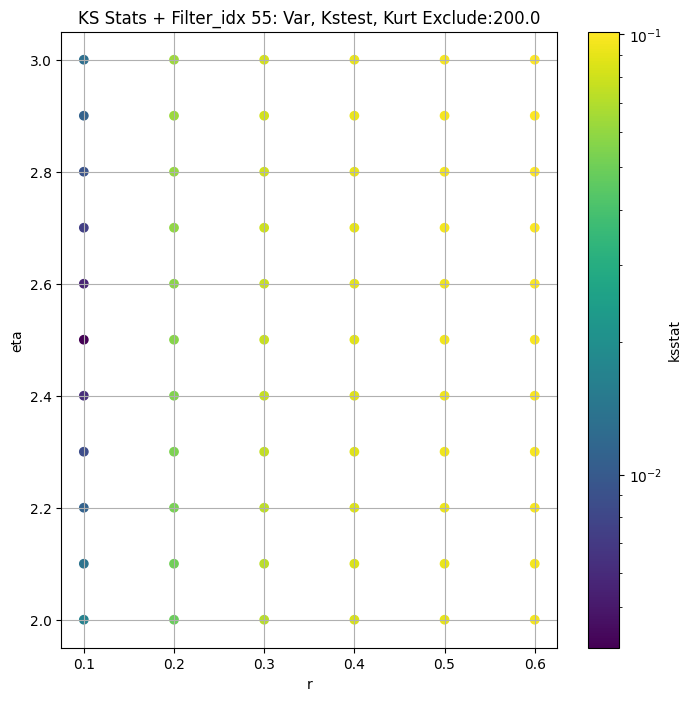

####
Filter_idx  56


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
56 0 0.021216561657381616 84.23066067155982


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
56 50 0.005378511009045073 40.124351873023926


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
56 100 0.0015780850078983555 34.6911904854754


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
56 200 0.002811660566178986 29.76414697927925
Number of samples: 100000, Without approximation : 786432000.0


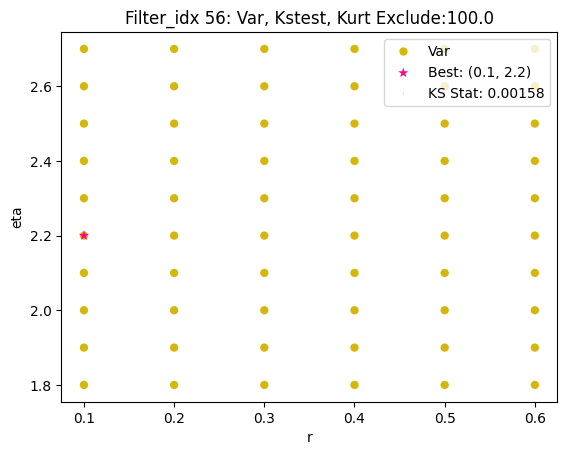

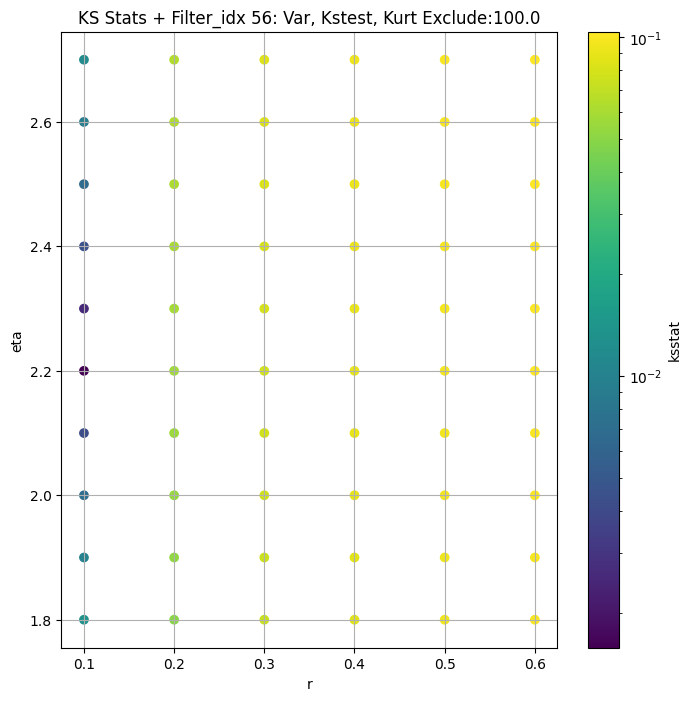

####
Filter_idx  57


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
57 0 0.023049665917764472 47.957864471458954


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
57 50 0.008491716693847295 25.189595380483244


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
57 100 0.0061136645775750065 22.01163864390933


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
57 200 0.004193944417235973 19.21277898717059
Number of samples: 100000, Without approximation : 786432000.0


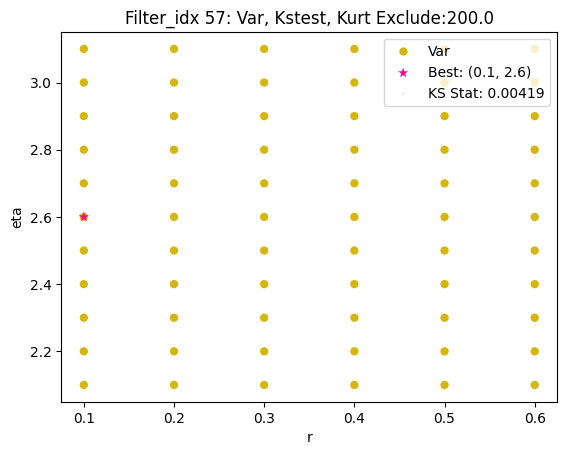

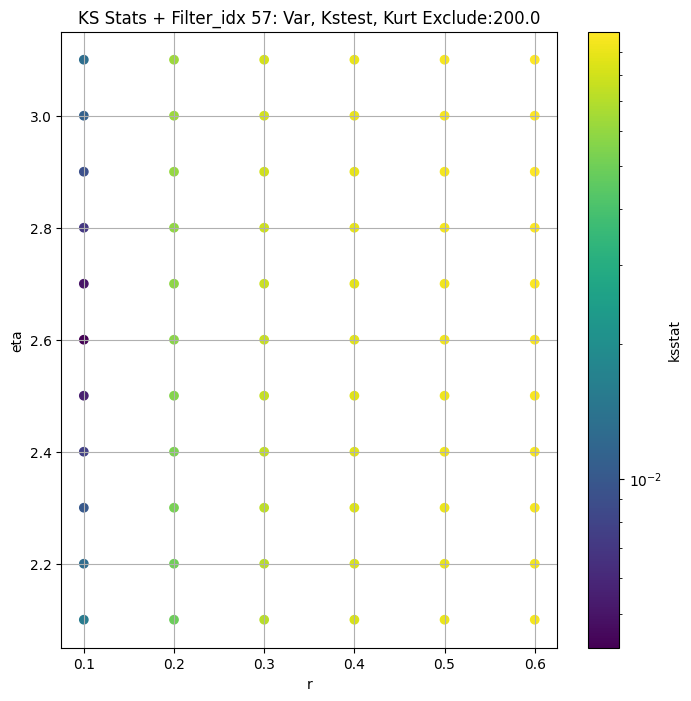

####
Filter_idx  58


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
58 0 0.032944814485450946 49.55477709837664


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
58 50 0.019775813557323163 27.69734785110877


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
58 100 0.016409255623105246 23.867477407921974


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
58 200 0.013799308495988205 20.449981972221508
Number of samples: 100000, Without approximation : 786432000.0


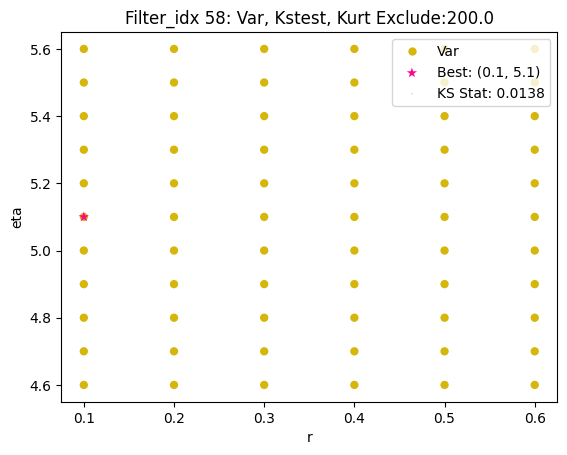

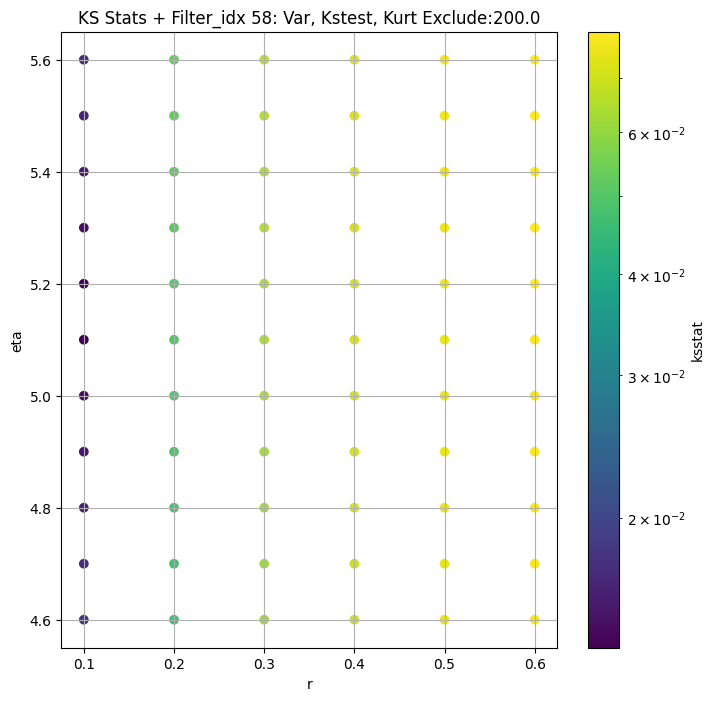

####
Filter_idx  59


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
59 0 0.025112740478332896 105.8634446607721


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
59 50 0.006845256711793923 47.94457123072066


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
59 100 0.0037791909075195473 41.137190465551456


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
59 200 0.003217616917332156 35.286161978397764
Number of samples: 100000, Without approximation : 786432000.0


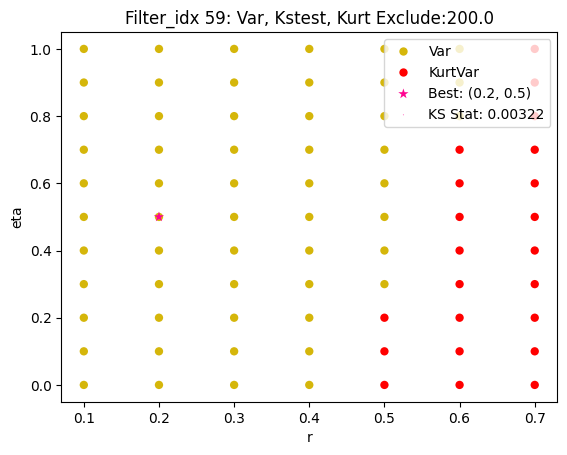

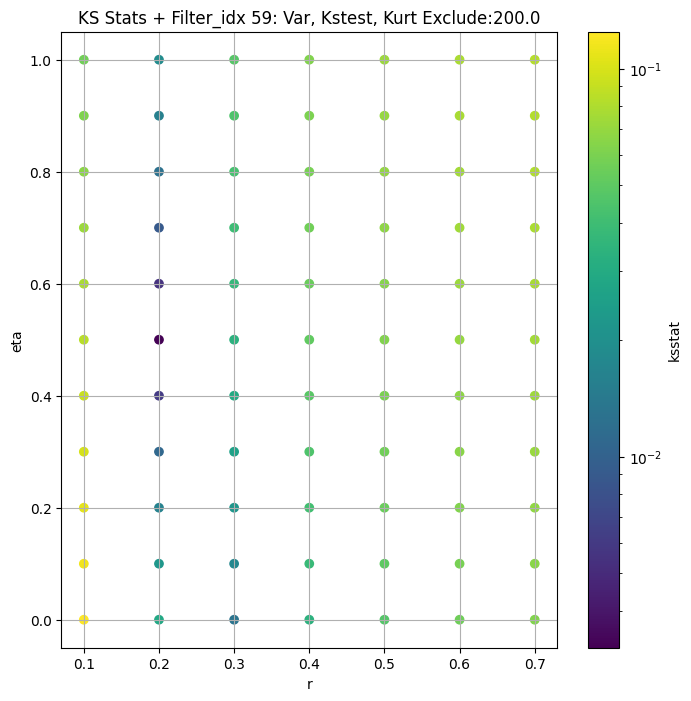

####
Filter_idx  60


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
60 0 0.037961461251439066 5.645546374705824


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
60 50 0.021031543207975956 2.4659928077377047


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
60 100 0.018301488249484965 2.1155681474622763


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
60 200 0.0158750621138134 1.7995922603122116
Number of samples: 100000, Without approximation : 786432000.0


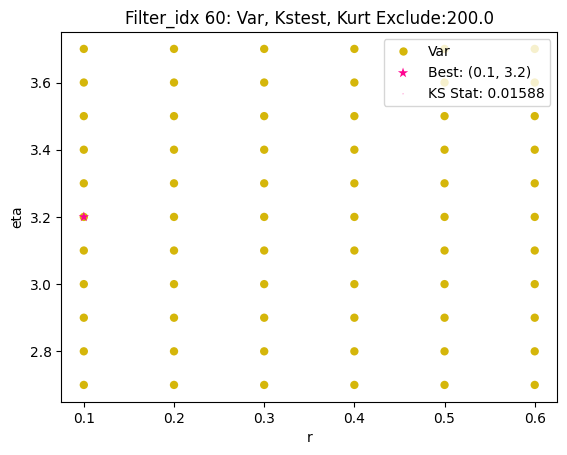

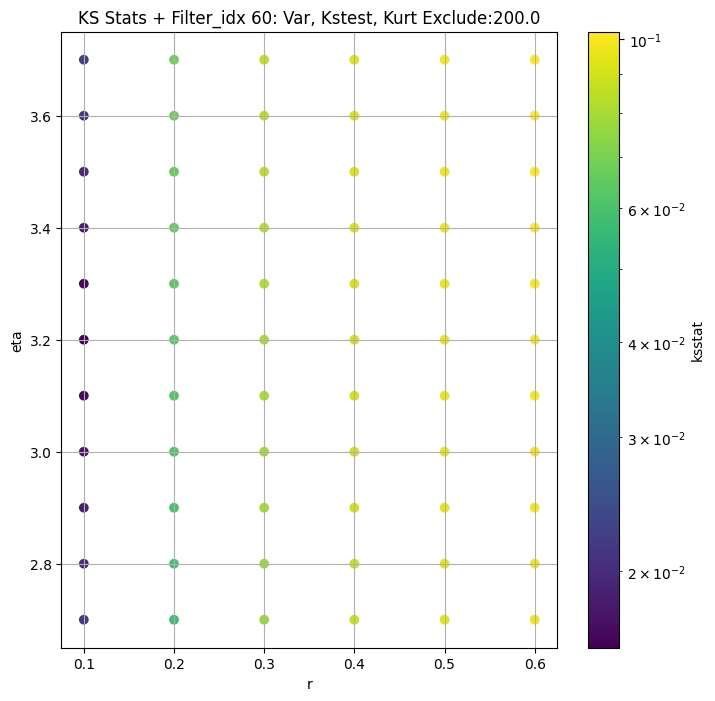

####
Filter_idx  61


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
61 0 0.0217647635670134 39.508111203363704


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
61 50 0.00890448217955575 20.79052313825208


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
61 100 0.006031098873739871 18.170976835507066


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
61 200 0.0038441320938086276 15.552951597379858
Number of samples: 100000, Without approximation : 786432000.0


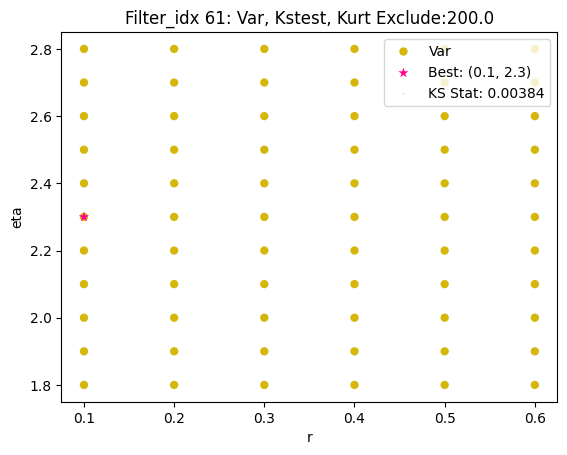

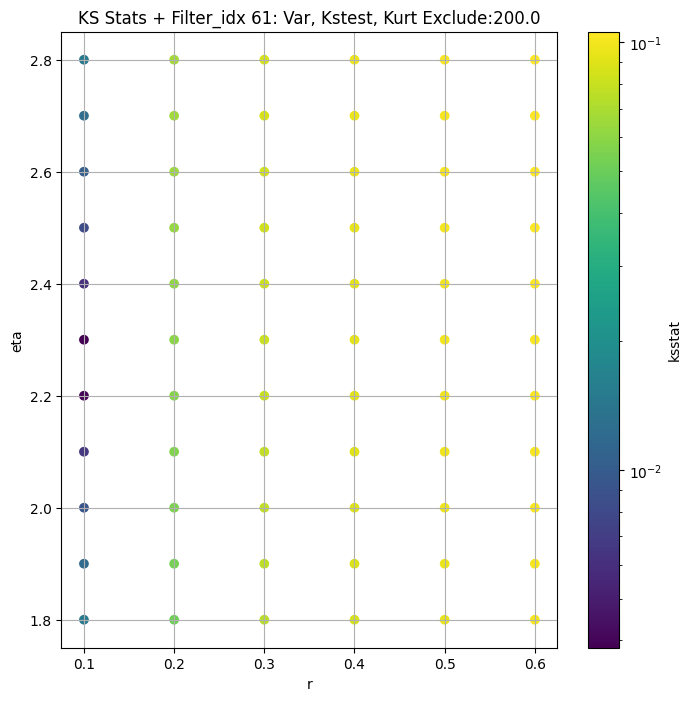

####
Filter_idx  62


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
62 0 0.024306184572689182 56.22971547569739


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
62 50 0.005909845494223298 20.2025445404153


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
62 100 0.0053373598991489635 17.314135778090947


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
62 200 0.005618707695695113 14.862886925848077
Number of samples: 100000, Without approximation : 786432000.0


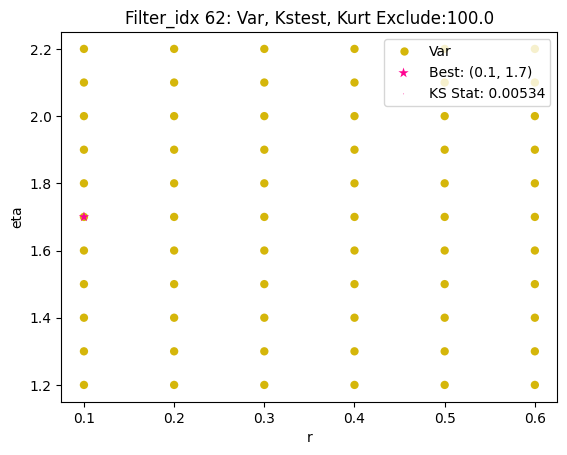

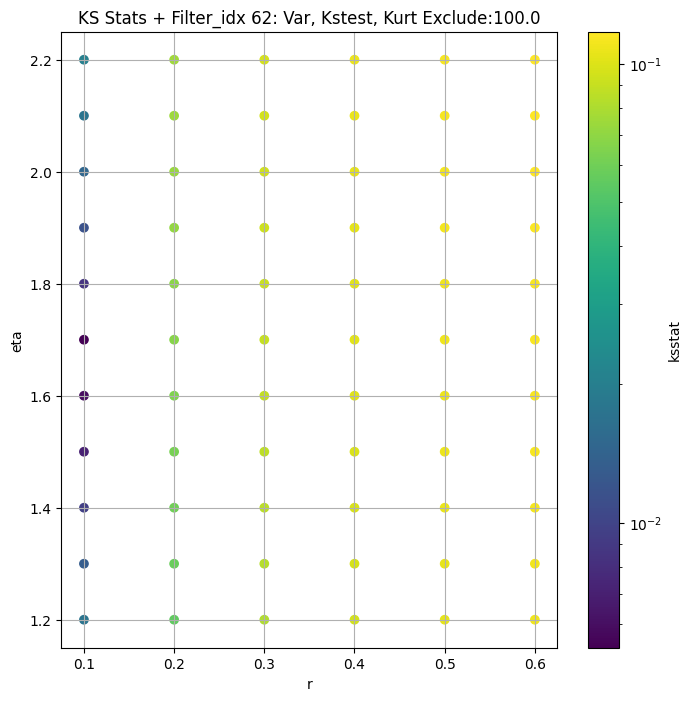

####
Filter_idx  63


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
63 0 0.02727553893637269 18.566403833571894


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
63 50 0.012019015986822312 7.7873024290658766


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
63 100 0.010461743256756306 6.777668628569047


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
63 200 0.007768740884779468 5.782450861737567
Number of samples: 100000, Without approximation : 786432000.0


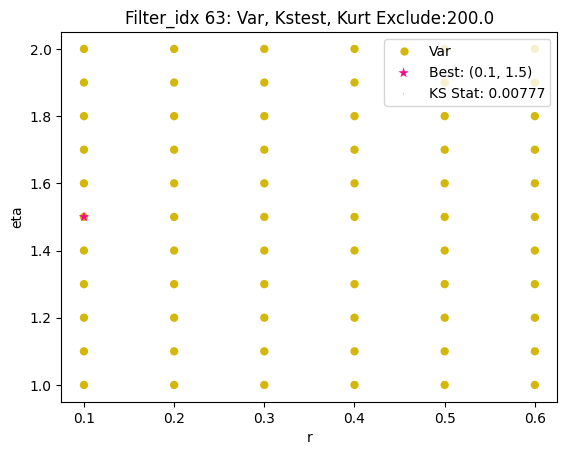

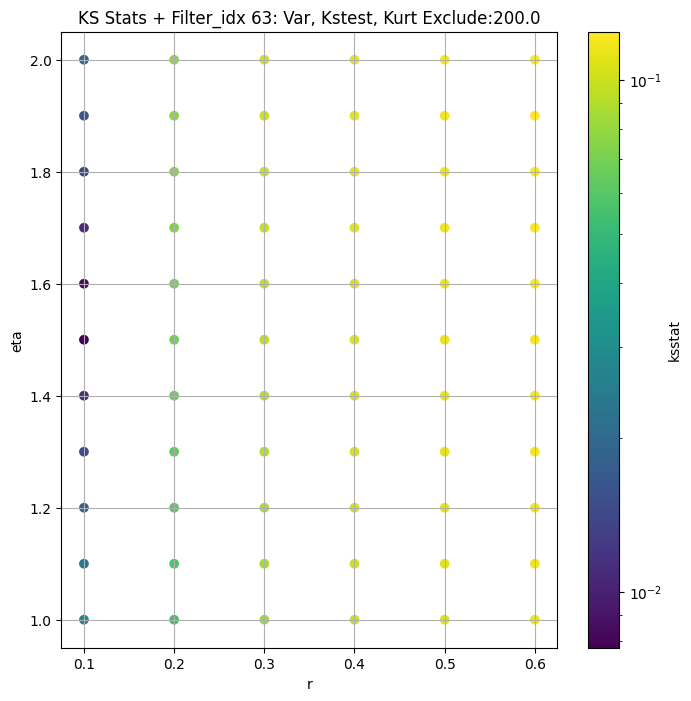

,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,initial_r,initial_eta,initial_scale,initial_exclude_cutoff,best_augmented_var,kstest_stat_cutoff_0.05
filter_idx,,,,,,,,,,,,,,,
0,105.627108,37.405882,872.914854,1200.635499,7.004659,839.339075,786432000.0,dual_color,0.002043,0.1,2.3,2.571762e-15,100.0,48.323839,0.000048
2,160.716134,56.549257,1519.894028,1504.172784,6.669132,893.046912,786432000.0,dual_color,0.001901,0.1,2.2,4.886788e-15,100.0,72.286647,0.000048
3,59.288343,17.905150,647.920804,4685.193534,14.040535,916.223182,786432000.0,single_edge,0.006504,0.1,1.8,3.805328e-15,200.0,20.318825,0.000048
4,151.160931,51.854637,1313.650861,1464.834926,7.111011,828.869069,786432000.0,dual_color,0.002376,0.1,2.1,5.662153e-15,100.0,65.548202,0.000048
5,60.719316,18.078568,688.166568,2347.202815,8.981808,920.485126,786432000.0,dual_color,0.005098,0.1,2.8,3.556848e-16,200.0,20.419045,0.000048
6,53.370521,16.667455,734.884189,3356.859484,7.065387,907.363143,786432000.0,single_edge,0.003947,0.1,2.9,2.701811e-16,200.0,19.117563,0.000048
7,75.992599,26.422622,442.863026,615.866020,6.994462,770.913021,786432000.0,inside_out,0.016451,0.1,4.2,4.523301e-17,100.0,34.630677,0.000048
8,2.395725,0.557518,66.139435,9346.824402,9.244470,970.442983,786432000.0,misc,0.021073,0.1,2.9,8.776220e-18,200.0,0.620991,0.000048
9,21.424416,3.685756,591.276779,12551.392811,13.515366,968.833048,786432000.0,multi_edge,0.014015,0.1,0.6,4.008208e-14,200.0,4.370043,0.000048


In [12]:
master_df_combo_path = Path(os.path.join(CWD, "CSVs", "master_df_combo.csv"))
rEtaKsstats_dict_path = Path(os.path.join(CWD, "cache", "rEtaKsstats_dict.pickle"))

rEtaKsstats_dict = dict()

if RERUN or not master_df_combo_path.exists():
    sorted_params = sorted(all_cdfs)
    ksstats_dict = dict()

    for i, group in enumerate(GROUPS): # TODO For quick testing purposes
        print(f"####\n{GROUP.capitalize()} ", group)
        sample = group_data_map[group]
        if len(sample) == 0:
            continue
        group_cdfs_df = all_cdfs_df.copy()
        master_df.loc[group, 'kstest_stat_initial'] = 1

        for j in range(len(EXCLUDE_CUTOFFS)):

            exclude_cutoff = EXCLUDE_CUTOFFS[j]
            exclude_cutoff = int(exclude_cutoff)

            if exclude_cutoff == 0:
                augmented_var = np.var(group_data_map[group]) 
            else:
                augmented_var = np.var(group_data_map[group][exclude_cutoff:-exclude_cutoff])
                if augmented_var == np.var(group_data_map[group]):
                    continue 
                
            group_cdfs_df['scale'] = np.clip((augmented_var / group_cdfs_df['variance']), 0,  SCALE_CAP)
            ksstats, initial_param, min_stat = gridsearch(sample, all_cdfs, debug=True, scales=group_cdfs_df['scale'])
            augmented_var_df.loc[group, f"kstest_stat_{exclude_cutoff}"] = min_stat
            group_cdfs_df[f'ksstat_exclude_{exclude_cutoff}'] = ksstats
            
            print(group, exclude_cutoff, min_stat, augmented_var)
            
            if (min_stat < master_df.loc[group, 'kstest_stat_initial']) and not np.isclose(min_stat, master_df.loc[group, 'kstest_stat_initial'], 1e-6):
                inital_min_stat = min_stat
                inital_best_param = initial_param
                master_df.loc[group, 'kstest_stat_initial'] = min_stat
                initial_scale = group_cdfs_df.loc[(group_cdfs_df["r"] ==  initial_param[0]) & (group_cdfs_df["eta"] ==  initial_param[1])]["scale"].iloc[0]
                master_df.loc[group, 'initial_r'], master_df.loc[group, 'initial_eta'] = initial_param
                master_df.loc[group, 'initial_scale'] = initial_scale
                master_df.loc[group, 'initial_exclude_cutoff'] = exclude_cutoff
                master_df.loc[group, 'best_augmented_var'] = augmented_var
        
        ksstats = group_cdfs_df[f"ksstat_exclude_{int(master_df.loc[group, 'initial_exclude_cutoff'])}"]
            
        print(f"Number of samples: {sample.size}, Without approximation : {master_df.loc[group, 'total_samples']}")
        
        cutoff = stats.kstwo(n=master_df.loc[group, 'total_samples']).isf(0.05)
        master_df.loc[group, 'kstest_stat_cutoff_0.05'] = cutoff

        best_scales = np.clip((master_df.loc[group, 'best_augmented_var'] / group_cdfs_df['variance']), 0,  SCALE_CAP)

        group_cdfs_df['variance'] = group_cdfs_df['variance'] * best_scales
        group_cdfs_df['kurtosis'] = group_cdfs_df['kurtosis'] * best_scales

        group_cdfs_df = add_tests_to_df(cdfs_df = group_cdfs_df, group = group, var_kurt_df = master_df, ksstats = ksstats).sort_values(['r', 'eta'])

        group_dict = {'r' : group_cdfs_df['r'], 'eta' : group_cdfs_df['eta']}
        group_dict.update({f'ksstat_exclude_{exclude_cutoff}' : group_cdfs_df[f'ksstat_exclude_{exclude_cutoff}'] for exclude_cutoff in EXCLUDE_CUTOFFS[:j+1]})
        rEtaKsstats_dict[group] = group_dict

        cols = ['pass_var', 'pass_kstest', 'pass_kurt']

        fig = combo_test_plot(group_cdfs_df, cols, 
                            plot_name=f"{GROUP.capitalize()} {group}: {', '.join([col[5:].capitalize() for col in cols])} Exclude:{master_df.loc[group, 'initial_exclude_cutoff']}", 
                            target_var = None,
                            best_param = inital_best_param,
                            best_ksstat=inital_min_stat
                            )
        
        fig.figure.savefig(os.path.join(CWD, "plots", f"full_grid_search_combo_plot_layer{group}.jpg"), bbox_inches = 'tight', dpi=100)

        # Optional: 
        # Create plots of bootstrapped variance and kurtosis for varying confidence intervals
        # fig_var = create_ci_scatter_plot(group_cdfs_df, var_values_dict, metric='variance', group=group)
        # fig_kurt = create_ci_scatter_plot(group_cdfs_df, kurt_values_dict, metric='kurtosis', group=group)

        # fig_var.savefig(os.path.join(CWD, "plots", f"ci_scatter_variance_{GROUP}_{group}_bootstrap{n_bootstrap}.jpg"), bbox_inches='tight')
        # plt.close(fig_var)
        # fig_kurt.savefig(os.path.join(CWD, "plots", f"ci_scatter_variance_{GROUP}_{group}_bootstrap{n_bootstrap}.jpg"), bbox_inches='tight')
        # plt.close(fig_kurt)

    master_df.to_csv(master_df_combo_path)
    pd.to_pickle(rEtaKsstats_dict, rEtaKsstats_dict_path)
    augmented_var_df.to_csv(augmented_var_df_path)

augmented_var_df = pd.read_csv(augmented_var_df_path, index_col=GROUP)
master_df = pd.read_csv(master_df_combo_path, index_col=GROUP)
rEtaKsstats_dict = pd.read_pickle(rEtaKsstats_dict_path)
master_df

## Optimization

In [13]:
master_df['kstest_stat_best'] = master_df['kstest_stat_initial']
master_df[f'best_r'] = master_df['initial_r']
master_df[f'best_eta'] = master_df['initial_eta']
master_df[f'best_scale'] = master_df['initial_scale']
master_df[f'best_exclude_cutoff'] = master_df['initial_exclude_cutoff']

Filter_idx 0


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 0, 100.0 + 100 = 200, ksstat: 0.004242516638645166, var: 41.546828883667466


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 0, 100.0 + 75 = 175, ksstat: 0.0035585928502166464, var: 42.75388111460867


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 0, 100.0 + 50 = 150, ksstat: 0.0026830046421993936, var: 44.202339209900195


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 0, 100.0 + 25 = 125, ksstat: 0.00201824393577954, var: 45.99824991607214


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 0, 100.0 + 0 = 100, ksstat: 0.0020363478405960866, var: 48.323838683073184


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 0, 100.0 + -25 = 75, ksstat: 0.0027450551632543507, var: 51.522320305745176


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 0, 100.0 + -50 = 50, ksstat: 0.004733287117058671, var: 56.316350064900696


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 0, 100.0 + -75 = 25, ksstat: 0.007239855902748539, var: 64.72575653818451


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 0, 100.0 + -100 = 0, ksstat: 0.01702789201596793, var: 105.62710787719769
Number of samples: 100000, Without approximation : 786432000.0


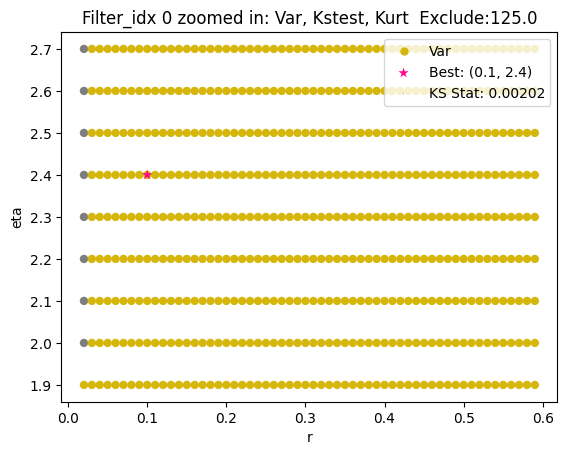

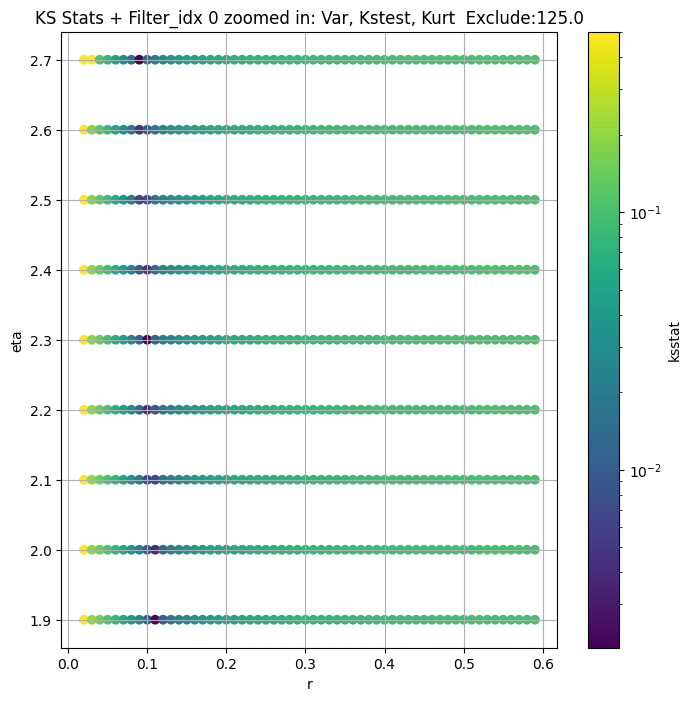

Filter_idx 2


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 2, 100.0 + 100 = 200, ksstat: 0.004160194980244933, var: 62.183615188304465


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 2, 100.0 + 75 = 175, ksstat: 0.0033861774107133424, var: 63.99463721591677


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 2, 100.0 + 50 = 150, ksstat: 0.0025101984013592704, var: 66.15967162616255


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 2, 100.0 + 25 = 125, ksstat: 0.001709214769491707, var: 68.83464906237515


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 2, 100.0 + 0 = 100, ksstat: 0.0019009635628678412, var: 72.28664733080382


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 2, 100.0 + -25 = 75, ksstat: 0.0032728976476620597, var: 77.01620317097318


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 2, 100.0 + -50 = 50, ksstat: 0.004794475147664179, var: 84.11893917173289


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 2, 100.0 + -75 = 25, ksstat: 0.007692830458331246, var: 96.79891757256745


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 2, 100.0 + -100 = 0, ksstat: 0.01690122864703314, var: 160.71613385273787
Number of samples: 100000, Without approximation : 786432000.0


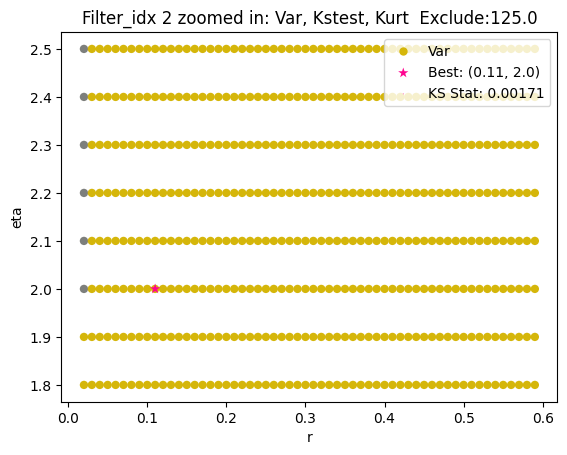

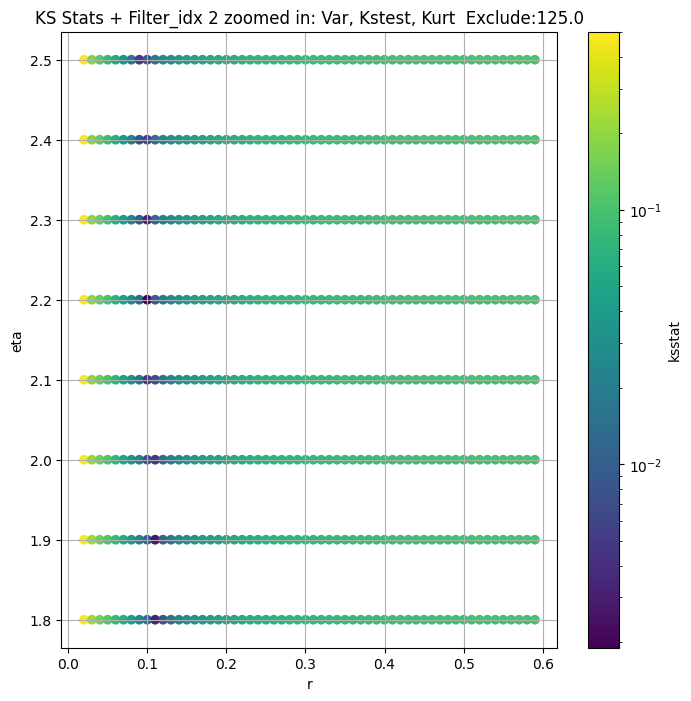

Filter_idx 3


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 3, 200.0 + 100 = 300, ksstat: 0.0047347736668373885, var: 17.816588277032842


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 3, 200.0 + 75 = 275, ksstat: 0.004363630868010393, var: 18.34064340885022


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 3, 200.0 + 50 = 250, ksstat: 0.005066220511801167, var: 18.923114773475547


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 3, 200.0 + 25 = 225, ksstat: 0.005440905610366337, var: 19.576794660319823


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 3, 200.0 + 0 = 200, ksstat: 0.006297171319747719, var: 20.318824867127162


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 3, 200.0 + -25 = 175, ksstat: 0.007354366227283041, var: 21.172826159710375


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 3, 200.0 + -50 = 150, ksstat: 0.007797509294861338, var: 22.17125487657664


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 3, 200.0 + -75 = 125, ksstat: 0.008387020125359135, var: 23.36057492809581


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 3, 200.0 + -100 = 100, ksstat: 0.009399091647313396, var: 24.815208381334674
Number of samples: 100000, Without approximation : 786432000.0


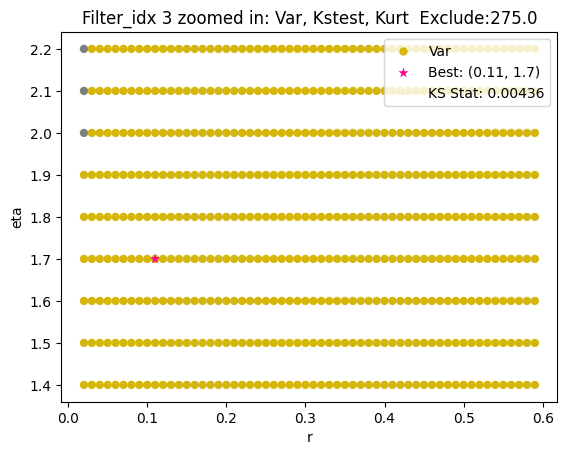

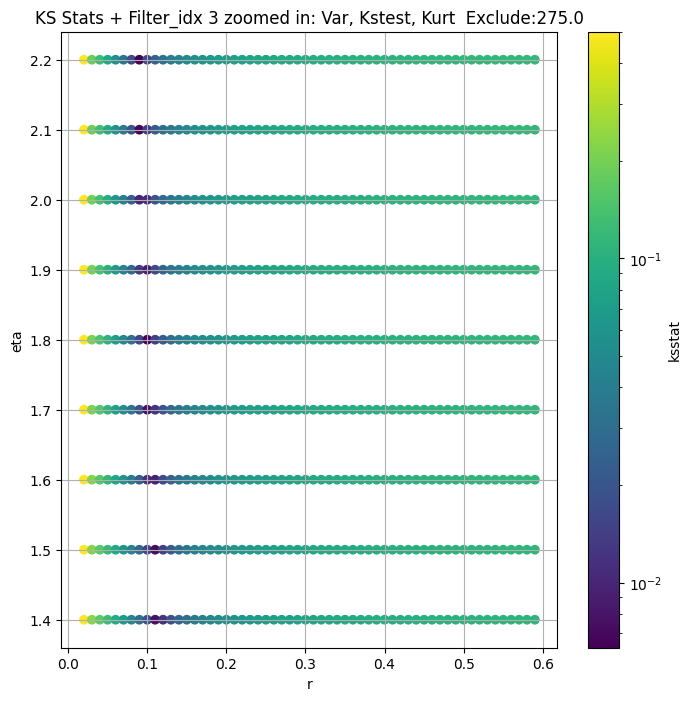

Filter_idx 4


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 4, 100.0 + 100 = 200, ksstat: 0.00530926803376397, var: 56.79373496779701


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 4, 100.0 + 75 = 175, ksstat: 0.004575394696856194, var: 58.40588353930663


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 4, 100.0 + 50 = 150, ksstat: 0.003970505208488739, var: 60.30610395391075


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 4, 100.0 + 25 = 125, ksstat: 0.0033848702261576324, var: 62.617573350476405


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 4, 100.0 + 0 = 100, ksstat: 0.002294368528011237, var: 65.54820189702058


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 4, 100.0 + -25 = 75, ksstat: 0.0012468578235009797, var: 69.49887374368095


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 4, 100.0 + -50 = 50, ksstat: 0.0024245561209190747, var: 75.4246131986221


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 4, 100.0 + -75 = 25, ksstat: 0.005475870569788044, var: 86.43837445719456


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 4, 100.0 + -100 = 0, ksstat: 0.01645032650721001, var: 151.1609310936303
Number of samples: 100000, Without approximation : 786432000.0


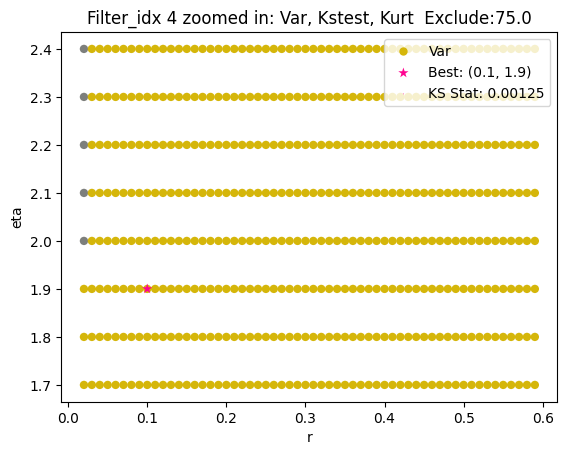

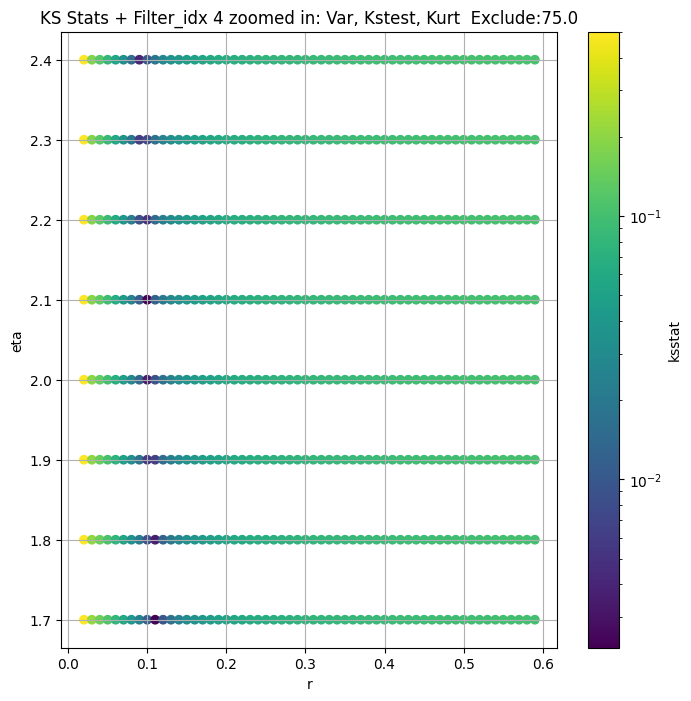

Filter_idx 5


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 5, 200.0 + 100 = 300, ksstat: 0.006230558246564488, var: 18.510568829872447


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 5, 200.0 + 75 = 275, ksstat: 0.0062075246260729355, var: 18.908632375655817


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 5, 200.0 + 50 = 250, ksstat: 0.005776283031551865, var: 19.351451301585023


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 5, 200.0 + 25 = 225, ksstat: 0.005310475463646824, var: 19.849809898825033


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 5, 200.0 + 0 = 200, ksstat: 0.005051508855190512, var: 20.41904540936176


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 5, 200.0 + -25 = 175, ksstat: 0.004939466454691899, var: 21.07983321032266


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 5, 200.0 + -50 = 150, ksstat: 0.004899812873992659, var: 21.863551348191297


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 5, 200.0 + -75 = 125, ksstat: 0.004903489360566504, var: 22.818969001530032


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 5, 200.0 + -100 = 100, ksstat: 0.0049465985531722545, var: 24.027980736958042
Number of samples: 100000, Without approximation : 786432000.0


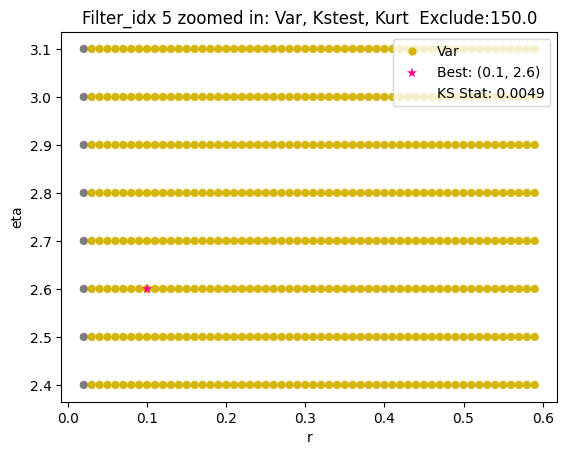

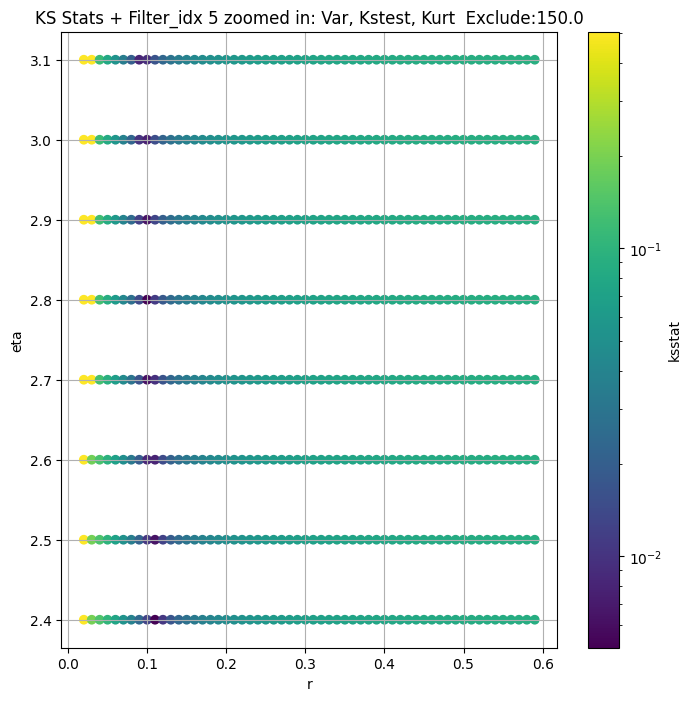

Filter_idx 6


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 200.0 + 100 = 300, ksstat: 0.0059878004615551775, var: 17.542967456775628


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 200.0 + 75 = 275, ksstat: 0.00554969229462407, var: 17.878935187965336


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 200.0 + 50 = 250, ksstat: 0.00501279389113617, var: 18.24750949633279


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 200.0 + 25 = 225, ksstat: 0.004450406778771461, var: 18.65665902300978


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 200.0 + 0 = 200, ksstat: 0.0038800757781197737, var: 19.117563429942496


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 200.0 + -25 = 175, ksstat: 0.0037169403601097772, var: 19.64716877638275


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 200.0 + -50 = 150, ksstat: 0.0036135324982486394, var: 20.271283567771295


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 200.0 + -75 = 125, ksstat: 0.0035593491958199053, var: 21.032425860985228


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 200.0 + -100 = 100, ksstat: 0.0038255377371815003, var: 22.006336296281024
Number of samples: 100000, Without approximation : 786432000.0


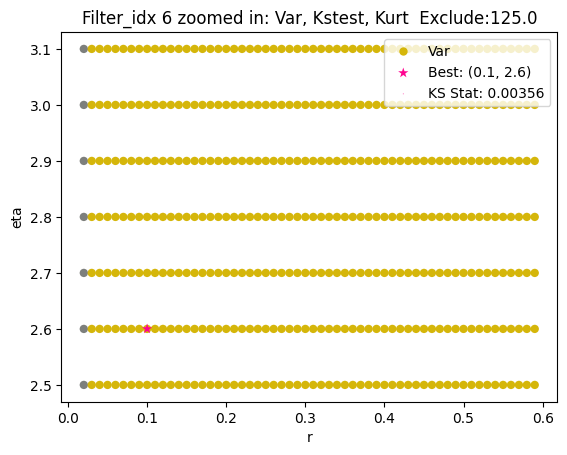

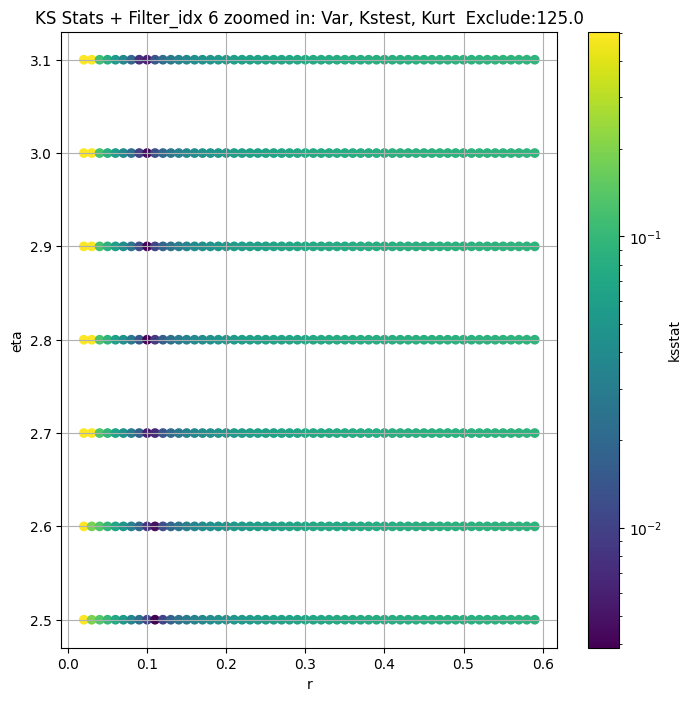

Filter_idx 7


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 7, 100.0 + 100 = 200, ksstat: 0.016453537180332378, var: 28.993049026402396


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 7, 100.0 + 75 = 175, ksstat: 0.0164639514430871, var: 29.96179843620249


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 7, 100.0 + 50 = 150, ksstat: 0.016472270784022525, var: 31.146619075968115


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 7, 100.0 + 25 = 125, ksstat: 0.01645550125470807, var: 32.648186216680074


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 7, 100.0 + 0 = 100, ksstat: 0.016450530568321853, var: 34.630676684402154


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 7, 100.0 + -25 = 75, ksstat: 0.017138507467259367, var: 37.31864452684035


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 7, 100.0 + -50 = 50, ksstat: 0.0188420385350484, var: 41.357003917731625


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 7, 100.0 + -75 = 25, ksstat: 0.022282923165979795, var: 48.66567808062126


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 7, 100.0 + -100 = 0, ksstat: 0.03110616283850992, var: 75.99259855308193
Number of samples: 100000, Without approximation : 786432000.0


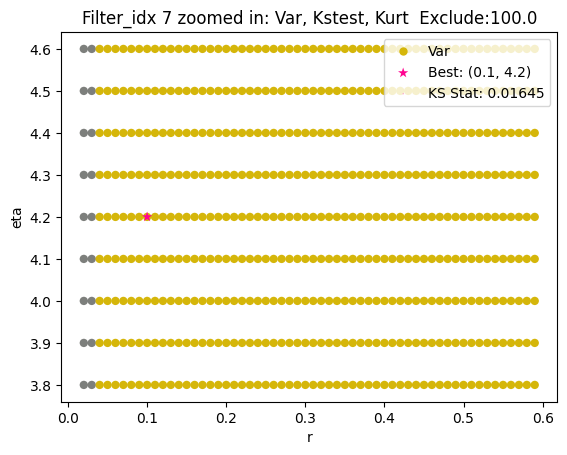

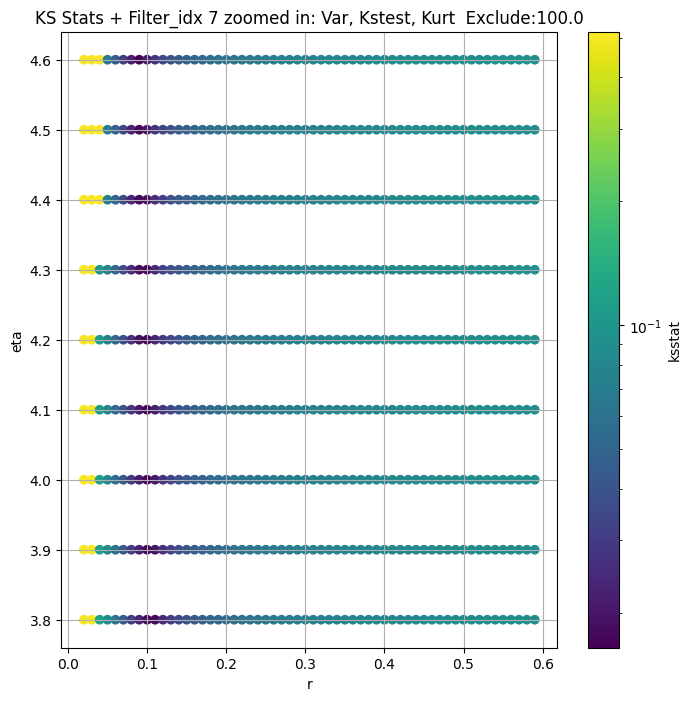

Filter_idx 8


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 200.0 + 100 = 300, ksstat: 0.019972346225037296, var: 0.5634030250704057


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 200.0 + 75 = 275, ksstat: 0.02012012514465311, var: 0.5756303658727141


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 200.0 + 50 = 250, ksstat: 0.020284070104585772, var: 0.5890866041391603


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 200.0 + 25 = 225, ksstat: 0.02064395747699249, var: 0.6040673553673029


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 200.0 + 0 = 200, ksstat: 0.020979018246261638, var: 0.6209907247602326


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 200.0 + -25 = 175, ksstat: 0.02108119185883478, var: 0.6404861181067757


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 200.0 + -50 = 150, ksstat: 0.02140279321859062, var: 0.6635249209499832


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 200.0 + -75 = 125, ksstat: 0.02203326080688467, var: 0.6917129530843668


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 200.0 + -100 = 100, ksstat: 0.022989771214944166, var: 0.7276147233432069
Number of samples: 100000, Without approximation : 786432000.0


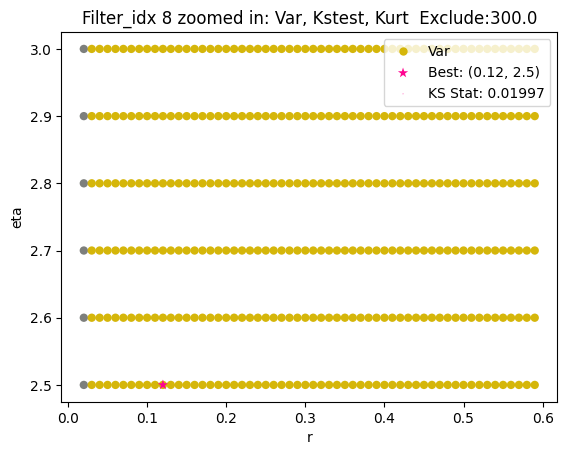

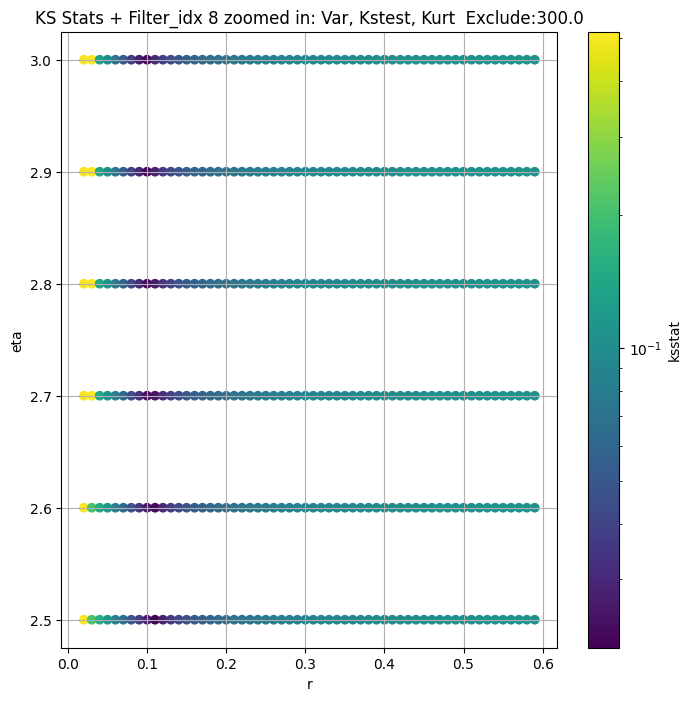

Filter_idx 9


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 9, 200.0 + 100 = 300, ksstat: 0.01113910985635469, var: 3.8880712702550846


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 9, 200.0 + 75 = 275, ksstat: 0.011098292646168073, var: 3.9914292273126812


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 9, 200.0 + 50 = 250, ksstat: 0.011296486642261794, var: 4.104530513308874


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 9, 200.0 + 25 = 225, ksstat: 0.011829960880071932, var: 4.229647586829836


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 9, 200.0 + 0 = 200, ksstat: 0.012052801683396508, var: 4.3700432919530146


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 9, 200.0 + -25 = 175, ksstat: 0.013227916260361572, var: 4.530334230067494


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 9, 200.0 + -50 = 150, ksstat: 0.013508516997319642, var: 4.717968308949613


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 9, 200.0 + -75 = 125, ksstat: 0.013404267545647497, var: 4.94527836403464


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 9, 200.0 + -100 = 100, ksstat: 0.014048573536243614, var: 5.23413641776279
Number of samples: 100000, Without approximation : 786432000.0


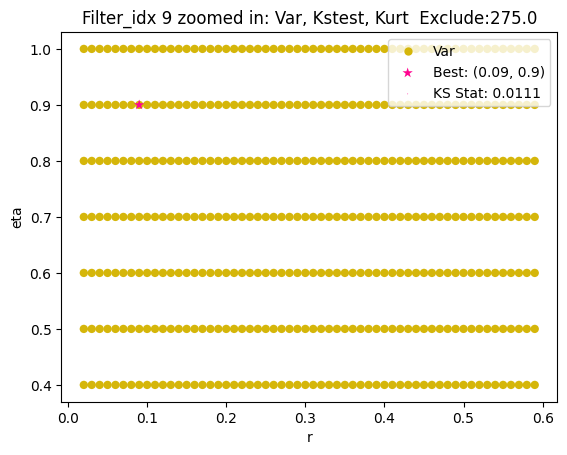

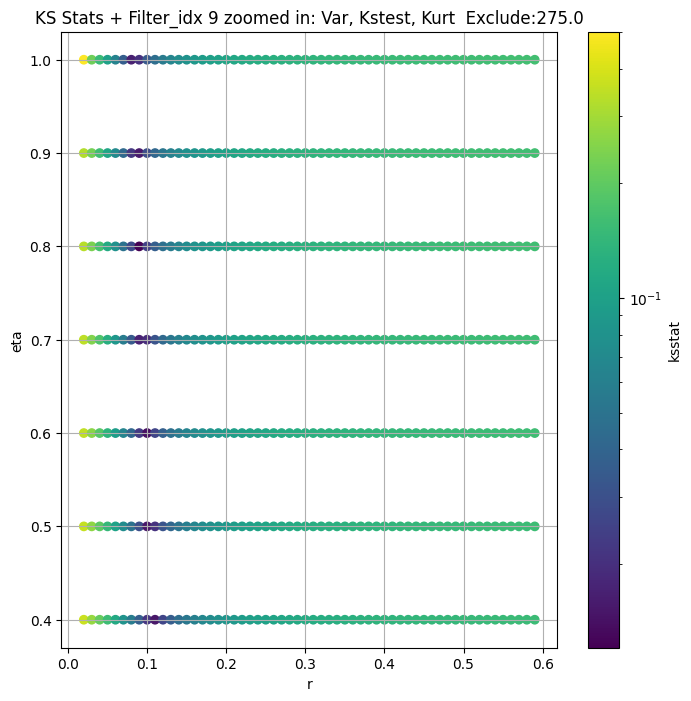

Filter_idx 10


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 10, 200.0 + 100 = 300, ksstat: 0.005374564892073861, var: 18.633202153140655


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 10, 200.0 + 75 = 275, ksstat: 0.004983041413395308, var: 19.034157835068253


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 10, 200.0 + 50 = 250, ksstat: 0.004655684475586397, var: 19.472321757016438


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 10, 200.0 + 25 = 225, ksstat: 0.004818383748880772, var: 19.955352074590603


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 10, 200.0 + 0 = 200, ksstat: 0.004661599999604582, var: 20.493682752755877


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 10, 200.0 + -25 = 175, ksstat: 0.0046802834409970795, var: 21.102080507674458


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 10, 200.0 + -50 = 150, ksstat: 0.004660982403238617, var: 21.802316614727278


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 10, 200.0 + -75 = 125, ksstat: 0.0052301025789586175, var: 22.62999963098011


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 10, 200.0 + -100 = 100, ksstat: 0.006245913905580519, var: 23.649530837765166
Number of samples: 100000, Without approximation : 786432000.0


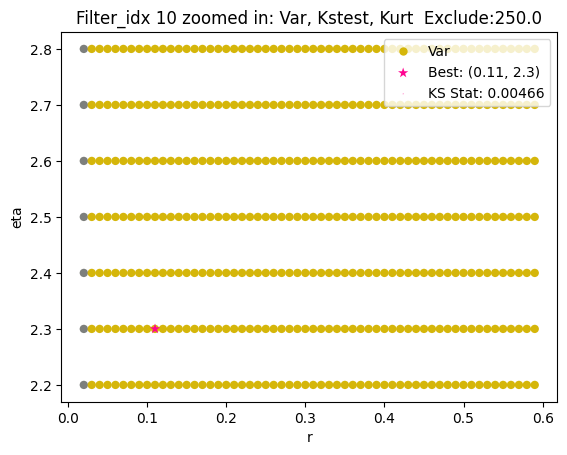

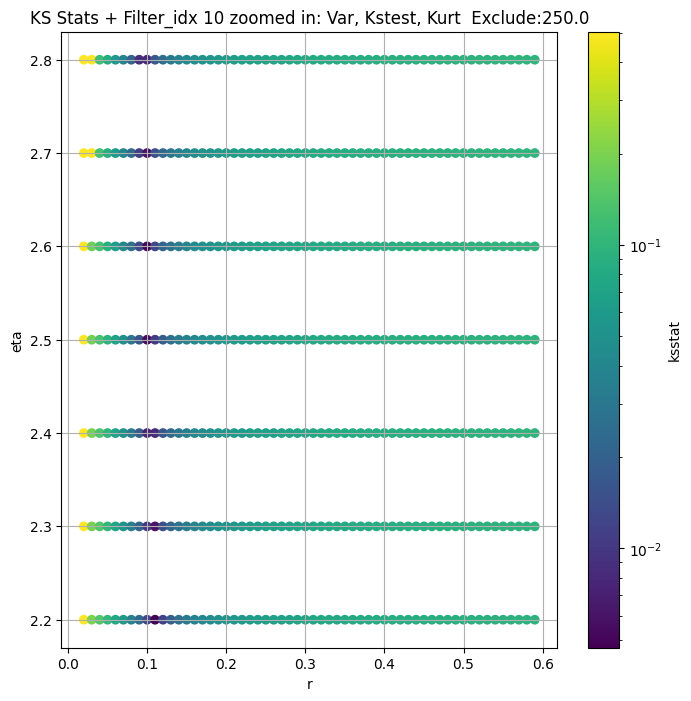

Filter_idx 11


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 11, 100.0 + 100 = 200, ksstat: 0.004745015260047447, var: 18.641015521750987


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 11, 100.0 + 75 = 175, ksstat: 0.004180349712193943, var: 19.177502520289305


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 11, 100.0 + 50 = 150, ksstat: 0.0036114444649902877, var: 19.801486060302135


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 11, 100.0 + 25 = 125, ksstat: 0.0033241168059177095, var: 20.551202263356757


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 11, 100.0 + 0 = 100, ksstat: 0.0036304211385079777, var: 21.497739434390102


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 11, 100.0 + -25 = 75, ksstat: 0.003985474189579674, var: 22.78630383126976


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 11, 100.0 + -50 = 50, ksstat: 0.005467044975058677, var: 24.75181737625767


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 11, 100.0 + -75 = 25, ksstat: 0.007906836070870615, var: 28.374899158424764


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 11, 100.0 + -100 = 0, ksstat: 0.018188196520389333, var: 53.67341820575869
Number of samples: 100000, Without approximation : 786432000.0


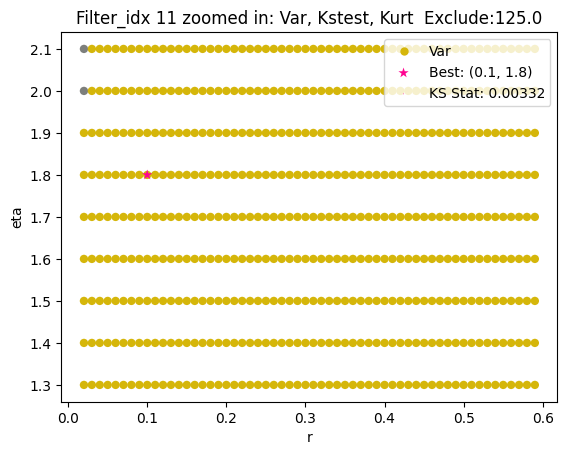

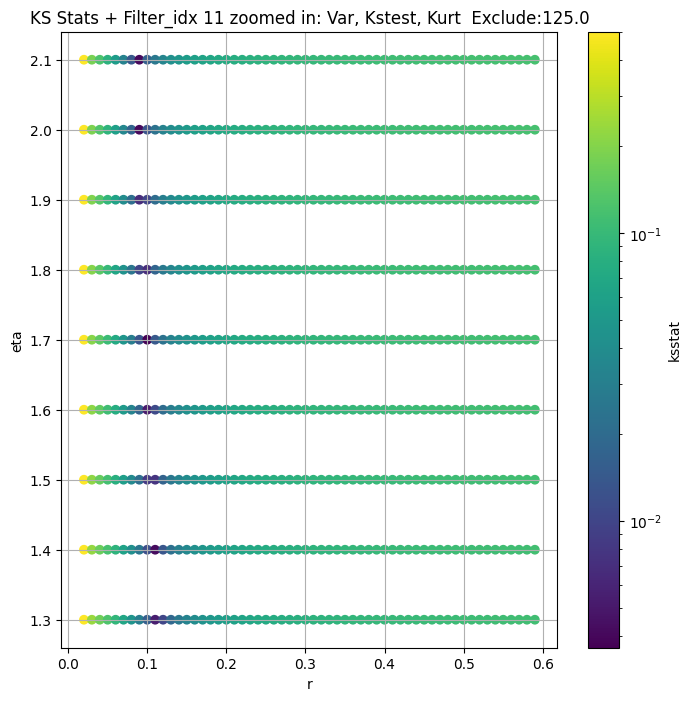

Filter_idx 12


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 200.0 + 100 = 300, ksstat: 0.006540477042389026, var: 14.628106799122229


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 200.0 + 75 = 275, ksstat: 0.006251421073445618, var: 14.95104059457926


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 200.0 + 50 = 250, ksstat: 0.005873037669876624, var: 15.301517701643178


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 200.0 + 25 = 225, ksstat: 0.006606240938337227, var: 15.68525110647398


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 200.0 + 0 = 200, ksstat: 0.006981399898908114, var: 16.110176850394517


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 200.0 + -25 = 175, ksstat: 0.007086177501148594, var: 16.587611808054266


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 200.0 + -50 = 150, ksstat: 0.007432973676357479, var: 17.13518594775264


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 200.0 + -75 = 125, ksstat: 0.008204056853468478, var: 17.781461453047402


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 200.0 + -100 = 100, ksstat: 0.00885640949725075, var: 18.57782441250133
Number of samples: 100000, Without approximation : 786432000.0


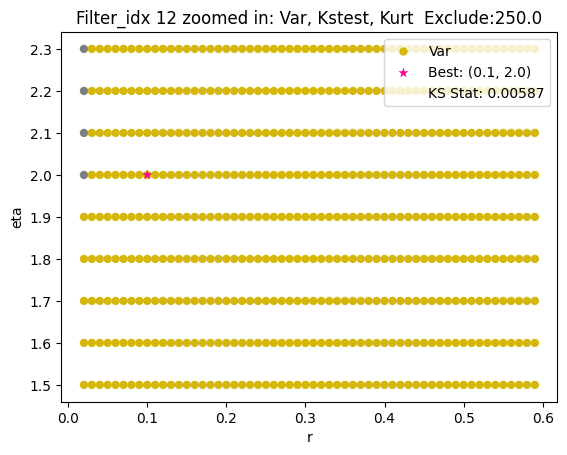

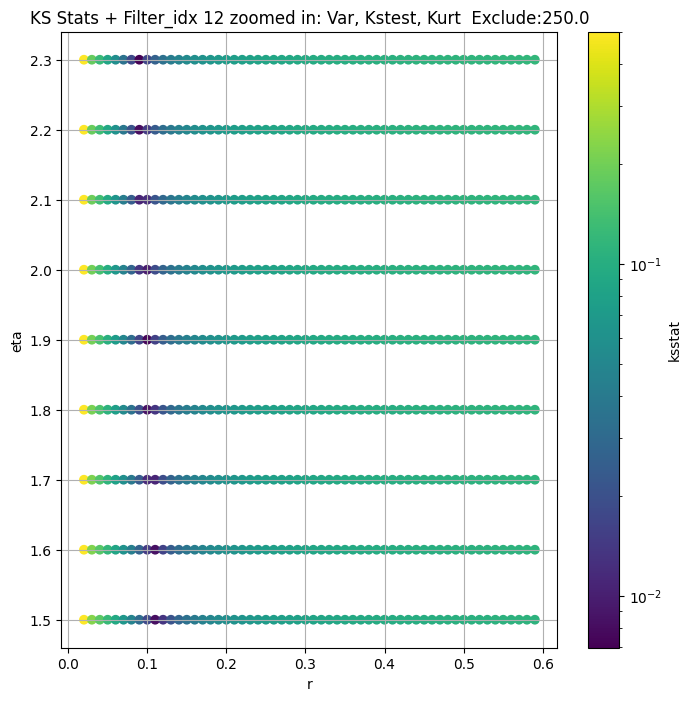

Filter_idx 13


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 200.0 + 100 = 300, ksstat: 0.005010714132108296, var: 20.312740061922852


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 200.0 + 75 = 275, ksstat: 0.004619324156944549, var: 20.821799999007254


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 200.0 + 50 = 250, ksstat: 0.004224538740650208, var: 21.38443634884746


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 200.0 + 25 = 225, ksstat: 0.0038419288759971026, var: 22.01274847919987


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 200.0 + 0 = 200, ksstat: 0.004291653859625044, var: 22.722854198389527


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 200.0 + -25 = 175, ksstat: 0.0048100646214581655, var: 23.537279612394617


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 200.0 + -50 = 150, ksstat: 0.005302648951915068, var: 24.488983921266854


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 200.0 + -75 = 125, ksstat: 0.006647695637464812, var: 25.627624231963043


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 200.0 + -100 = 100, ksstat: 0.006913258076045592, var: 27.032433487537677
Number of samples: 100000, Without approximation : 786432000.0


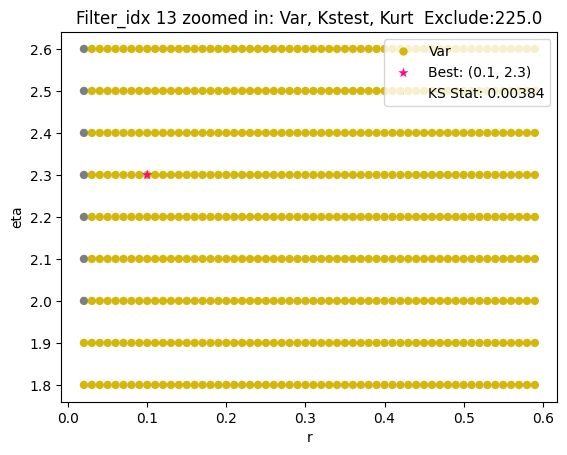

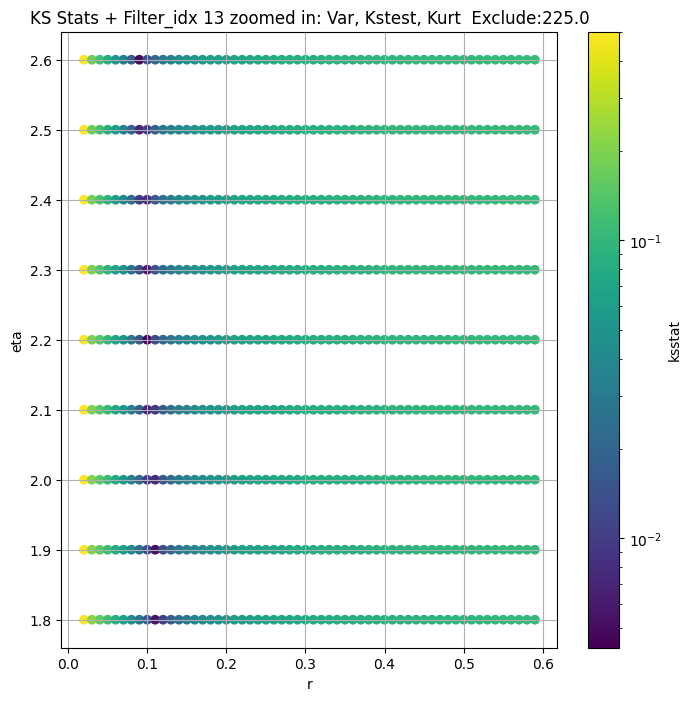

Filter_idx 14


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 14, 200.0 + 100 = 300, ksstat: 0.005858568086597522, var: 25.33567375283668


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 14, 200.0 + 75 = 275, ksstat: 0.005509789507772367, var: 25.88960252128318


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 14, 200.0 + 50 = 250, ksstat: 0.005038333750302437, var: 26.494031587751476


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 14, 200.0 + 25 = 225, ksstat: 0.0047632904986086855, var: 27.15978361129888


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 14, 200.0 + 0 = 200, ksstat: 0.0048207384877272386, var: 27.90174399924602


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 14, 200.0 + -25 = 175, ksstat: 0.004667332539958213, var: 28.74039996680351


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 14, 200.0 + -50 = 150, ksstat: 0.004884757330079648, var: 29.706078475089566


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 14, 200.0 + -75 = 125, ksstat: 0.004720715792991936, var: 30.84591211295911


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 14, 200.0 + -100 = 100, ksstat: 0.005182798933054816, var: 32.24016532927623
Number of samples: 100000, Without approximation : 786432000.0


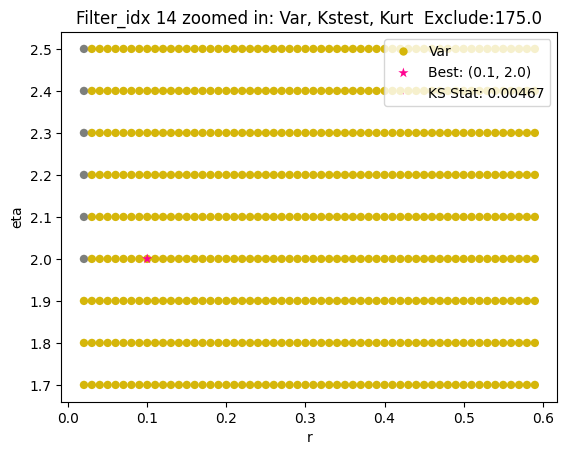

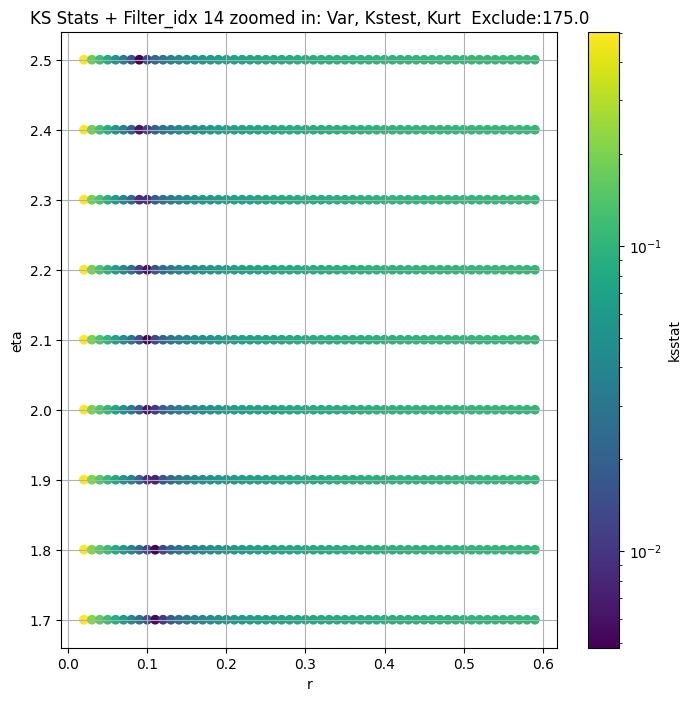

Filter_idx 15


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 15, 200.0 + 100 = 300, ksstat: 0.00802282350999206, var: 24.308220783012732


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 15, 200.0 + 75 = 275, ksstat: 0.008172193619207513, var: 24.746186956863863


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 15, 200.0 + 50 = 250, ksstat: 0.008747506731259097, var: 25.239044995013433


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 15, 200.0 + 25 = 225, ksstat: 0.00904865904440455, var: 25.802423681417242


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 15, 200.0 + 0 = 200, ksstat: 0.009634238028011666, var: 26.450519839269703


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 15, 200.0 + -25 = 175, ksstat: 0.010223190139981339, var: 27.216023290881818


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 15, 200.0 + -50 = 150, ksstat: 0.011017806298296073, var: 28.140680063359216


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 15, 200.0 + -75 = 125, ksstat: 0.012551080997226793, var: 29.28433245707155


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 15, 200.0 + -100 = 100, ksstat: 0.013325762053056245, var: 30.76009367585572
Number of samples: 100000, Without approximation : 786432000.0


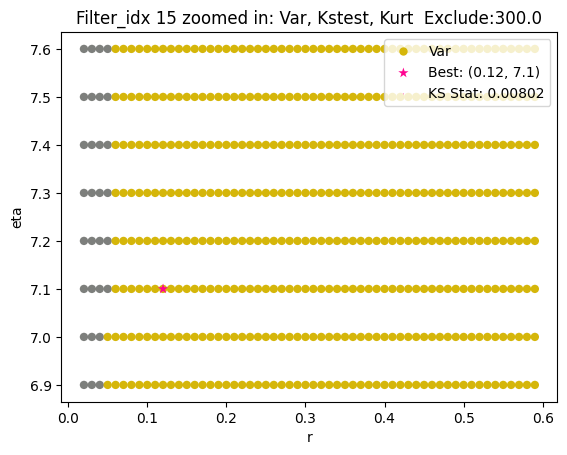

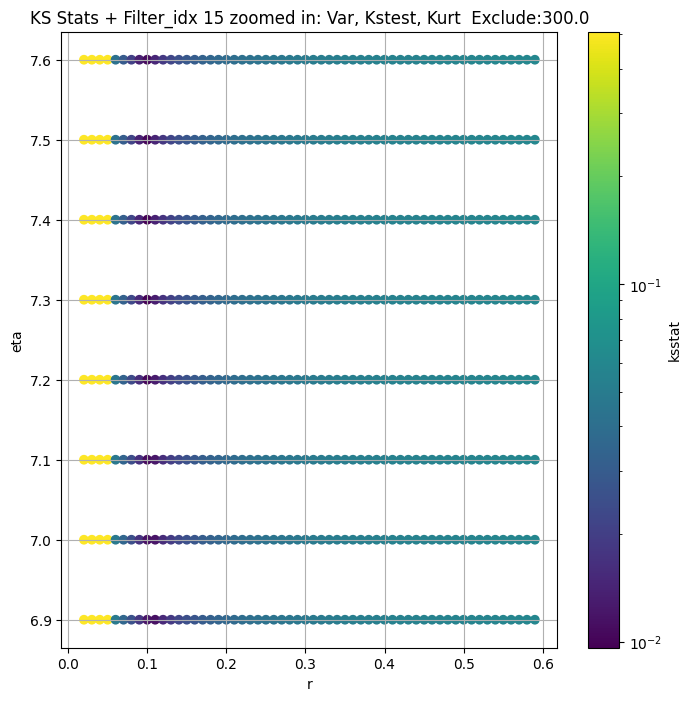

Filter_idx 16


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 16, 200.0 + 100 = 300, ksstat: 0.0063413084130649056, var: 12.908254679273734


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 16, 200.0 + 75 = 275, ksstat: 0.005992761225832921, var: 13.210791829521218


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 16, 200.0 + 50 = 250, ksstat: 0.0067149670434998865, var: 13.539415214441446


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 16, 200.0 + 25 = 225, ksstat: 0.00708192066280014, var: 13.899409044002304


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 16, 200.0 + 0 = 200, ksstat: 0.006931130223841397, var: 14.297907458236338


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 16, 200.0 + -25 = 175, ksstat: 0.0074228616987046525, var: 14.744902195697469


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 16, 200.0 + -50 = 150, ksstat: 0.00846862172509577, var: 15.255332101906125


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 16, 200.0 + -75 = 125, ksstat: 0.009449424154461428, var: 15.852178335754472


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 16, 200.0 + -100 = 100, ksstat: 0.010159583966626431, var: 16.574839813887863
Number of samples: 100000, Without approximation : 786432000.0


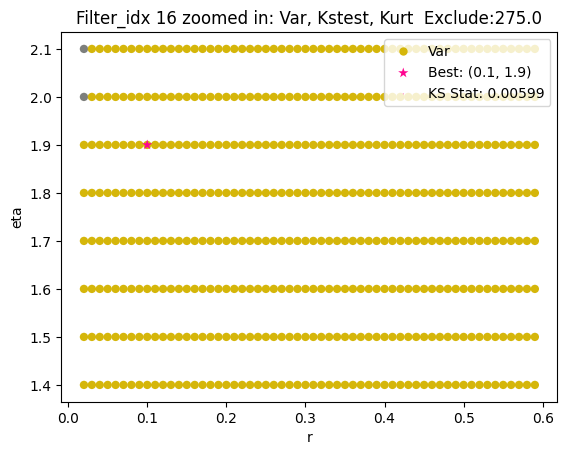

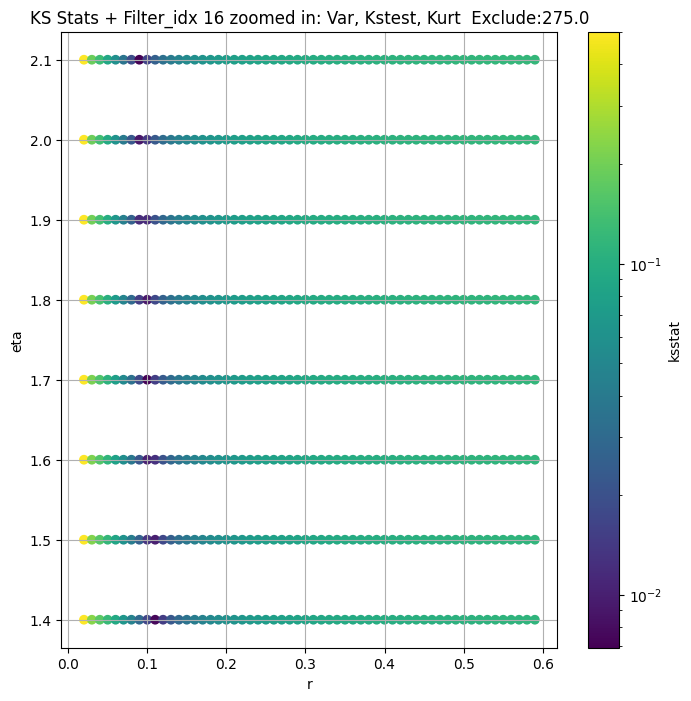

Filter_idx 17


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 17, 50.0 + 100 = 150, ksstat: 0.006089203830758477, var: 17.993599182009763


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 17, 50.0 + 75 = 125, ksstat: 0.0053616608923247044, var: 18.746034074317357


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 17, 50.0 + 50 = 100, ksstat: 0.0036795068102013495, var: 19.712127847432086


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 17, 50.0 + 25 = 75, ksstat: 0.0027352082211452577, var: 21.032146303127885


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 17, 50.0 + 0 = 50, ksstat: 0.00263801929965235, var: 23.020868371333073


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 17, 50.0 + -25 = 25, ksstat: 0.004046312773617555, var: 26.634936043394916


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 17, 50.0 + -50 = 0, ksstat: 0.017023934560373877, var: 57.8736243530338
Number of samples: 100000, Without approximation : 786432000.0


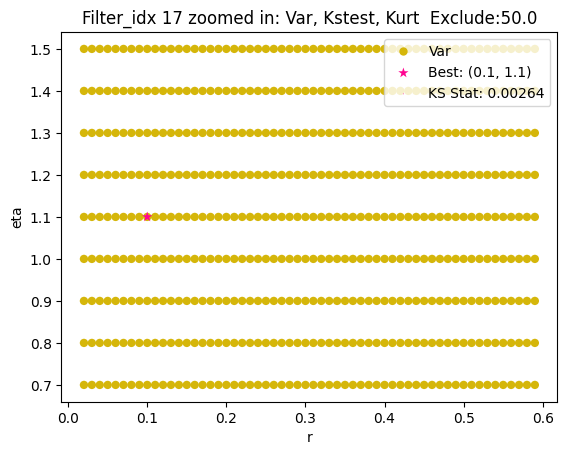

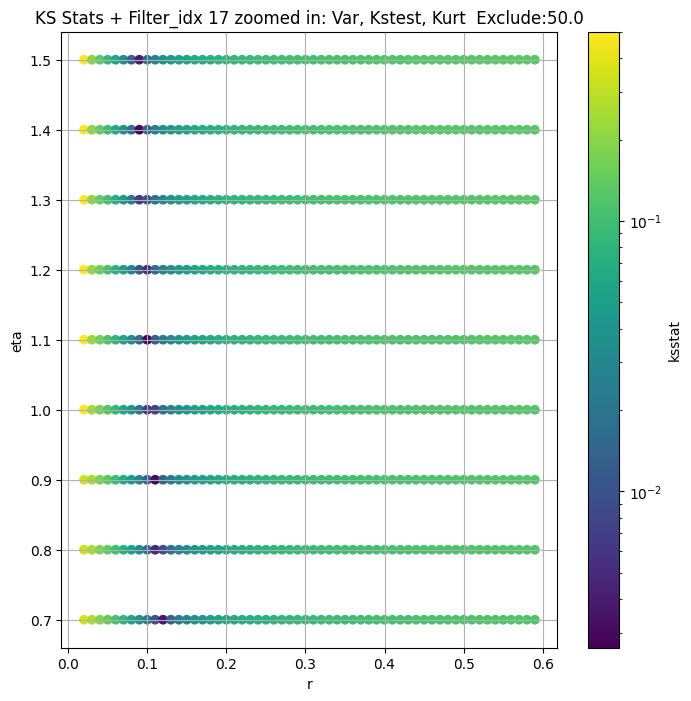

Filter_idx 18


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 18, 200.0 + 100 = 300, ksstat: 0.007360665472461836, var: 10.411772570118433


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 18, 200.0 + 75 = 275, ksstat: 0.00807033949567737, var: 10.653247677954145


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 18, 200.0 + 50 = 250, ksstat: 0.008046249662352567, var: 10.914296036173168


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 18, 200.0 + 25 = 225, ksstat: 0.008071055108360148, var: 11.198780911227562


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 18, 200.0 + 0 = 200, ksstat: 0.008690210252038089, var: 11.511939327853758


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 18, 200.0 + -25 = 175, ksstat: 0.009586130030435291, var: 11.861212910523001


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 18, 200.0 + -50 = 150, ksstat: 0.009223277719666467, var: 12.257720587406835


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 18, 200.0 + -75 = 125, ksstat: 0.01016688460107984, var: 12.719438320486136


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 18, 200.0 + -100 = 100, ksstat: 0.011192912515065878, var: 13.277919494351762
Number of samples: 100000, Without approximation : 786432000.0


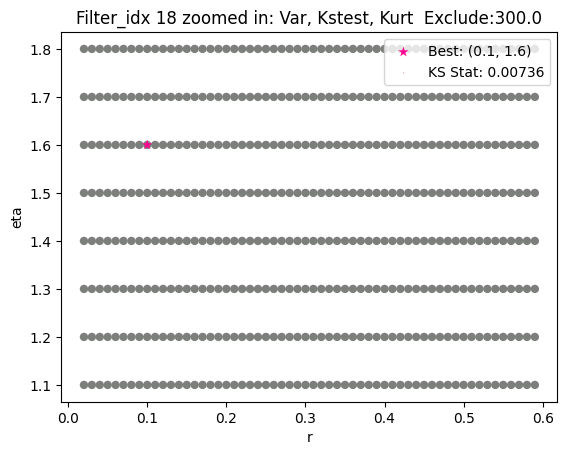

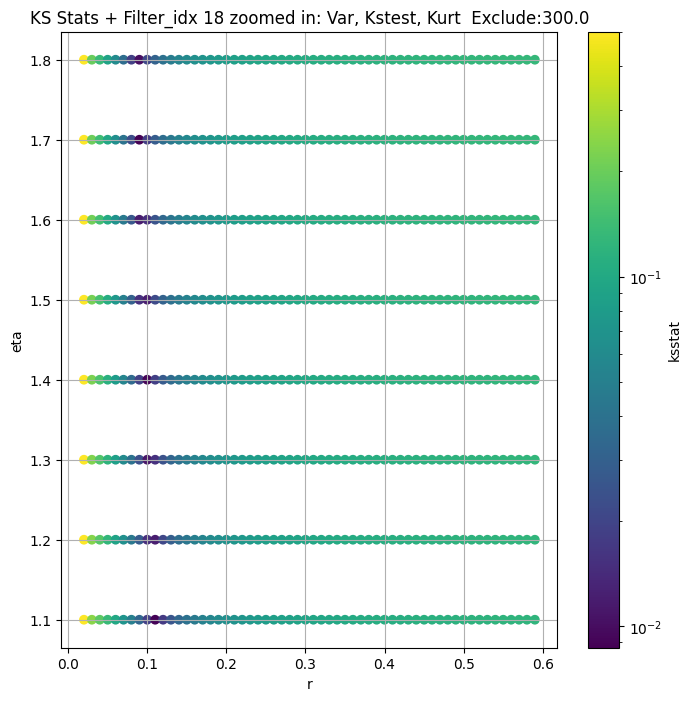

Filter_idx 19


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 19, 200.0 + 100 = 300, ksstat: 0.015344904407777471, var: 50.825906891017915


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 19, 200.0 + 75 = 275, ksstat: 0.015267644277195569, var: 51.91212176069903


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 19, 200.0 + 50 = 250, ksstat: 0.015445487366021582, var: 53.12351333139204


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 19, 200.0 + 25 = 225, ksstat: 0.015352613301173546, var: 54.502058420367106


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 19, 200.0 + 0 = 200, ksstat: 0.015614264293850488, var: 56.08460570867921


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 19, 200.0 + -25 = 175, ksstat: 0.015251485054842806, var: 57.87973847889756


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 19, 200.0 + -50 = 150, ksstat: 0.015623432597599463, var: 60.004776432162025


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 19, 200.0 + -75 = 125, ksstat: 0.015533814623450382, var: 62.589596775874185


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 19, 200.0 + -100 = 100, ksstat: 0.015789444176484535, var: 65.83664960552773
Number of samples: 100000, Without approximation : 786432000.0


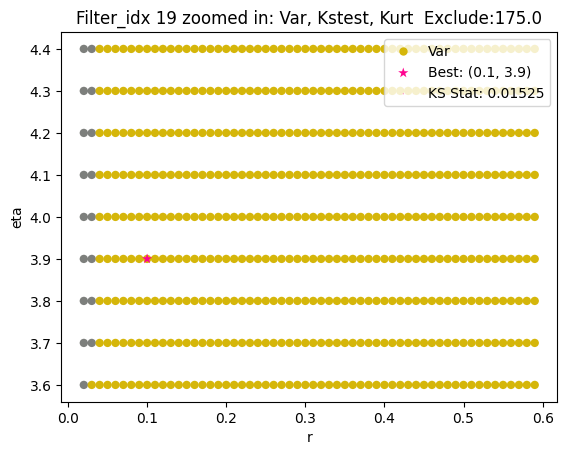

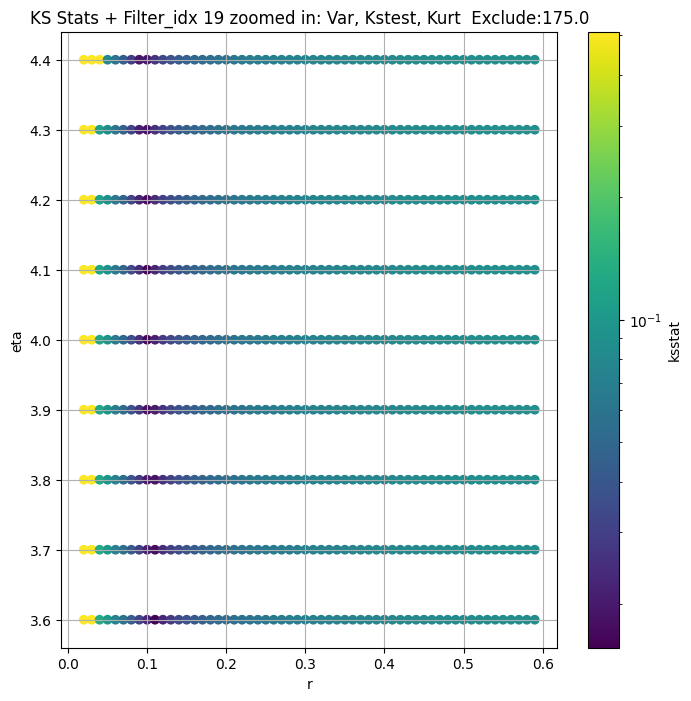

Filter_idx 20


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 200.0 + 100 = 300, ksstat: 0.0052407753050800684, var: 76.08662301781374


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 200.0 + 75 = 275, ksstat: 0.004775724644842799, var: 77.74113823305278


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 200.0 + 50 = 250, ksstat: 0.004297122343436589, var: 79.57172023976075


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 200.0 + 25 = 225, ksstat: 0.0038423030417570163, var: 81.6228529210518


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 200.0 + 0 = 200, ksstat: 0.0033224625776405604, var: 83.95780361661674


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 200.0 + -25 = 175, ksstat: 0.0028446744079380967, var: 86.66468996196316


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 200.0 + -50 = 150, ksstat: 0.0023957261874697246, var: 89.87247210117368


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 200.0 + -75 = 125, ksstat: 0.003325550877722794, var: 93.78428321111113


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 20, 200.0 + -100 = 100, ksstat: 0.0047430928290765895, var: 98.7296074365915
Number of samples: 100000, Without approximation : 786432000.0


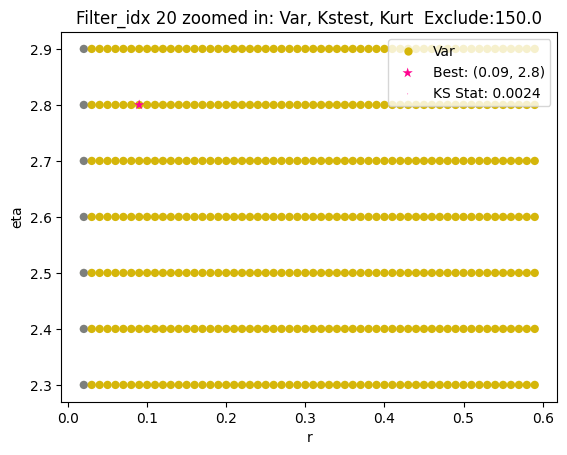

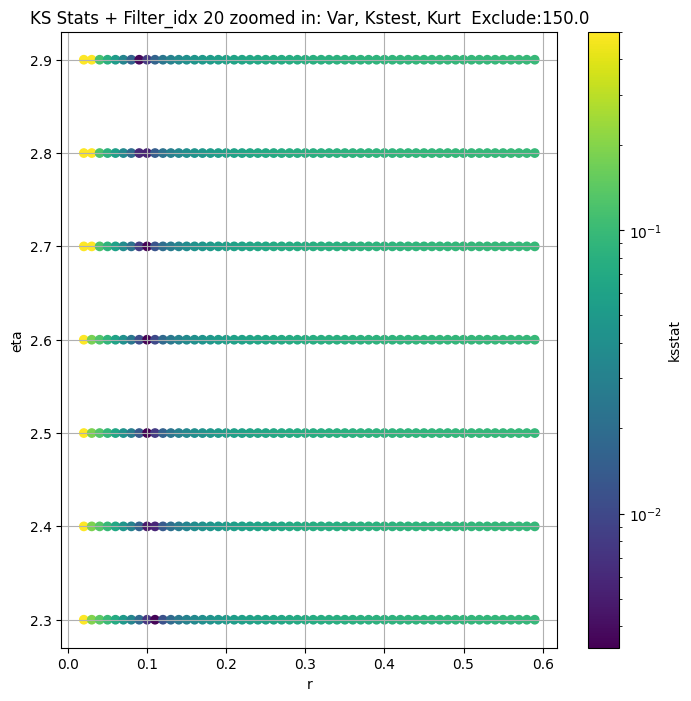

Filter_idx 21


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 21, 200.0 + 100 = 300, ksstat: 0.030724408942952863, var: 133.941647166907


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 21, 200.0 + 75 = 275, ksstat: 0.03072956053192244, var: 136.6052902235853


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 21, 200.0 + 50 = 250, ksstat: 0.030724598087943977, var: 139.60871370711504


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 21, 200.0 + 25 = 225, ksstat: 0.030724069181433222, var: 143.01067546101154


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 21, 200.0 + 0 = 200, ksstat: 0.030722914769347742, var: 146.92050825141536


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 21, 200.0 + -25 = 175, ksstat: 0.030723886682483104, var: 151.5201190577246


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 21, 200.0 + -50 = 150, ksstat: 0.030724780637995386, var: 157.02052860254372


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 21, 200.0 + -75 = 125, ksstat: 0.03073017851954818, var: 163.75360241706124


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 21, 200.0 + -100 = 100, ksstat: 0.030729379013649694, var: 172.30869204313527
Number of samples: 100000, Without approximation : 786432000.0


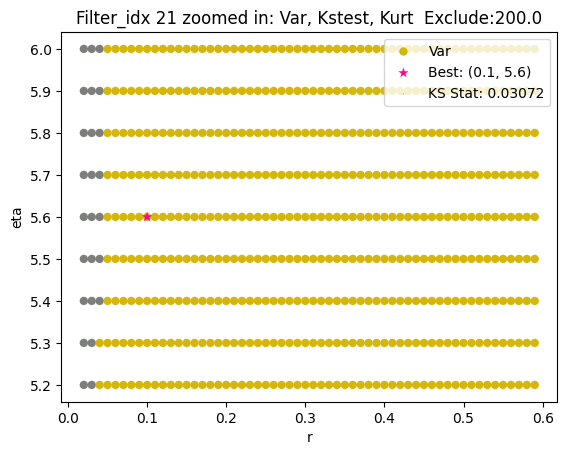

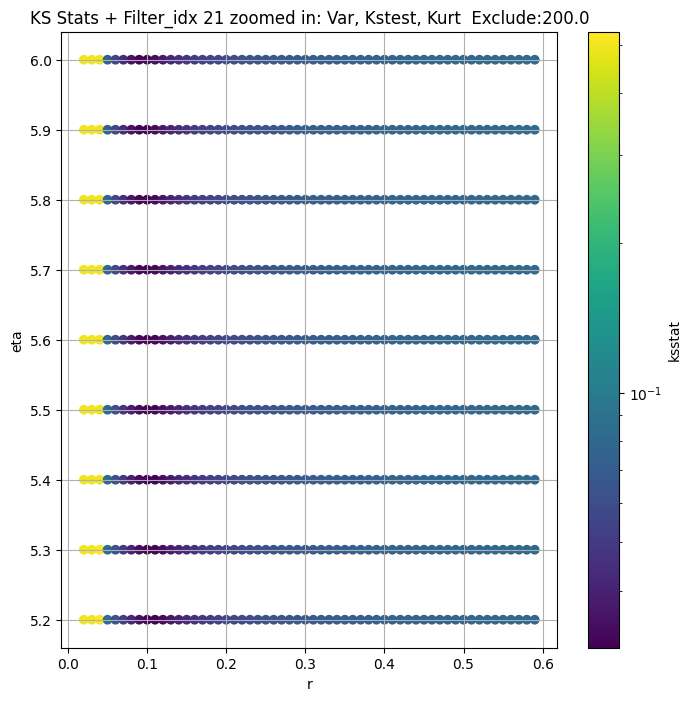

Filter_idx 22


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 22, 200.0 + 100 = 300, ksstat: 0.004816798860726931, var: 16.998151017107386


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 22, 200.0 + 75 = 275, ksstat: 0.00442961691908501, var: 17.51086742290061


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 22, 200.0 + 50 = 250, ksstat: 0.0050571638726275014, var: 18.084393050224477


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 22, 200.0 + 25 = 225, ksstat: 0.005640986889597854, var: 18.733872132866388


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 22, 200.0 + 0 = 200, ksstat: 0.006310482885890423, var: 19.480548533840793


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 22, 200.0 + -25 = 175, ksstat: 0.006875397634580005, var: 20.354966356928568


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 22, 200.0 + -50 = 150, ksstat: 0.007283742561421447, var: 21.40064201936135


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 22, 200.0 + -75 = 125, ksstat: 0.00795345630843719, var: 22.68177994956194


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 22, 200.0 + -100 = 100, ksstat: 0.010443685299696984, var: 24.293058560690984
Number of samples: 100000, Without approximation : 786432000.0


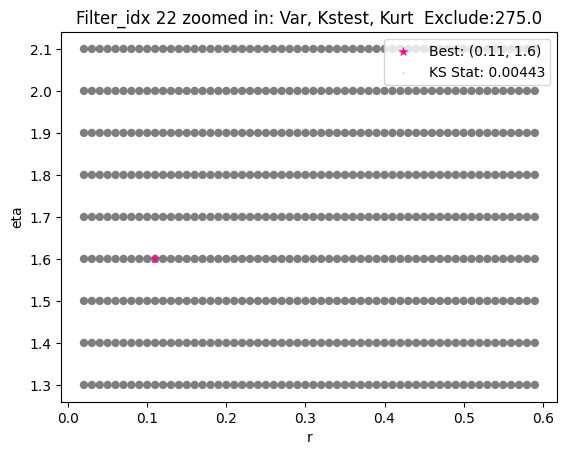

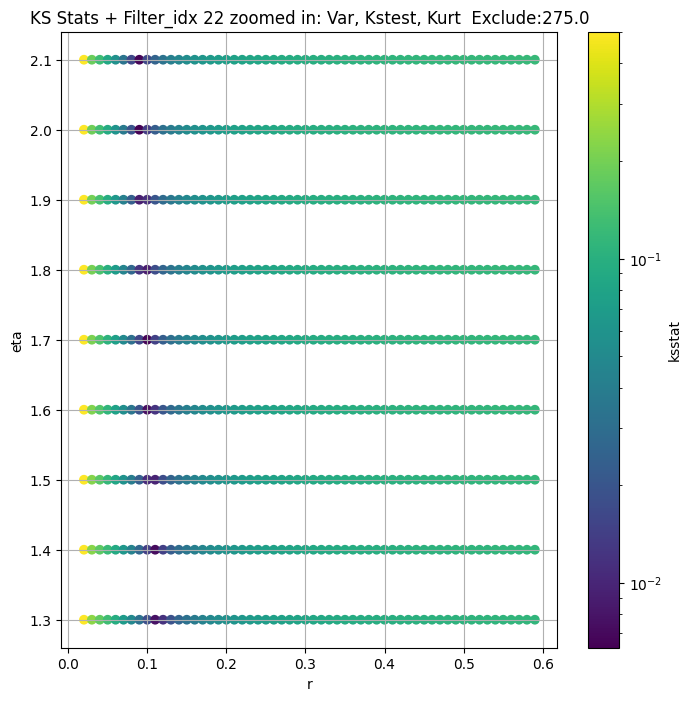

Filter_idx 23


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 23, 200.0 + 100 = 300, ksstat: 0.007638563756285133, var: 26.705728352143957


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 23, 200.0 + 75 = 275, ksstat: 0.007293716514455428, var: 27.312486428790553


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 23, 200.0 + 50 = 250, ksstat: 0.006493003955950538, var: 27.9802673950991


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 23, 200.0 + 25 = 225, ksstat: 0.006061001189499149, var: 28.724500976553237


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 23, 200.0 + 0 = 200, ksstat: 0.005537385530355765, var: 29.56688017422593


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 23, 200.0 + -25 = 175, ksstat: 0.004942373366862873, var: 30.542146633492816


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 23, 200.0 + -50 = 150, ksstat: 0.004352000253866617, var: 31.708068856929962


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 23, 200.0 + -75 = 125, ksstat: 0.003836066413315964, var: 33.17355216528944


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 23, 200.0 + -100 = 100, ksstat: 0.004285345310062416, var: 35.16867194070638
Number of samples: 100000, Without approximation : 786432000.0


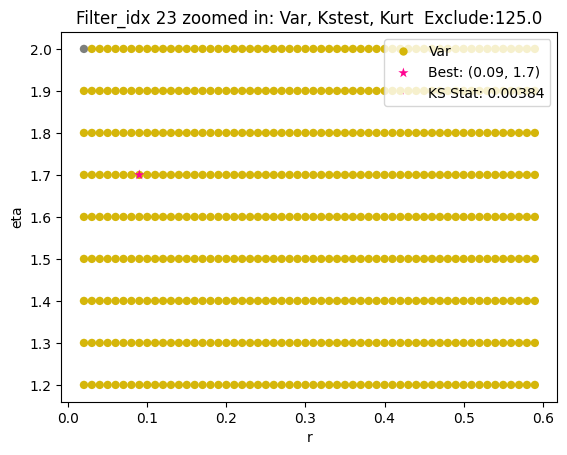

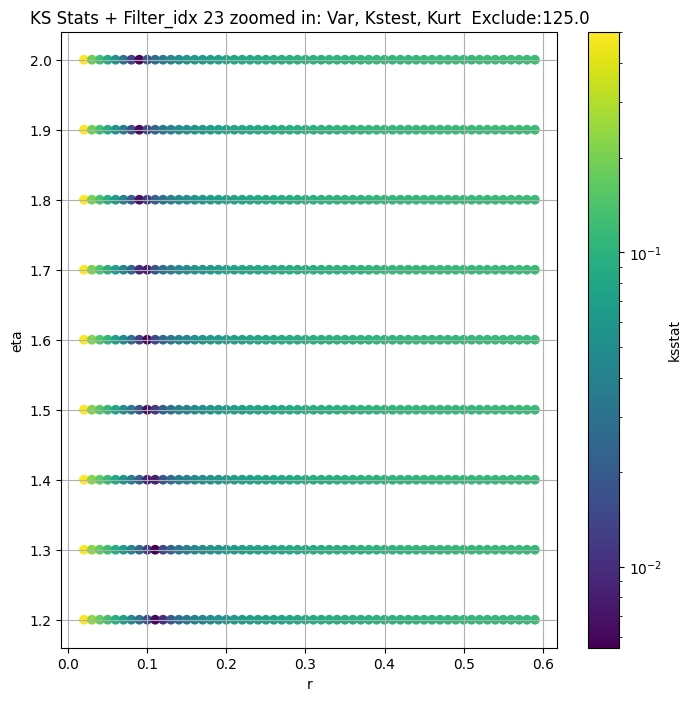

Filter_idx 24


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 200.0 + 100 = 300, ksstat: 0.01038169292233071, var: 18.123745819857906


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 200.0 + 75 = 275, ksstat: 0.010985658236802087, var: 18.638210126142276


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 200.0 + 50 = 250, ksstat: 0.01007500614300863, var: 19.2123686090224


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 200.0 + 25 = 225, ksstat: 0.011738941920074908, var: 19.862350687018072


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 200.0 + 0 = 200, ksstat: 0.011502051445647754, var: 20.611231289646003


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 200.0 + -25 = 175, ksstat: 0.012069565698883733, var: 21.49365775318994


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 200.0 + -50 = 150, ksstat: 0.013874276472639058, var: 22.561402240836312


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 200.0 + -75 = 125, ksstat: 0.012953952972931448, var: 23.89600289322928


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 200.0 + -100 = 100, ksstat: 0.013767624503134401, var: 25.626395828560433
Number of samples: 100000, Without approximation : 786432000.0


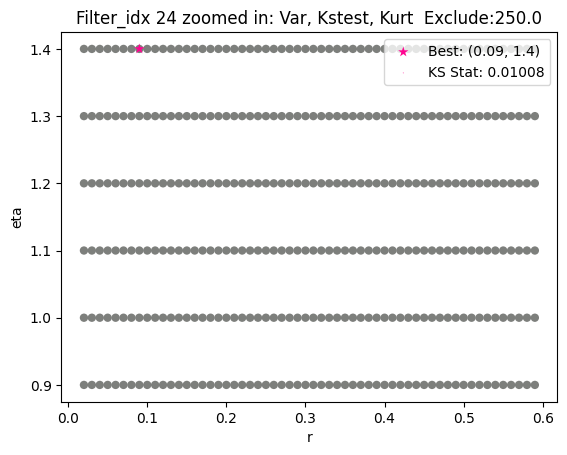

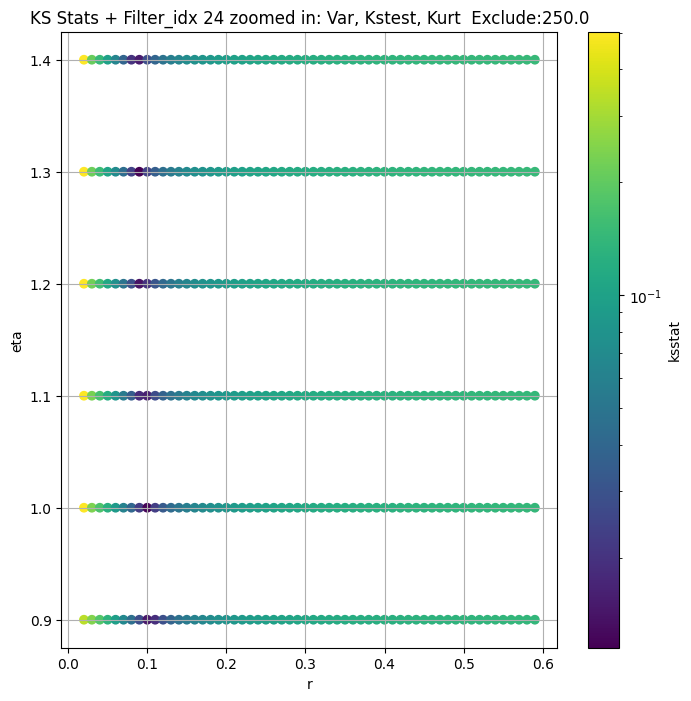

Filter_idx 25


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 25, 200.0 + 100 = 300, ksstat: 0.006321356367602338, var: 5.574669190769701


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 25, 200.0 + 75 = 275, ksstat: 0.007617344333389842, var: 5.760327630374262


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 25, 200.0 + 50 = 250, ksstat: 0.008685316730119963, var: 5.967212315948648


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 25, 200.0 + 25 = 225, ksstat: 0.008423470300264524, var: 6.199880547062192


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 25, 200.0 + 0 = 200, ksstat: 0.0090941949100245, var: 6.4641386254829305


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 25, 200.0 + -25 = 175, ksstat: 0.010196888099899992, var: 6.767679154201596


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 25, 200.0 + -50 = 150, ksstat: 0.011637733816662443, var: 7.1210613413618455


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 25, 200.0 + -75 = 125, ksstat: 0.01168477909567378, var: 7.539585986623567


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 25, 200.0 + -100 = 100, ksstat: 0.012152250148041444, var: 8.046451450273349
Number of samples: 100000, Without approximation : 786432000.0


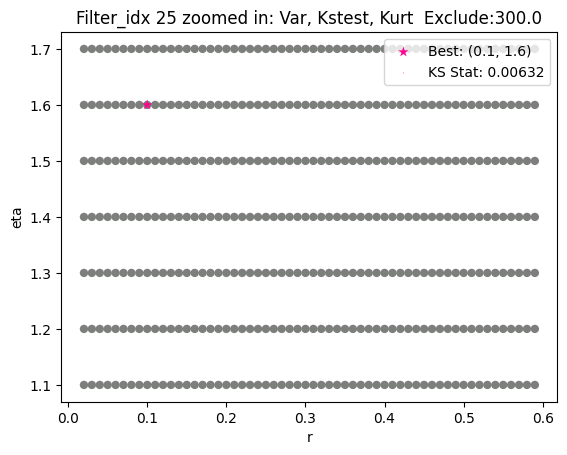

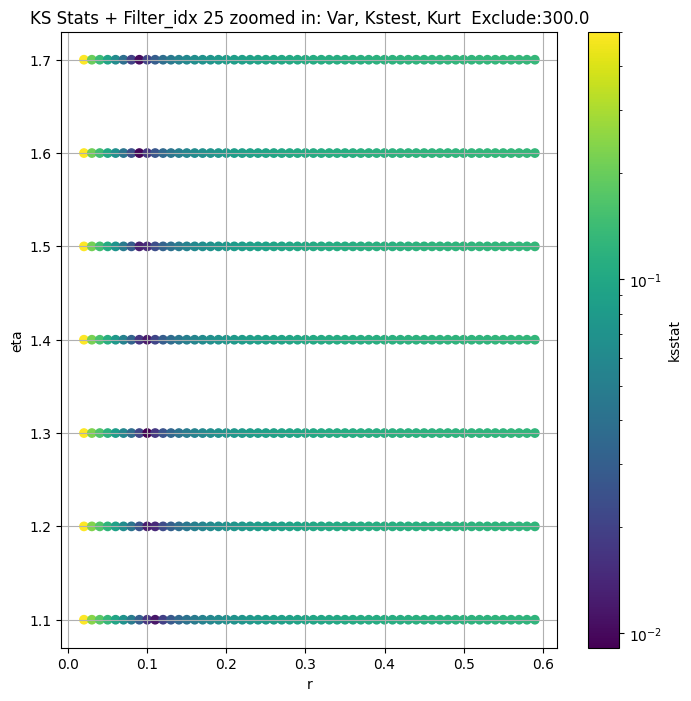

Filter_idx 26


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 100.0 + 100 = 200, ksstat: 0.005468695638838783, var: 17.59831114489898


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 100.0 + 75 = 175, ksstat: 0.005561802919494707, var: 18.09408783700454


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 100.0 + 50 = 150, ksstat: 0.005490271552132997, var: 18.679450194427666


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 100.0 + 25 = 125, ksstat: 0.005440601193703487, var: 19.394805250555354


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 100.0 + 0 = 100, ksstat: 0.005439559080045453, var: 20.31105177870647


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 100.0 + -25 = 75, ksstat: 0.006026122290277214, var: 21.56683688249198


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 100.0 + -50 = 50, ksstat: 0.007294120228513112, var: 23.463038273577368


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 100.0 + -75 = 25, ksstat: 0.010482904397723286, var: 26.842635897022316


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 100.0 + -100 = 0, ksstat: 0.021804152054723025, var: 48.59658404214989
Number of samples: 100000, Without approximation : 786432000.0


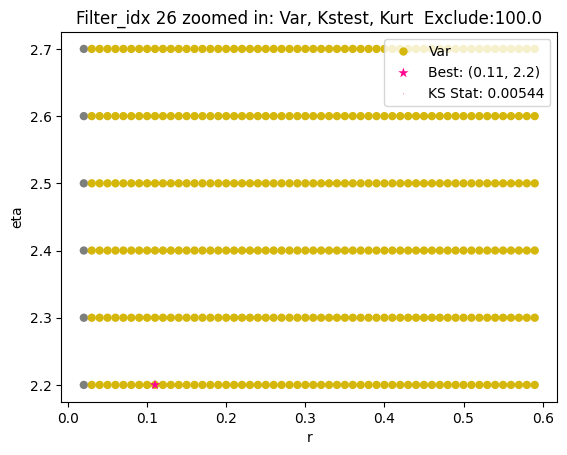

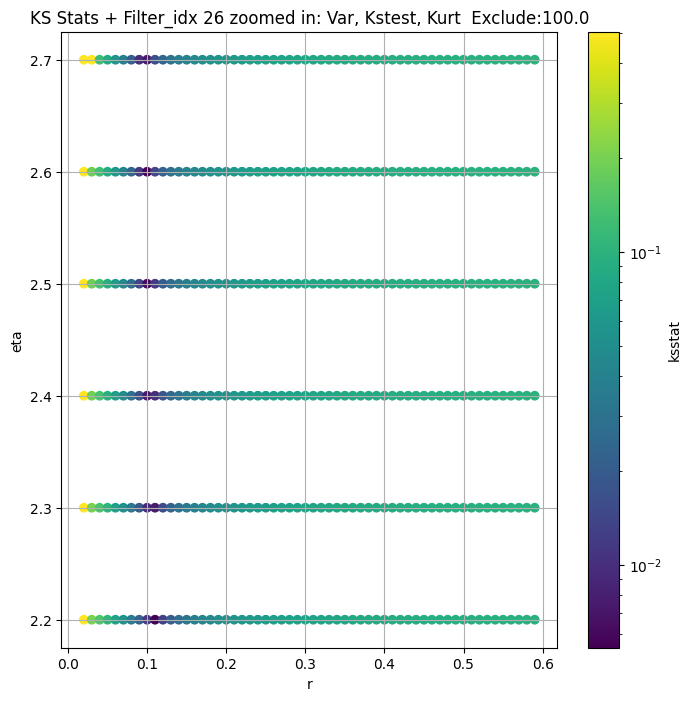

Filter_idx 27


  0%|          | 0/567 [00:00<?, ?it/s]

Finding Minimum after computing 567 CDFs
filter_idx 27, 200.0 + 100 = 300, ksstat: 0.012658543382068121, var: 4.617526665210206


  0%|          | 0/567 [00:00<?, ?it/s]

Finding Minimum after computing 567 CDFs
filter_idx 27, 200.0 + 75 = 275, ksstat: 0.011999263873778199, var: 4.741696116962508


  0%|          | 0/567 [00:00<?, ?it/s]

Finding Minimum after computing 567 CDFs
filter_idx 27, 200.0 + 50 = 250, ksstat: 0.0134100306370869, var: 4.877094251863558


  0%|          | 0/567 [00:00<?, ?it/s]

Finding Minimum after computing 567 CDFs
filter_idx 27, 200.0 + 25 = 225, ksstat: 0.013665492229255283, var: 5.026166597150822


  0%|          | 0/567 [00:00<?, ?it/s]

Finding Minimum after computing 567 CDFs
filter_idx 27, 200.0 + 0 = 200, ksstat: 0.01367020652892642, var: 5.192249953782891


  0%|          | 0/567 [00:00<?, ?it/s]

Finding Minimum after computing 567 CDFs
filter_idx 27, 200.0 + -25 = 175, ksstat: 0.01442865224388204, var: 5.379970681914404


  0%|          | 0/567 [00:00<?, ?it/s]

Finding Minimum after computing 567 CDFs
filter_idx 27, 200.0 + -50 = 150, ksstat: 0.014639051214733856, var: 5.596433101262203


  0%|          | 0/567 [00:00<?, ?it/s]

Finding Minimum after computing 567 CDFs
filter_idx 27, 200.0 + -75 = 125, ksstat: 0.014684504953243138, var: 5.853434607435471


  0%|          | 0/567 [00:00<?, ?it/s]

Finding Minimum after computing 567 CDFs
filter_idx 27, 200.0 + -100 = 100, ksstat: 0.016144002482445963, var: 6.171766775541147
Number of samples: 100000, Without approximation : 786432000.0


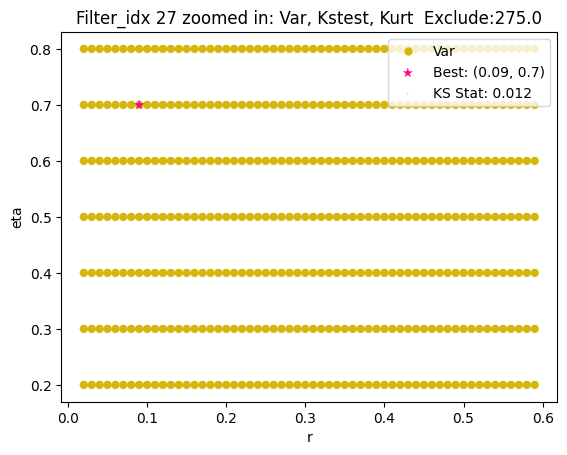

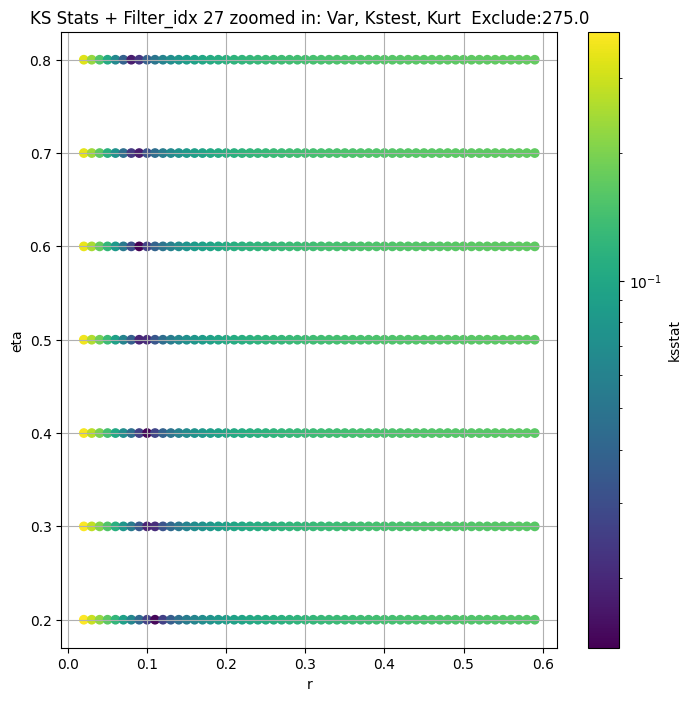

Filter_idx 28


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 28, 200.0 + 100 = 300, ksstat: 0.010696327835829966, var: 23.21312648652559


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 28, 200.0 + 75 = 275, ksstat: 0.011219167239513994, var: 23.89774317071384


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 28, 200.0 + 50 = 250, ksstat: 0.010681350977203546, var: 24.66496210577632


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 28, 200.0 + 25 = 225, ksstat: 0.011858242397930874, var: 25.53763174111366


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 28, 200.0 + 0 = 200, ksstat: 0.01229666741972077, var: 26.549523094027368


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 28, 200.0 + -25 = 175, ksstat: 0.012042869475681561, var: 27.749761520292044


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 28, 200.0 + -50 = 150, ksstat: 0.013677039296304483, var: 29.21222262382223


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 28, 200.0 + -75 = 125, ksstat: 0.013168686208528457, var: 31.049222624597


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 28, 200.0 + -100 = 100, ksstat: 0.014516076287805574, var: 33.433629245679484
Number of samples: 100000, Without approximation : 786432000.0


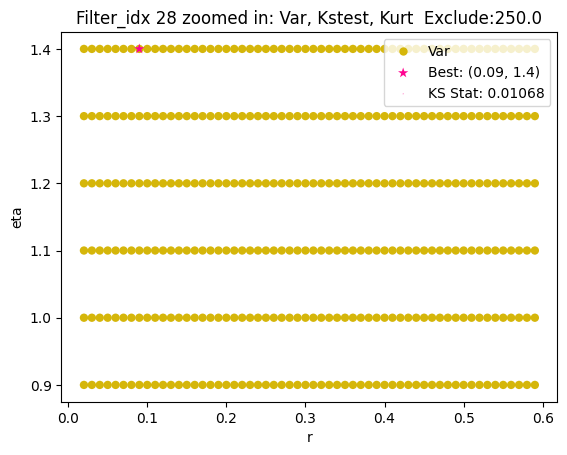

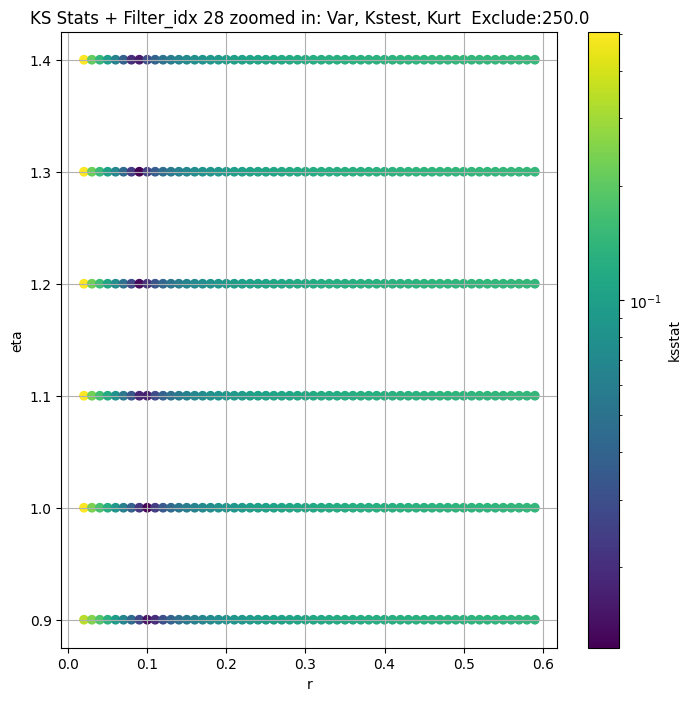

Filter_idx 29


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 29, 200.0 + 100 = 300, ksstat: 0.009383885166018048, var: 21.590975262536208


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 29, 200.0 + 75 = 275, ksstat: 0.008588806211077493, var: 22.11564197553103


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 29, 200.0 + 50 = 250, ksstat: 0.008479341383349714, var: 22.689743284816558


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 29, 200.0 + 25 = 225, ksstat: 0.00821035227260869, var: 23.324895645408688


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 29, 200.0 + 0 = 200, ksstat: 0.008835137015803962, var: 24.037005065457596


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 29, 200.0 + -25 = 175, ksstat: 0.008586428584132166, var: 24.849856036934195


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 29, 200.0 + -50 = 150, ksstat: 0.009702619909538135, var: 25.8018951624579


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 29, 200.0 + -75 = 125, ksstat: 0.008873879702844922, var: 26.957943016103556


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 29, 200.0 + -100 = 100, ksstat: 0.009822752110100419, var: 28.444269435048387
Number of samples: 100000, Without approximation : 786432000.0


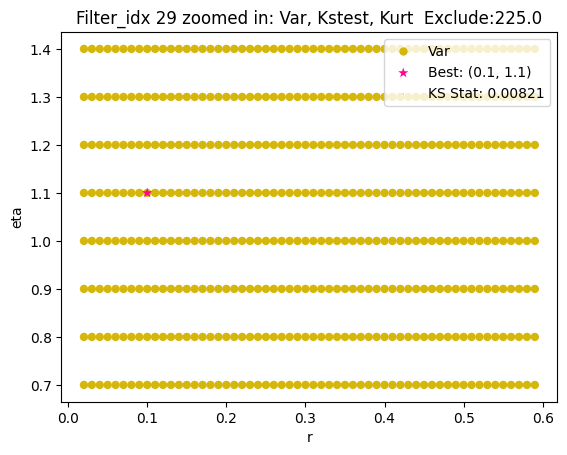

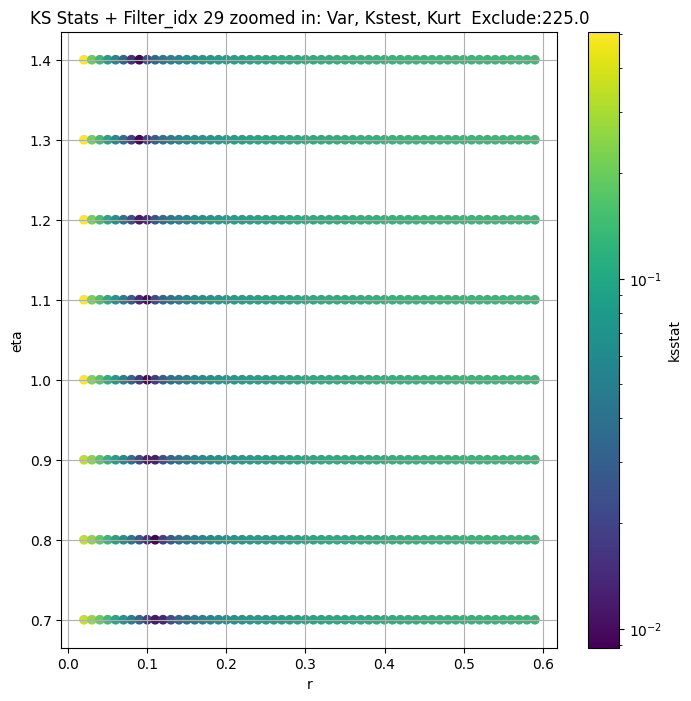

Filter_idx 30


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 30, 200.0 + 100 = 300, ksstat: 0.009107049014249302, var: 16.690953493620192


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 30, 200.0 + 75 = 275, ksstat: 0.009140165051088889, var: 17.175614609919336


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 30, 200.0 + 50 = 250, ksstat: 0.00964302545544582, var: 17.7123124346943


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 30, 200.0 + 25 = 225, ksstat: 0.010050879029583681, var: 18.314033385876357


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 30, 200.0 + 0 = 200, ksstat: 0.010786618774991874, var: 18.999115808731403


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 30, 200.0 + -25 = 175, ksstat: 0.010668558970730158, var: 19.79420249969465


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 30, 200.0 + -50 = 150, ksstat: 0.010584258339437325, var: 20.74208248063364


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 30, 200.0 + -75 = 125, ksstat: 0.011602598559038224, var: 21.91445526801586


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 30, 200.0 + -100 = 100, ksstat: 0.012752333196030363, var: 23.438105315285622
Number of samples: 100000, Without approximation : 786432000.0


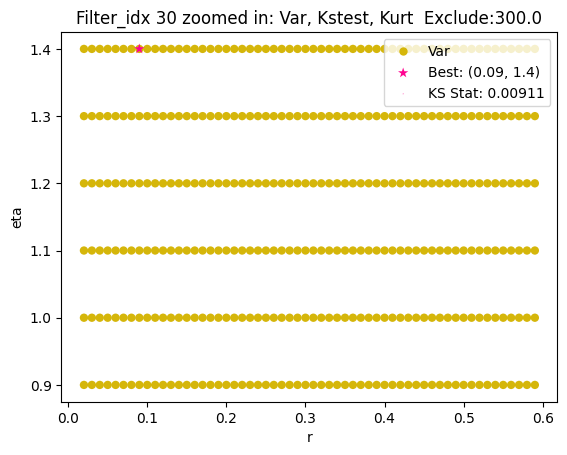

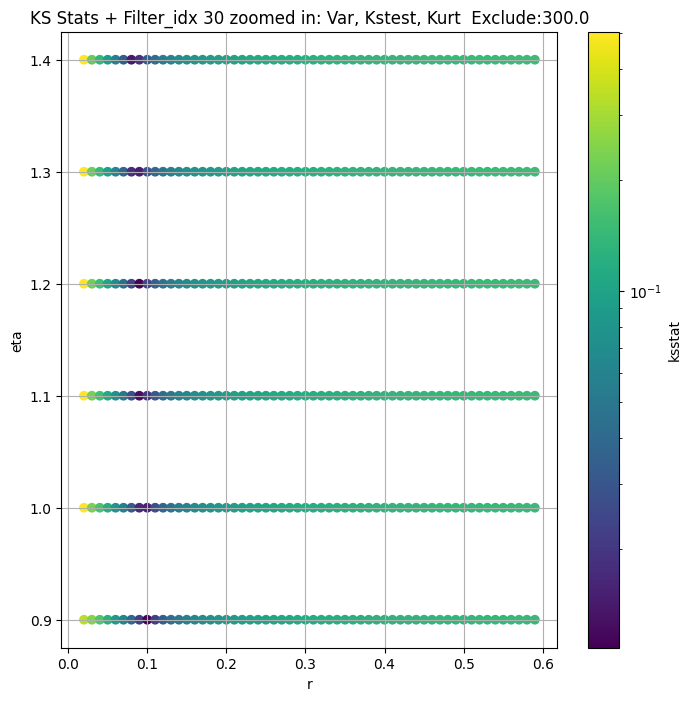

Filter_idx 31


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 100.0 + 100 = 200, ksstat: 0.01779763275641416, var: 27.846976968694406


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 100.0 + 75 = 175, ksstat: 0.017806557156704372, var: 28.652803626647657


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 100.0 + 50 = 150, ksstat: 0.01781666654271541, var: 29.615230338325073


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 100.0 + 25 = 125, ksstat: 0.017811685309219505, var: 30.81179237005407


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 100.0 + 0 = 100, ksstat: 0.017796312819392812, var: 32.38310978564213


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 100.0 + -25 = 75, ksstat: 0.018006964669218195, var: 34.587484246545706


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 100.0 + -50 = 50, ksstat: 0.018341412702115922, var: 37.94624079466153


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 100.0 + -75 = 25, ksstat: 0.01988685113477273, var: 43.99781194623387


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 100.0 + -100 = 0, ksstat: 0.026626034510117913, var: 71.90181158846626
Number of samples: 100000, Without approximation : 786432000.0


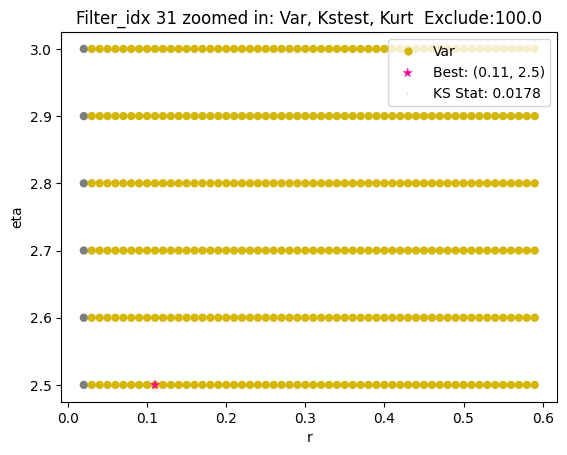

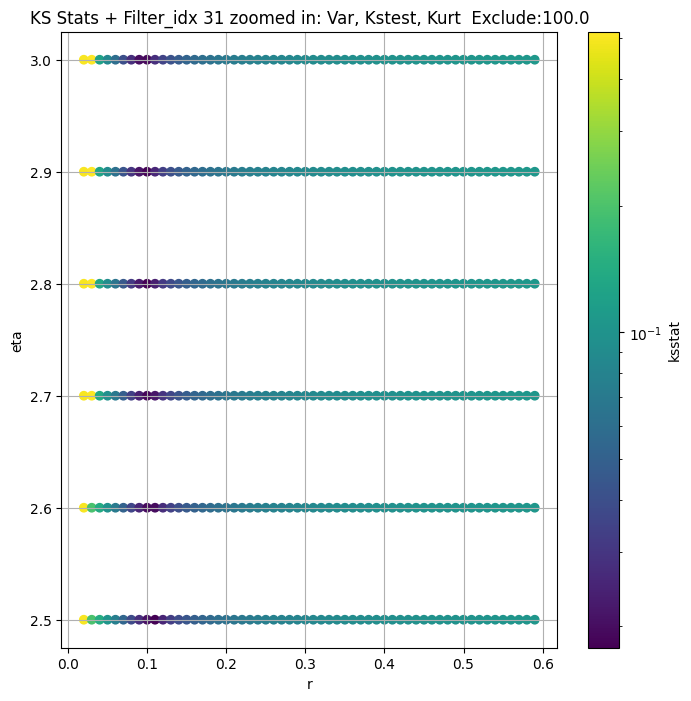

Filter_idx 32


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 32, 200.0 + 100 = 300, ksstat: 0.007542181973664623, var: 24.50902692096247


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 32, 200.0 + 75 = 275, ksstat: 0.0068346398662326655, var: 25.04481794192289


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 32, 200.0 + 50 = 250, ksstat: 0.006491925049179378, var: 25.632380093075106


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 32, 200.0 + 25 = 225, ksstat: 0.005950337829256518, var: 26.28431371285123


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 32, 200.0 + 0 = 200, ksstat: 0.005170530273080131, var: 27.01832800946264


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 32, 200.0 + -25 = 175, ksstat: 0.004557599838412342, var: 27.862043585216565


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 32, 200.0 + -50 = 150, ksstat: 0.004189511363482223, var: 28.860710202039986


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 32, 200.0 + -75 = 125, ksstat: 0.004075956875796316, var: 30.09431882326525


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 32, 200.0 + -100 = 100, ksstat: 0.004424133889336046, var: 31.72591712705009
Number of samples: 100000, Without approximation : 786432000.0


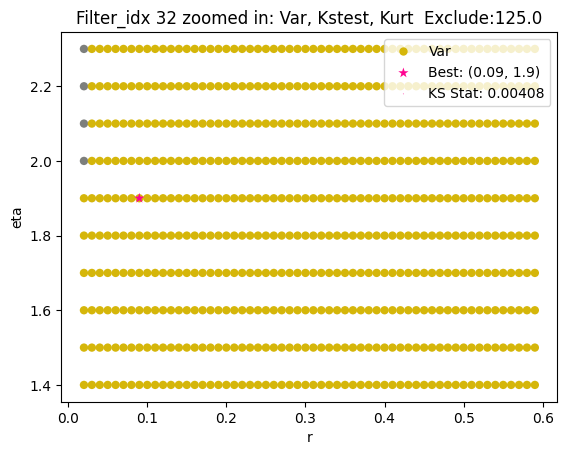

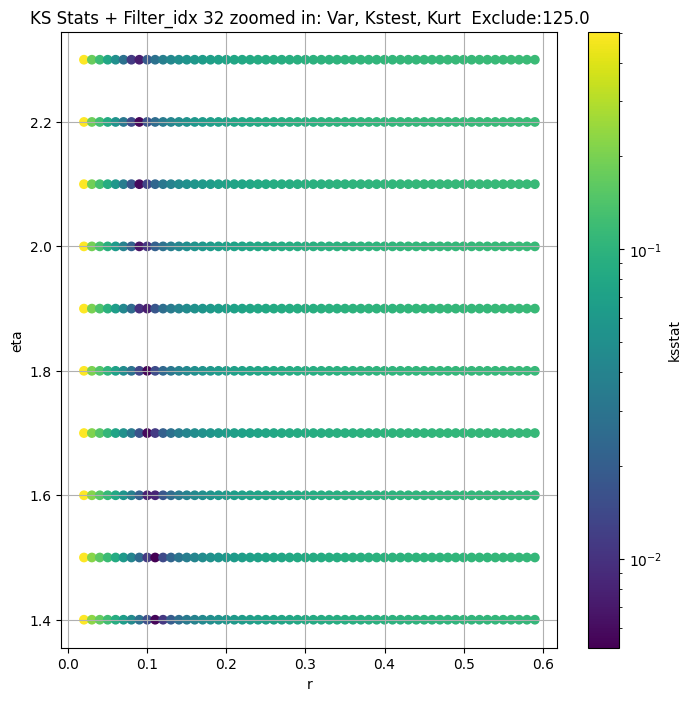

Filter_idx 33


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 200.0 + 100 = 300, ksstat: 0.008538010293798054, var: 6.285698645343703


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 200.0 + 75 = 275, ksstat: 0.008423275824932519, var: 6.4316143563586


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 200.0 + 50 = 250, ksstat: 0.008087791704885383, var: 6.589412488357651


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 200.0 + 25 = 225, ksstat: 0.009499808340307808, var: 6.761511879215409


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 200.0 + 0 = 200, ksstat: 0.008857653831456758, var: 6.95129366021007


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 200.0 + -25 = 175, ksstat: 0.010647507150327556, var: 7.163655496558778


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 200.0 + -50 = 150, ksstat: 0.009928520561692938, var: 7.405943001845433


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 200.0 + -75 = 125, ksstat: 0.011243914640741592, var: 7.690308781636466


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 200.0 + -100 = 100, ksstat: 0.011489741834771583, var: 8.039005589300709
Number of samples: 100000, Without approximation : 786432000.0


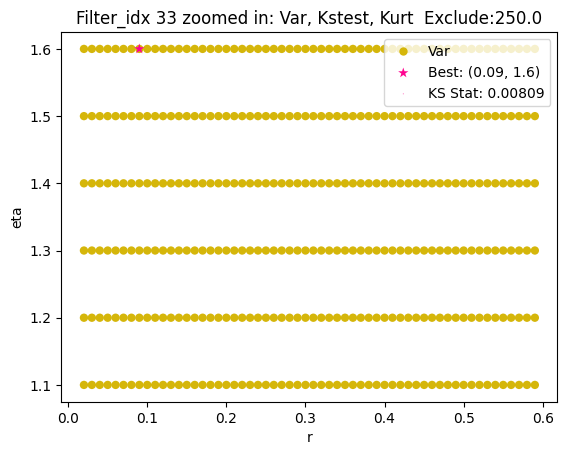

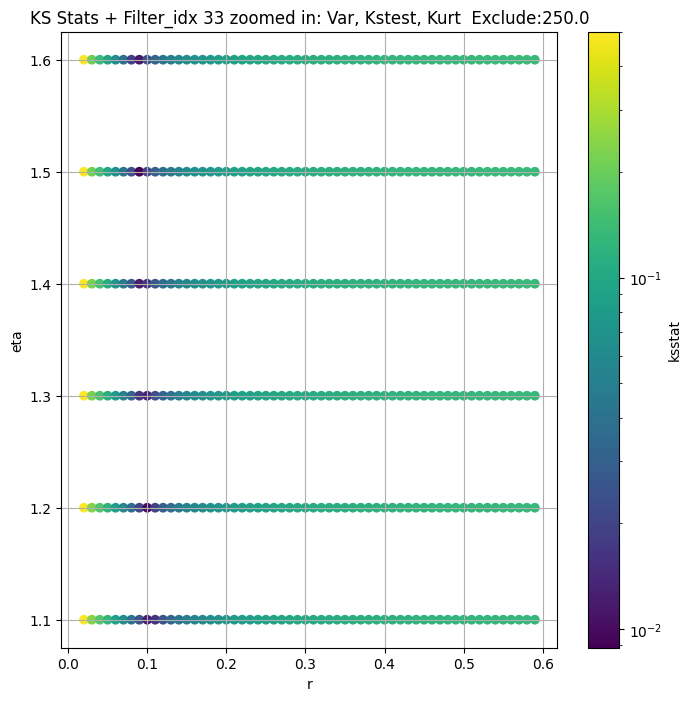

Filter_idx 34


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 200.0 + 100 = 300, ksstat: 0.008453600413683815, var: 18.070026630132766


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 200.0 + 75 = 275, ksstat: 0.008668127921316438, var: 18.561427570483772


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 200.0 + 50 = 250, ksstat: 0.009406318295759108, var: 19.105911829578844


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 200.0 + 25 = 225, ksstat: 0.00852859374188164, var: 19.716953794420863


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 200.0 + 0 = 200, ksstat: 0.010162971037946167, var: 20.413261244385385


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 200.0 + -25 = 175, ksstat: 0.009865372212466, var: 21.22255499520491


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 200.0 + -50 = 150, ksstat: 0.010141733160209832, var: 22.187992855637603


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 200.0 + -75 = 125, ksstat: 0.011442002936816298, var: 23.38064971139846


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 200.0 + -100 = 100, ksstat: 0.011034409941901996, var: 24.92821890862312
Number of samples: 100000, Without approximation : 786432000.0


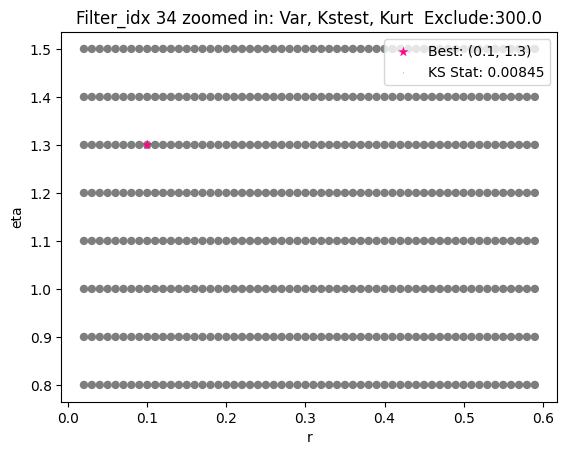

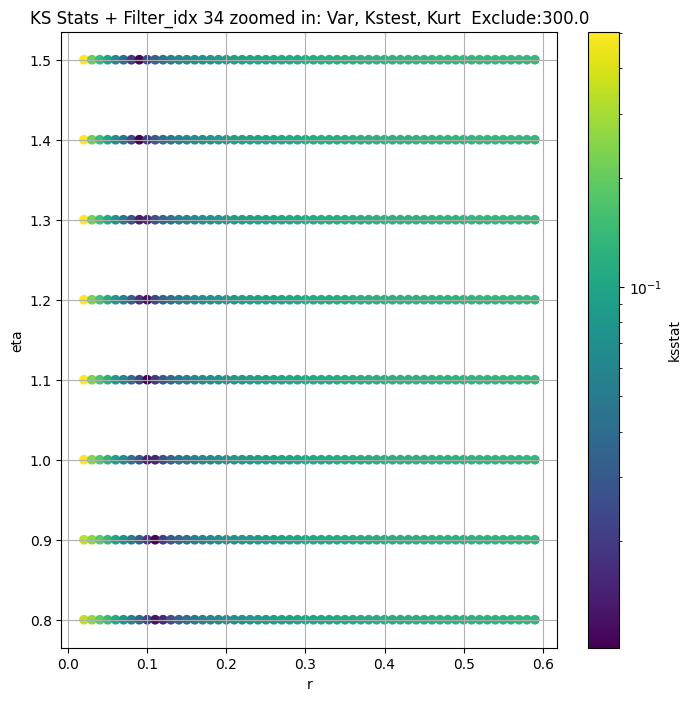

Filter_idx 35


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 35, 200.0 + 100 = 300, ksstat: 0.029925622169598765, var: 78.87006981364704


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 35, 200.0 + 75 = 275, ksstat: 0.029926631608802157, var: 80.42502261235452


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 35, 200.0 + 50 = 250, ksstat: 0.029929268505064388, var: 82.1308378824143


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 35, 200.0 + 25 = 225, ksstat: 0.029928526771913433, var: 84.03261788100855


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 35, 200.0 + 0 = 200, ksstat: 0.029928363827576077, var: 86.25326034530437


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 35, 200.0 + -25 = 175, ksstat: 0.0299366664263106, var: 88.88591831318747


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 35, 200.0 + -50 = 150, ksstat: 0.029926213393223378, var: 92.1025121335267


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 35, 200.0 + -75 = 125, ksstat: 0.029929193229630058, var: 96.17224606913308


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 35, 200.0 + -100 = 100, ksstat: 0.029934705455228305, var: 101.60158577346654
Number of samples: 100000, Without approximation : 786432000.0


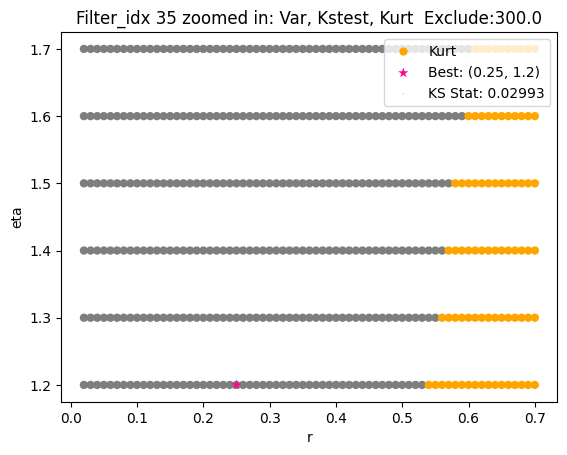

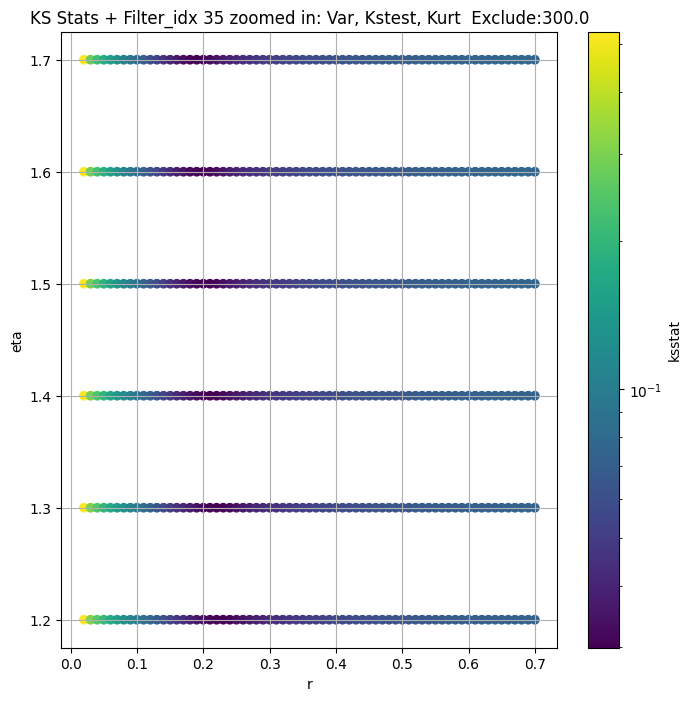

Filter_idx 37


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 37, 200.0 + 100 = 300, ksstat: 0.028797991218217245, var: 126.60984039343772


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 37, 200.0 + 75 = 275, ksstat: 0.028801369669321508, var: 129.0788958484832


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 37, 200.0 + 50 = 250, ksstat: 0.028798261128818337, var: 131.81849427521007


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 37, 200.0 + 25 = 225, ksstat: 0.02879711982068045, var: 134.9289778494171


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 37, 200.0 + 0 = 200, ksstat: 0.028797483198913176, var: 138.52370799379963


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 37, 200.0 + -25 = 175, ksstat: 0.028797167005697233, var: 142.74908285907836


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 37, 200.0 + -50 = 150, ksstat: 0.02880049496394982, var: 147.82332611515426


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 37, 200.0 + -75 = 125, ksstat: 0.028806649472562396, var: 153.9983035091911


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 37, 200.0 + -100 = 100, ksstat: 0.02880602933028603, var: 161.76247613449974
Number of samples: 100000, Without approximation : 786432000.0


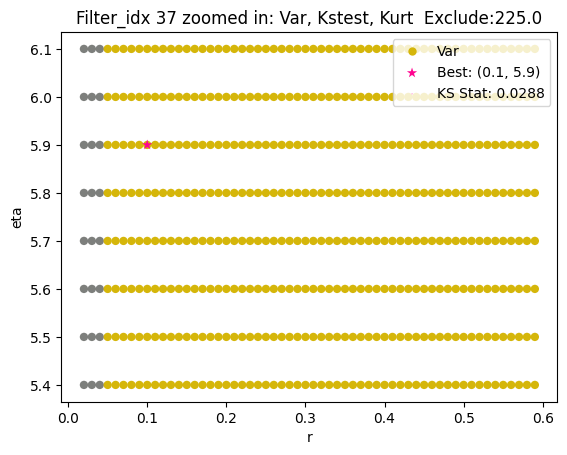

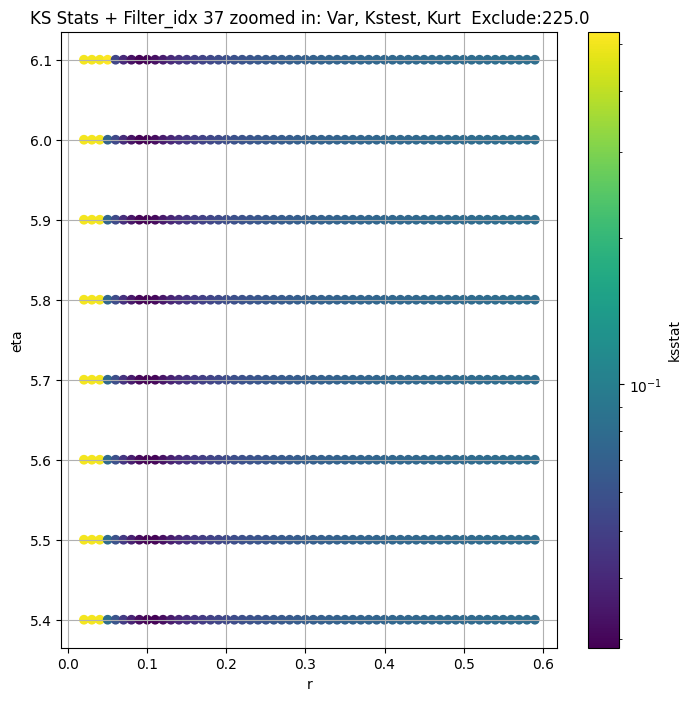

Filter_idx 38


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 38, 100.0 + 100 = 200, ksstat: 0.0038598164530319473, var: 31.86646730960739


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 38, 100.0 + 75 = 175, ksstat: 0.0032682529506094515, var: 32.76887884732907


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 38, 100.0 + 50 = 150, ksstat: 0.0028972320128031748, var: 33.84409175071784


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 38, 100.0 + 25 = 125, ksstat: 0.0028888650448478104, var: 35.17069666332622


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 38, 100.0 + 0 = 100, ksstat: 0.002888057825760071, var: 36.886035980279


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 38, 100.0 + -25 = 75, ksstat: 0.0028911745370678865, var: 39.245180141809875


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 38, 100.0 + -50 = 50, ksstat: 0.004096720578754431, var: 42.83642692705092


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 38, 100.0 + -75 = 25, ksstat: 0.007074468454845717, var: 49.513510538718776


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 38, 100.0 + -100 = 0, ksstat: 0.019357208768113643, var: 93.40590223770884
Number of samples: 100000, Without approximation : 786432000.0


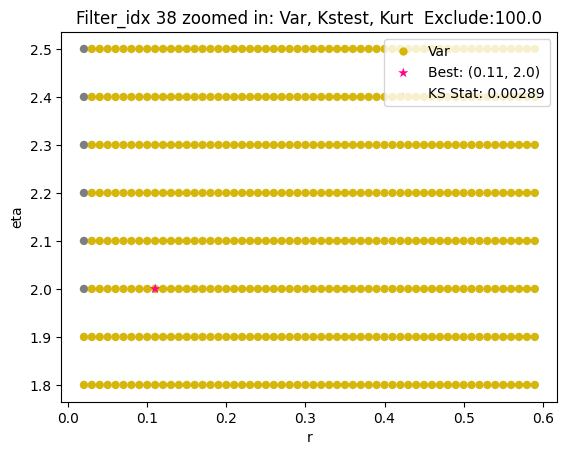

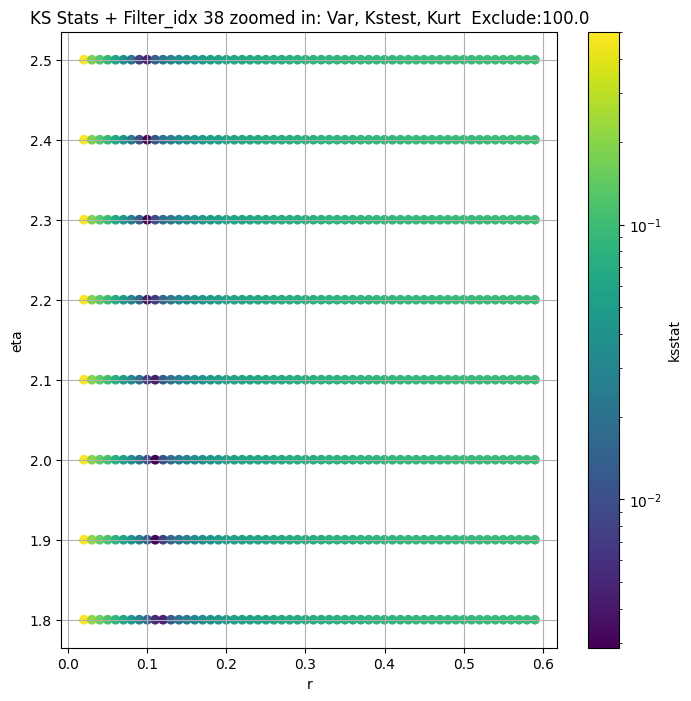

Filter_idx 39


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 200.0 + 100 = 300, ksstat: 0.020928383207377665, var: 30.69849639829759


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 200.0 + 75 = 275, ksstat: 0.020931589196466593, var: 31.333057706993955


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 200.0 + 50 = 250, ksstat: 0.020927200214170882, var: 32.03044120918253


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 200.0 + 25 = 225, ksstat: 0.020939978673228055, var: 32.80626809279202


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 200.0 + 0 = 200, ksstat: 0.020929034976573502, var: 33.68366525799421


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 200.0 + -25 = 175, ksstat: 0.02092666633709367, var: 34.69740000065225


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 200.0 + -50 = 150, ksstat: 0.020926937491568764, var: 35.904827222163725


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 200.0 + -75 = 125, ksstat: 0.020928999047951424, var: 37.40311658542817


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 200.0 + -100 = 100, ksstat: 0.020947912239408062, var: 39.37299211427687
Number of samples: 100000, Without approximation : 786432000.0


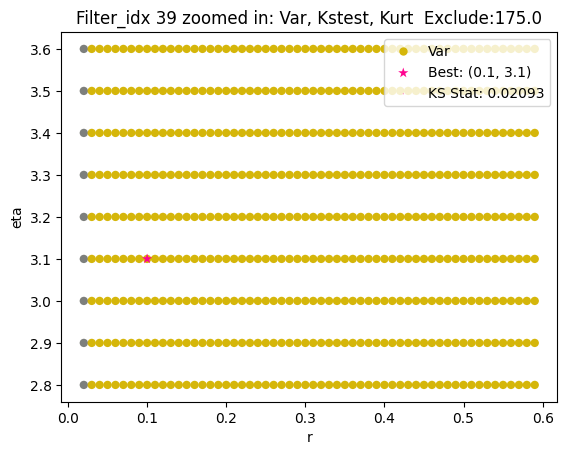

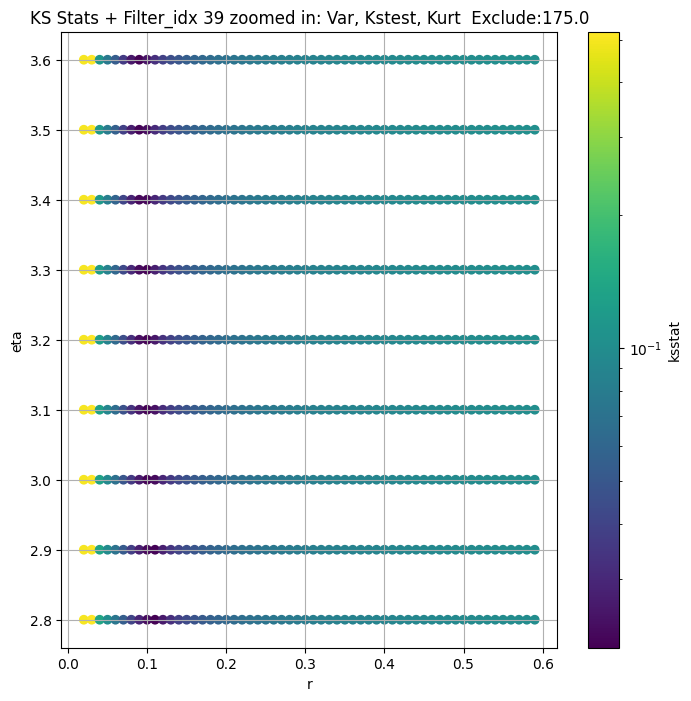

Filter_idx 40


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 200.0 + 100 = 300, ksstat: 0.006652572423741954, var: 26.096986340825634


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 200.0 + 75 = 275, ksstat: 0.006941845517000833, var: 26.55833190195048


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 200.0 + 50 = 250, ksstat: 0.007149877498355495, var: 27.07808265637076


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 200.0 + 25 = 225, ksstat: 0.007320675543469601, var: 27.67608441283644


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 200.0 + 0 = 200, ksstat: 0.007982091395592195, var: 28.367103284515313


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 200.0 + -25 = 175, ksstat: 0.008509912577515433, var: 29.188528081529597


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 200.0 + -50 = 150, ksstat: 0.00892646290114918, var: 30.1969640307614


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 200.0 + -75 = 125, ksstat: 0.010316727938968873, var: 31.453398884074645


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 200.0 + -100 = 100, ksstat: 0.011495473751567065, var: 33.038419065914994
Number of samples: 100000, Without approximation : 786432000.0


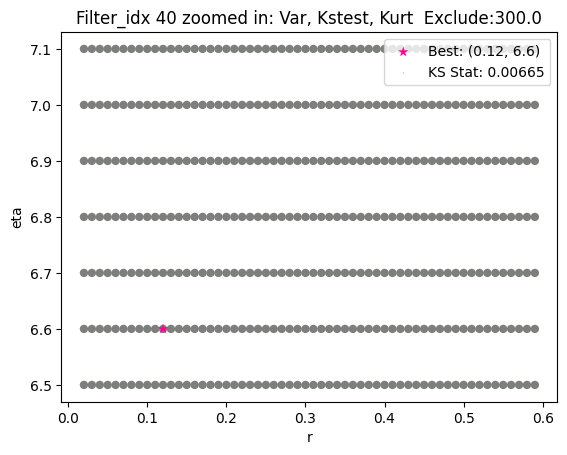

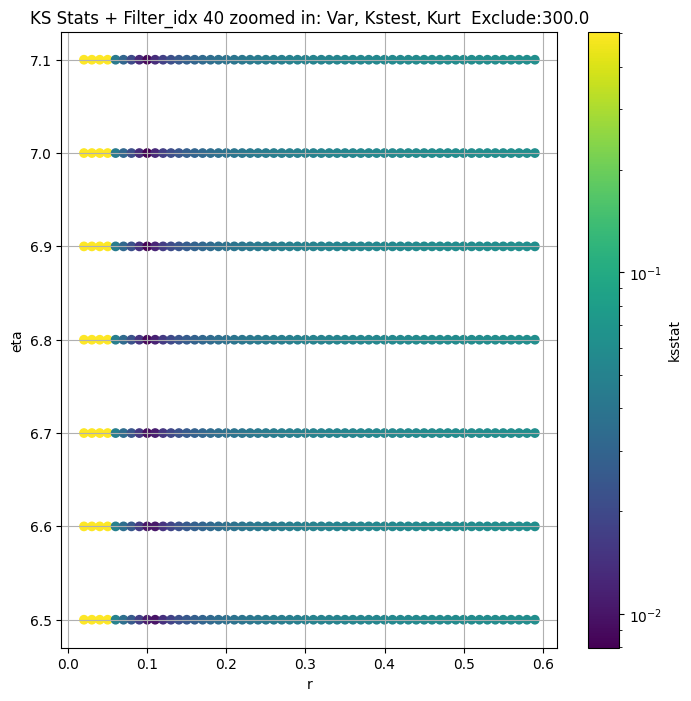

Filter_idx 41


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + 100 = 300, ksstat: 0.006685774710216363, var: 12.037173806242626


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + 75 = 275, ksstat: 0.006398918520187369, var: 12.307934792819143


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + 50 = 250, ksstat: 0.006000505546824186, var: 12.60164887170811


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + 25 = 225, ksstat: 0.006329161389909244, var: 12.923113916997753


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + 0 = 200, ksstat: 0.00706250682873355, var: 13.27879984780716


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + -25 = 175, ksstat: 0.007098301792131778, var: 13.67804668779891


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + -50 = 150, ksstat: 0.007250902142745375, var: 14.135157439913613


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + -75 = 125, ksstat: 0.00827875720191873, var: 14.673028830799286


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + -100 = 100, ksstat: 0.009144839664914084, var: 15.3325821994882
Number of samples: 100000, Without approximation : 786432000.0


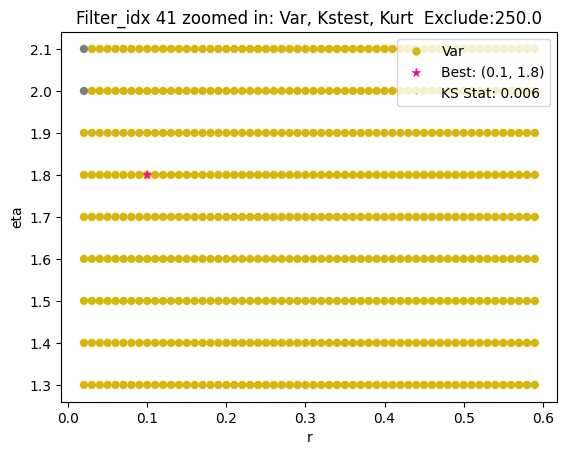

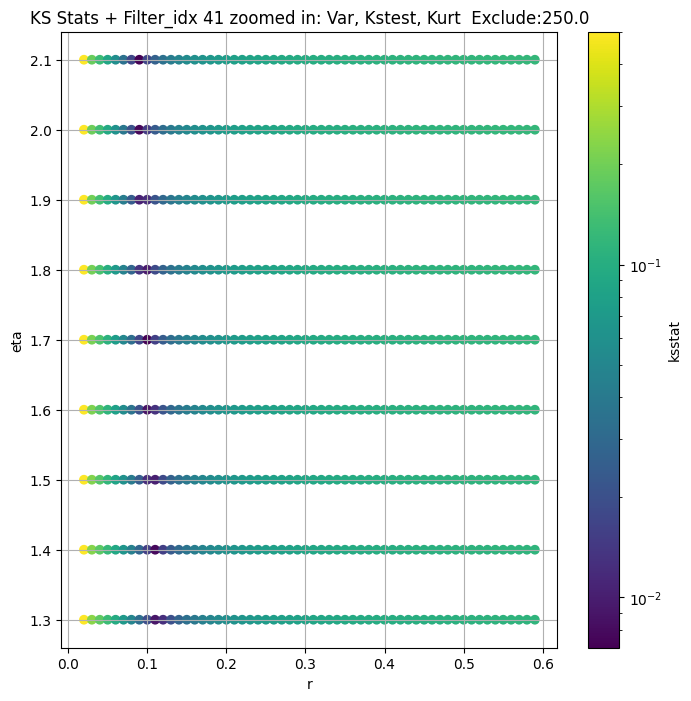

Filter_idx 42


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 42, 100.0 + 100 = 200, ksstat: 0.00467326999170066, var: 45.563284958806676


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 42, 100.0 + 75 = 175, ksstat: 0.004011797550872165, var: 46.85246863660198


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 42, 100.0 + 50 = 150, ksstat: 0.0031068868295539703, var: 48.37857974667755


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 42, 100.0 + 25 = 125, ksstat: 0.002208538571176026, var: 50.244936685946485


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 42, 100.0 + 0 = 100, ksstat: 0.001857619440445879, var: 52.63134057252037


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 42, 100.0 + -25 = 75, ksstat: 0.0018707154971630002, var: 55.870873079577876


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 42, 100.0 + -50 = 50, ksstat: 0.0035514819729839386, var: 60.73052219182036


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 42, 100.0 + -75 = 25, ksstat: 0.006085478290760782, var: 69.57803586808112


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 42, 100.0 + -100 = 0, ksstat: 0.018810040245428872, var: 132.4124223827206
Number of samples: 100000, Without approximation : 786432000.0


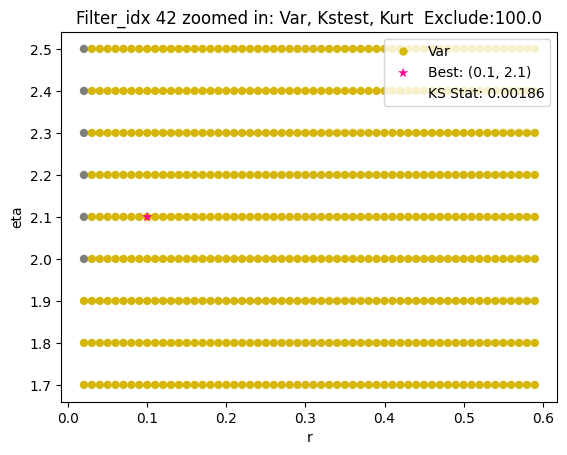

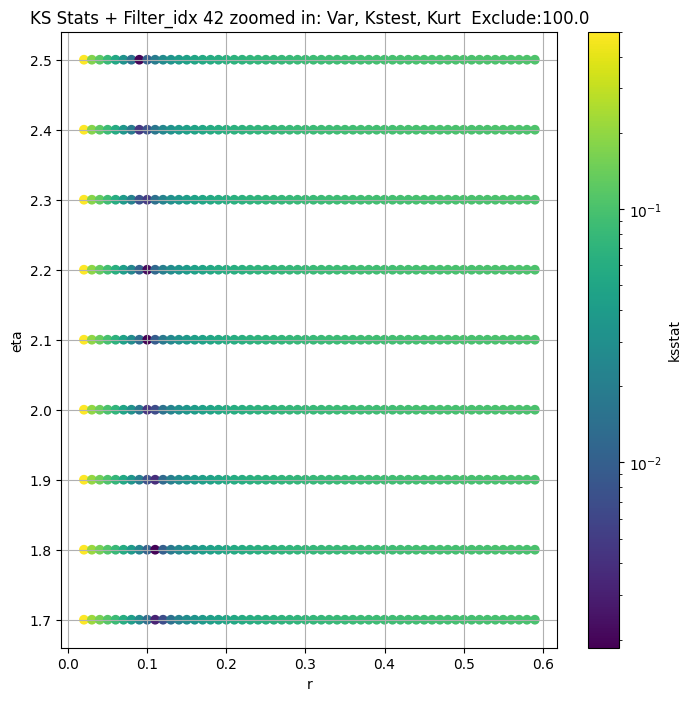

Filter_idx 43


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 43, 100.0 + 100 = 200, ksstat: 0.004382092910394153, var: 13.453647953693164


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 43, 100.0 + 75 = 175, ksstat: 0.0037966615605482534, var: 13.82094605285828


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 43, 100.0 + 50 = 150, ksstat: 0.0033684318224593834, var: 14.246637205322285


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 43, 100.0 + 25 = 125, ksstat: 0.0030902110231812996, var: 14.755964702801679


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 43, 100.0 + 0 = 100, ksstat: 0.0029562841502687176, var: 15.394941839374763


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 43, 100.0 + -25 = 75, ksstat: 0.002893749531218459, var: 16.260694887249205


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 43, 100.0 + -50 = 50, ksstat: 0.003908159595164995, var: 17.609352945064042


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 43, 100.0 + -75 = 25, ksstat: 0.0069323005677950356, var: 20.315916550752373


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 43, 100.0 + -100 = 0, ksstat: 0.019009425401261812, var: 39.75424166570141
Number of samples: 100000, Without approximation : 786432000.0


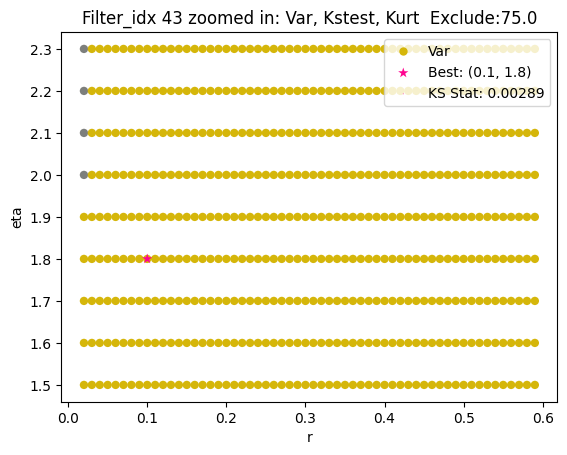

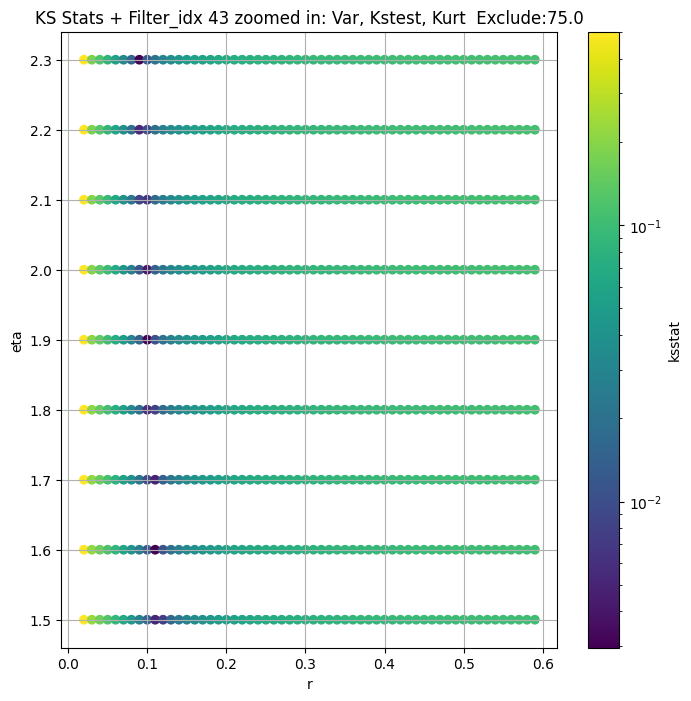

Filter_idx 44


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 44, 200.0 + 100 = 300, ksstat: 0.005268059121885289, var: 40.14239270065899


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 44, 200.0 + 75 = 275, ksstat: 0.004752213343394648, var: 40.92366459885223


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 44, 200.0 + 50 = 250, ksstat: 0.004276838035845432, var: 41.786302808232165


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 44, 200.0 + 25 = 225, ksstat: 0.0037359993354066402, var: 42.75053647487637


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 44, 200.0 + 0 = 200, ksstat: 0.003185806519220402, var: 43.84519991894345


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 44, 200.0 + -25 = 175, ksstat: 0.0026625043286858663, var: 45.11405730068303


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 44, 200.0 + -50 = 150, ksstat: 0.002206237932618033, var: 46.623231902731426


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 44, 200.0 + -75 = 125, ksstat: 0.002476338128620581, var: 48.48386540514842


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 44, 200.0 + -100 = 100, ksstat: 0.0031247622781678253, var: 50.88648570903103
Number of samples: 100000, Without approximation : 786432000.0


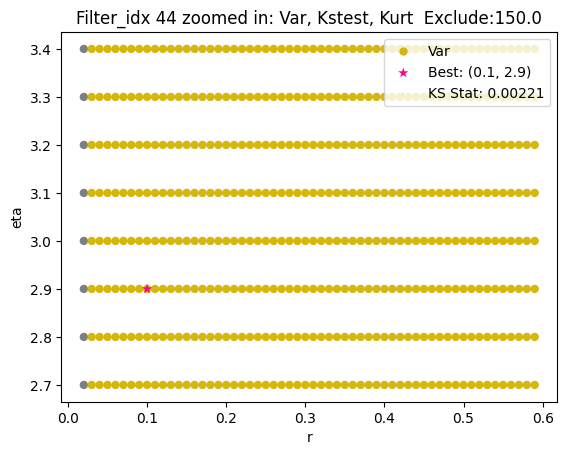

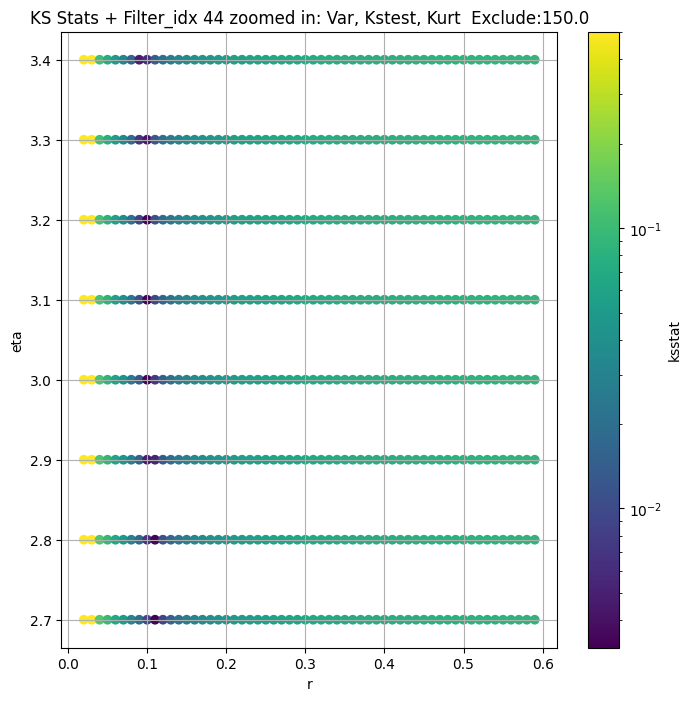

Filter_idx 45


  0%|          | 0/747 [00:00<?, ?it/s]

Finding Minimum after computing 747 CDFs
filter_idx 45, 200.0 + 100 = 300, ksstat: 0.0055529017697127925, var: 20.249059930419776


  0%|          | 0/747 [00:00<?, ?it/s]

Finding Minimum after computing 747 CDFs
filter_idx 45, 200.0 + 75 = 275, ksstat: 0.005159829455849252, var: 20.657983078896322


  0%|          | 0/747 [00:00<?, ?it/s]

Finding Minimum after computing 747 CDFs
filter_idx 45, 200.0 + 50 = 250, ksstat: 0.00489546554924758, var: 21.105134337935016


  0%|          | 0/747 [00:00<?, ?it/s]

Finding Minimum after computing 747 CDFs
filter_idx 45, 200.0 + 25 = 225, ksstat: 0.004655665635684314, var: 21.5997885531142


  0%|          | 0/747 [00:00<?, ?it/s]

Finding Minimum after computing 747 CDFs
filter_idx 45, 200.0 + 0 = 200, ksstat: 0.00431004960410919, var: 22.15544235692223


  0%|          | 0/747 [00:00<?, ?it/s]

Finding Minimum after computing 747 CDFs
filter_idx 45, 200.0 + -25 = 175, ksstat: 0.004131547319355611, var: 22.793080036583238


  0%|          | 0/747 [00:00<?, ?it/s]

Finding Minimum after computing 747 CDFs
filter_idx 45, 200.0 + -50 = 150, ksstat: 0.004980926724255319, var: 23.547224613374222


  0%|          | 0/747 [00:00<?, ?it/s]

Finding Minimum after computing 747 CDFs
filter_idx 45, 200.0 + -75 = 125, ksstat: 0.005170353526827487, var: 24.481244421855326


  0%|          | 0/747 [00:00<?, ?it/s]

Finding Minimum after computing 747 CDFs
filter_idx 45, 200.0 + -100 = 100, ksstat: 0.006033685264079103, var: 25.720636046020314
Number of samples: 100000, Without approximation : 786432000.0


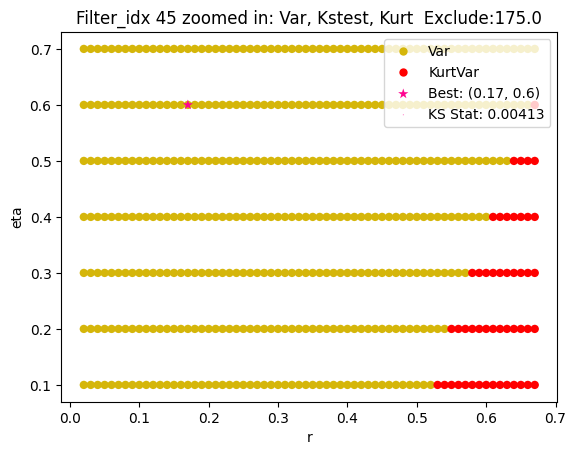

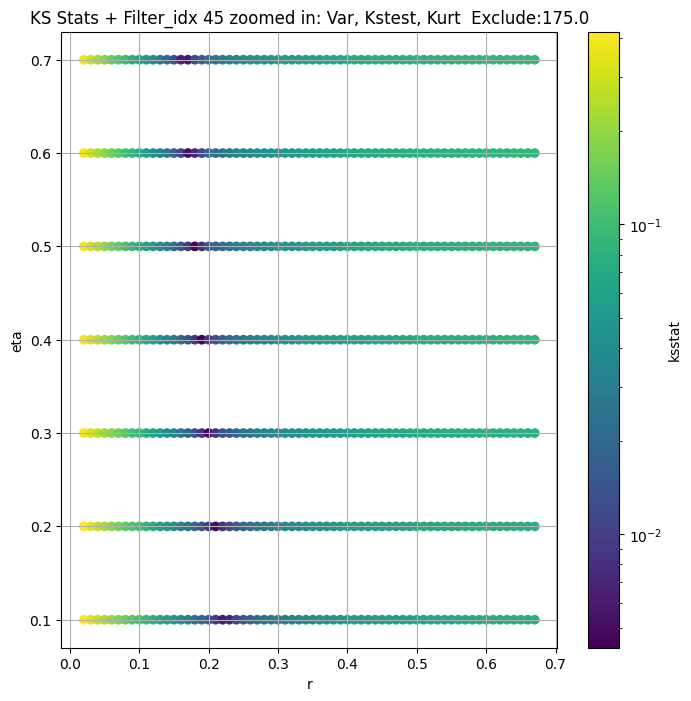

Filter_idx 46


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 46, 200.0 + 100 = 300, ksstat: 0.018787340388029095, var: 12.774099907545638


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 46, 200.0 + 75 = 275, ksstat: 0.01878087328496053, var: 13.009943197227718


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 46, 200.0 + 50 = 250, ksstat: 0.018774094943508124, var: 13.272025288327097


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 46, 200.0 + 25 = 225, ksstat: 0.01877538324174982, var: 13.56702267999466


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 46, 200.0 + 0 = 200, ksstat: 0.018783276852354924, var: 13.904988773577681


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 46, 200.0 + -25 = 175, ksstat: 0.01878934652738634, var: 14.301121873213548


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 46, 200.0 + -50 = 150, ksstat: 0.01879046653137567, var: 14.778456966524608


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 46, 200.0 + -75 = 125, ksstat: 0.01878503585120428, var: 15.372980042169518


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 46, 200.0 + -100 = 100, ksstat: 0.018790125082140452, var: 16.143036937704952
Number of samples: 100000, Without approximation : 786432000.0


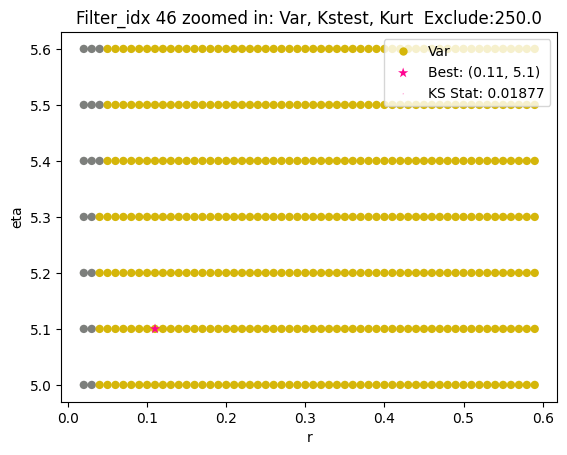

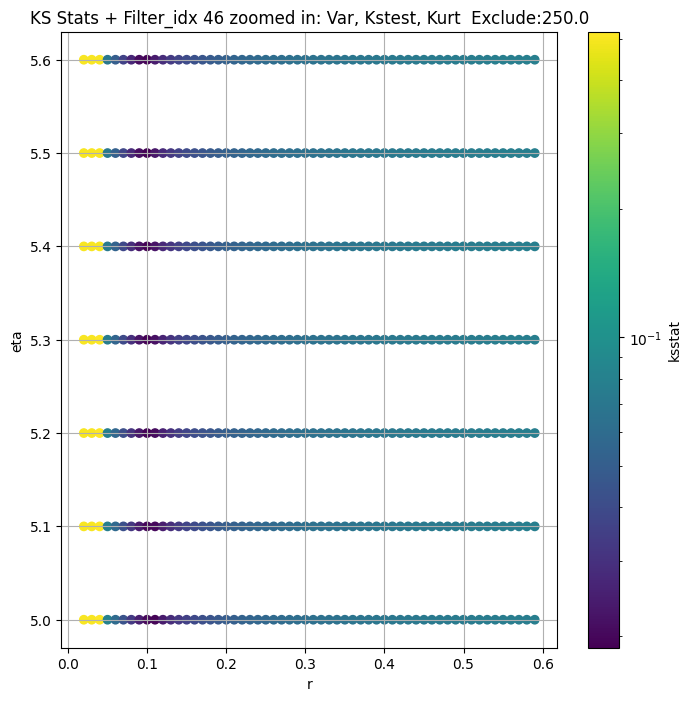

Filter_idx 47


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 47, 100.0 + 100 = 200, ksstat: 0.004296915193956322, var: 15.376974783123917


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 47, 100.0 + 75 = 175, ksstat: 0.0037482496591757786, var: 15.876419024303148


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 47, 100.0 + 50 = 150, ksstat: 0.0034109604669525506, var: 16.468370105449825


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 47, 100.0 + 25 = 125, ksstat: 0.0029025855667784706, var: 17.191299911162684


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 47, 100.0 + 0 = 100, ksstat: 0.0027877736420821586, var: 18.11182047279774


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 47, 100.0 + -25 = 75, ksstat: 0.0027573199002920434, var: 19.36102387533537


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 47, 100.0 + -50 = 50, ksstat: 0.004451382368156204, var: 21.222981115115967


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 47, 100.0 + -75 = 25, ksstat: 0.007842540950328374, var: 24.601130872359967


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 47, 100.0 + -100 = 0, ksstat: 0.020284780573585896, var: 48.93792609994658
Number of samples: 100000, Without approximation : 786432000.0


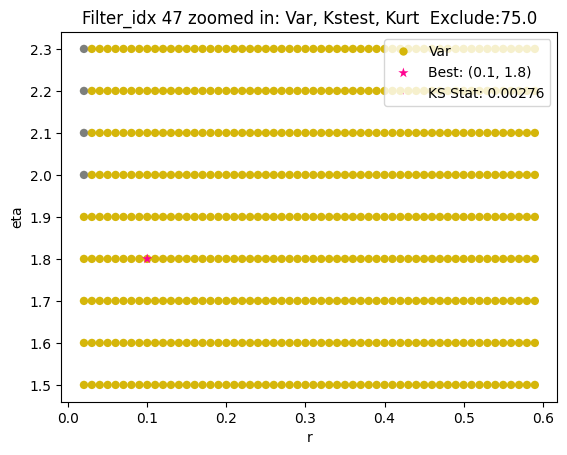

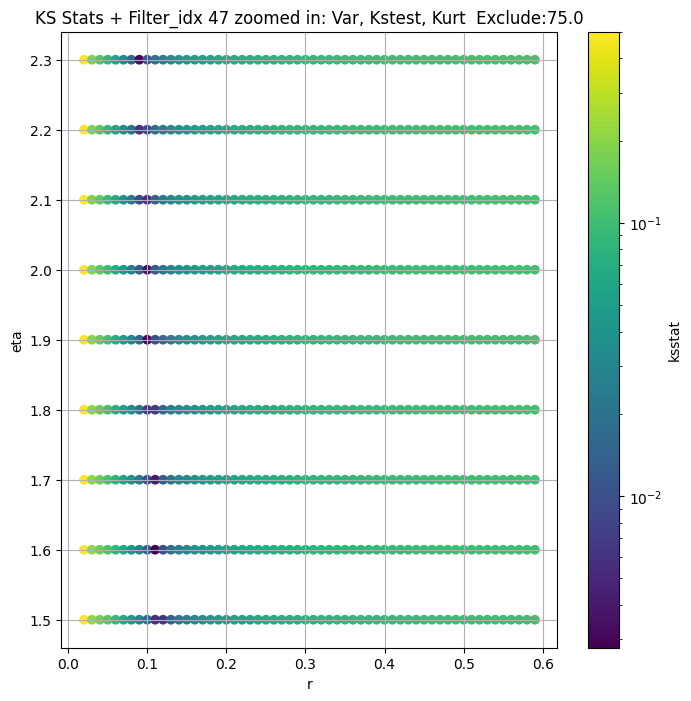

Filter_idx 48


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 48, 200.0 + 100 = 300, ksstat: 0.005846421192313822, var: 13.069392566695141


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 48, 200.0 + 75 = 275, ksstat: 0.006059815354999887, var: 13.408089028651657


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 48, 200.0 + 50 = 250, ksstat: 0.005895562743066907, var: 13.78153766691239


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 48, 200.0 + 25 = 225, ksstat: 0.006115232067829379, var: 14.19704102531082


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 48, 200.0 + 0 = 200, ksstat: 0.006402154585074427, var: 14.664425266747925


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 48, 200.0 + -25 = 175, ksstat: 0.0067938277958073945, var: 15.19768441338865


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 48, 200.0 + -50 = 150, ksstat: 0.007239963826469409, var: 15.817511234409846


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 48, 200.0 + -75 = 125, ksstat: 0.007639382621892787, var: 16.55568087765853


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 48, 200.0 + -100 = 100, ksstat: 0.008264545719955052, var: 17.464348237242213
Number of samples: 100000, Without approximation : 786432000.0


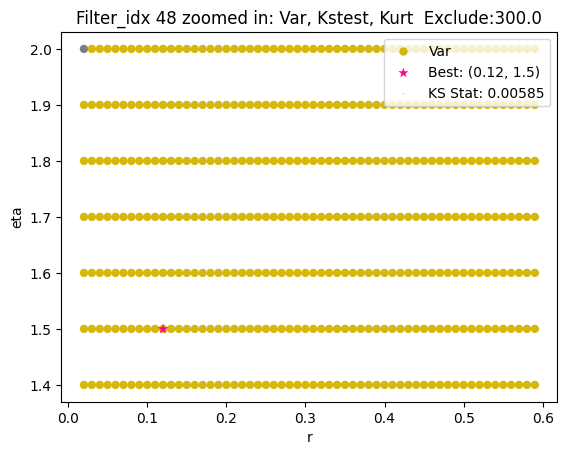

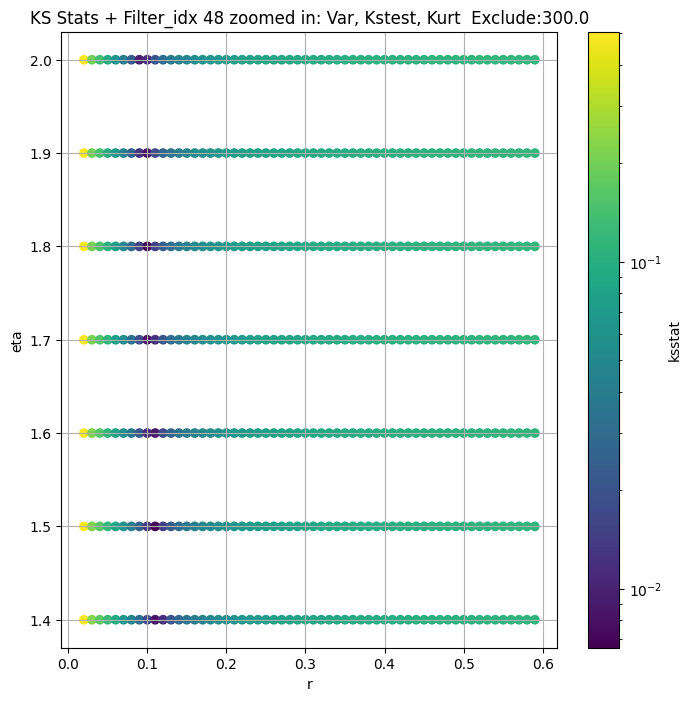

Filter_idx 49


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 49, 100.0 + 100 = 200, ksstat: 0.004112589378211795, var: 48.21855536984342


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 49, 100.0 + 75 = 175, ksstat: 0.0035131217801493975, var: 49.4503678705071


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 49, 100.0 + 50 = 150, ksstat: 0.002870936544395186, var: 50.889369286768236


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 49, 100.0 + 25 = 125, ksstat: 0.0022438226998692246, var: 52.63369380252302


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 49, 100.0 + 0 = 100, ksstat: 0.001907591148167631, var: 54.869640001576


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 49, 100.0 + -25 = 75, ksstat: 0.002910895370892619, var: 57.97382418856161


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 49, 100.0 + -50 = 50, ksstat: 0.004855866925445151, var: 62.786420514369595


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 49, 100.0 + -75 = 25, ksstat: 0.007774010986719704, var: 71.69995236279503


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 49, 100.0 + -100 = 0, ksstat: 0.01854360463738558, var: 126.2091955107744
Number of samples: 100000, Without approximation : 786432000.0


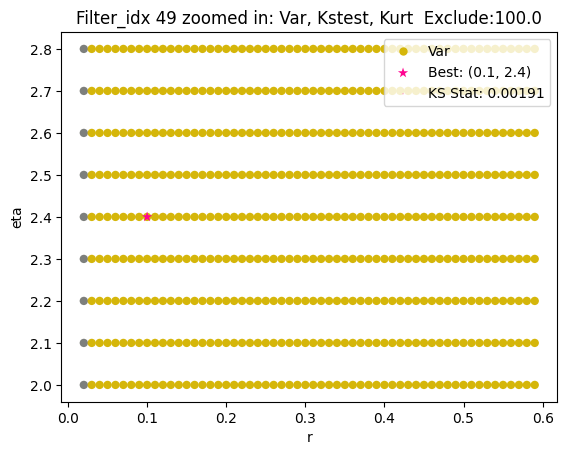

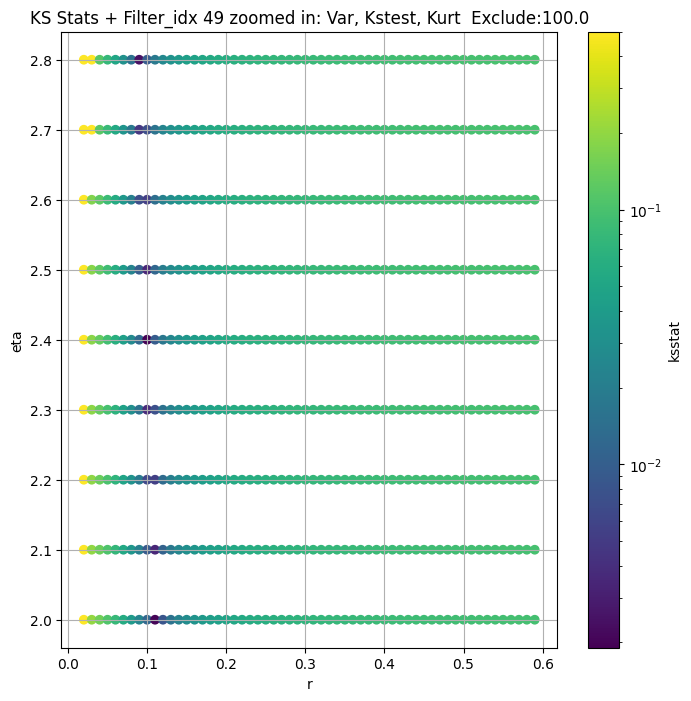

Filter_idx 50


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 50, 200.0 + 100 = 300, ksstat: 0.006203674820162014, var: 21.914746816658365


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 50, 200.0 + 75 = 275, ksstat: 0.005610701602650391, var: 22.3553542375828


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 50, 200.0 + 50 = 250, ksstat: 0.005247931816586785, var: 22.83620391027557


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 50, 200.0 + 25 = 225, ksstat: 0.0047232068534096075, var: 23.36630144760014


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 50, 200.0 + 0 = 200, ksstat: 0.004499026924045912, var: 23.958400774329736


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 50, 200.0 + -25 = 175, ksstat: 0.004504455487731485, var: 24.63144200823844


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 50, 200.0 + -50 = 150, ksstat: 0.0044983278776215, var: 25.415459332123906


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 50, 200.0 + -75 = 125, ksstat: 0.004492133850116542, var: 26.360887561578515


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 50, 200.0 + -100 = 100, ksstat: 0.004490463615130114, var: 27.5608592278505
Number of samples: 100000, Without approximation : 786432000.0


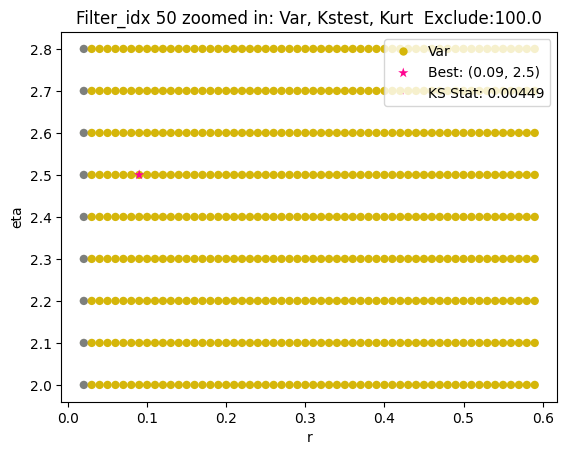

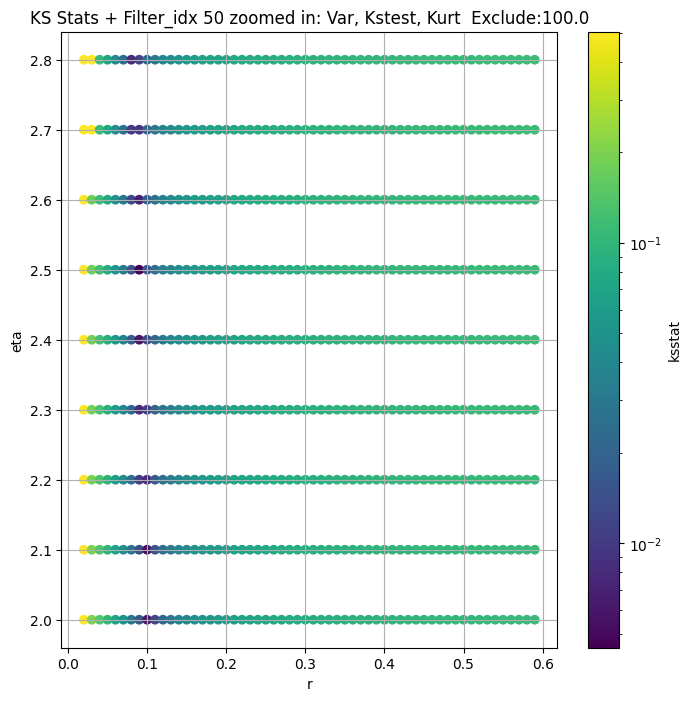

Filter_idx 52


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 52, 200.0 + 100 = 300, ksstat: 0.0045367386849766884, var: 24.58848478725135


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 52, 200.0 + 75 = 275, ksstat: 0.004219539345362805, var: 25.002228667103722


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 52, 200.0 + 50 = 250, ksstat: 0.004193001872587504, var: 25.467709260261174


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 52, 200.0 + 25 = 225, ksstat: 0.004410267617313363, var: 26.000437999266893


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 52, 200.0 + 0 = 200, ksstat: 0.0050416705419799035, var: 26.622786154500233


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 52, 200.0 + -25 = 175, ksstat: 0.005797794533728071, var: 27.367588593279397


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 52, 200.0 + -50 = 150, ksstat: 0.0067217812136337735, var: 28.27900322813405


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 52, 200.0 + -75 = 125, ksstat: 0.008328341998892985, var: 29.41392218839084


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 52, 200.0 + -100 = 100, ksstat: 0.009286387908688729, var: 30.871981499651493
Number of samples: 100000, Without approximation : 786432000.0


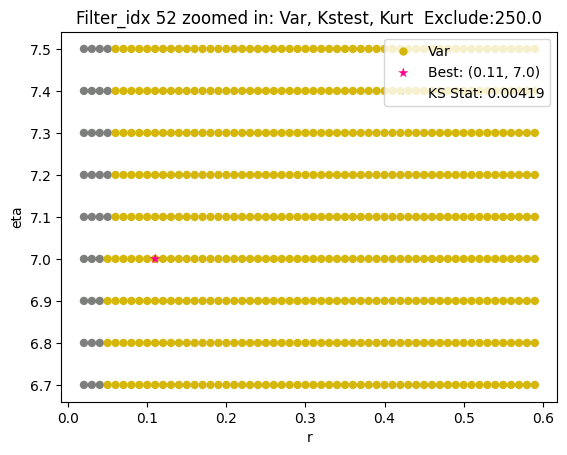

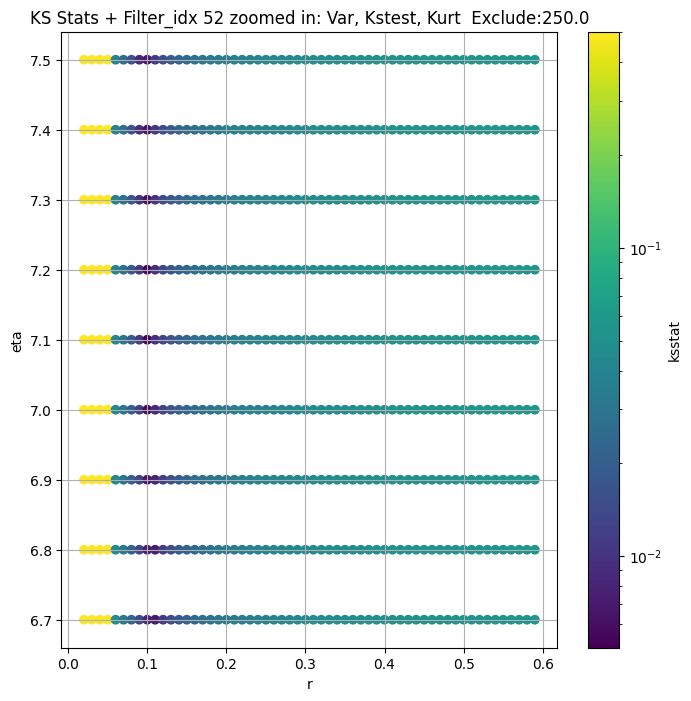

Filter_idx 54


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 54, 200.0 + 100 = 300, ksstat: 0.006249653520522647, var: 3.6685783982909816


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 54, 200.0 + 75 = 275, ksstat: 0.007080339536390312, var: 3.7915710724556497


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 54, 200.0 + 50 = 250, ksstat: 0.007231910154014448, var: 3.930553826012109


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 54, 200.0 + 25 = 225, ksstat: 0.007449014726011727, var: 4.089440152689764


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 54, 200.0 + 0 = 200, ksstat: 0.008641790862216336, var: 4.273539631994978


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 54, 200.0 + -25 = 175, ksstat: 0.00990268077883899, var: 4.490069037184404


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 54, 200.0 + -50 = 150, ksstat: 0.011097075016443525, var: 4.749148910107496


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 54, 200.0 + -75 = 125, ksstat: 0.010796355522394052, var: 5.065008049252935


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 54, 200.0 + -100 = 100, ksstat: 0.012292487681097974, var: 5.459016446798316
Number of samples: 100000, Without approximation : 786432000.0


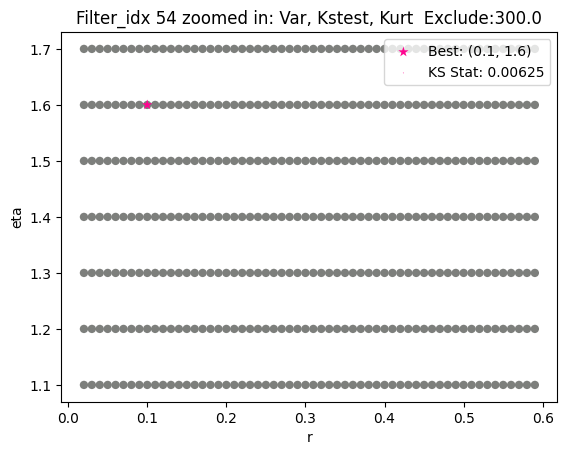

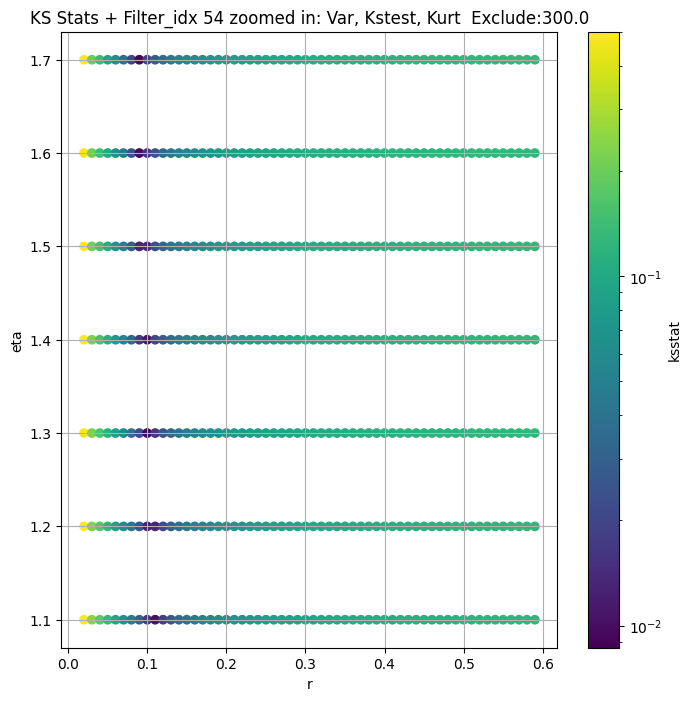

Filter_idx 55


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 55, 200.0 + 100 = 300, ksstat: 0.005450675795084459, var: 15.373317469137637


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 55, 200.0 + 75 = 275, ksstat: 0.0050566580001129065, var: 15.706918746898838


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 55, 200.0 + 50 = 250, ksstat: 0.0046614395090192225, var: 16.072132509311256


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 55, 200.0 + 25 = 225, ksstat: 0.00423485442430818, var: 16.476004438037236


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 55, 200.0 + 0 = 200, ksstat: 0.0040490181332279995, var: 16.928446101161608


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 55, 200.0 + -25 = 175, ksstat: 0.00453047192541467, var: 17.44360668178417


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 55, 200.0 + -50 = 150, ksstat: 0.005306259921465356, var: 18.042733182037395


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 55, 200.0 + -75 = 125, ksstat: 0.005658490746412892, var: 18.759935493777267


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 55, 200.0 + -100 = 100, ksstat: 0.007431470119387579, var: 19.65311509774849
Number of samples: 100000, Without approximation : 786432000.0


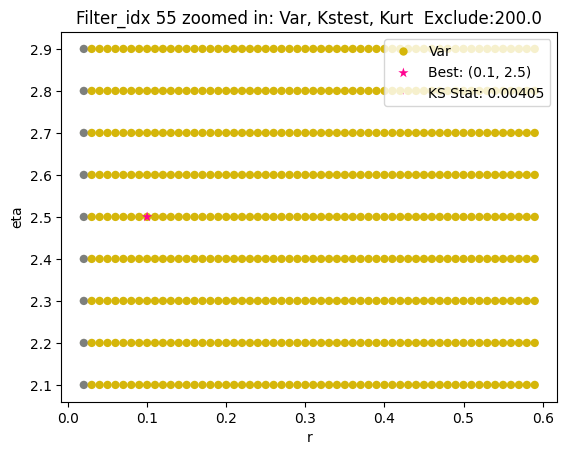

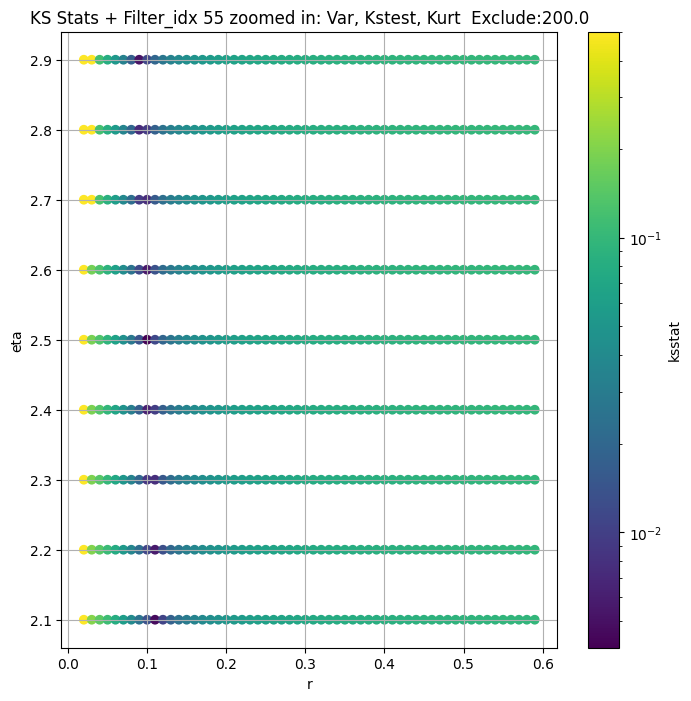

Filter_idx 56


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 56, 100.0 + 100 = 200, ksstat: 0.003024078887904659, var: 29.76414697927925


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 56, 100.0 + 75 = 175, ksstat: 0.0024893973852375684, var: 30.674354117500297


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 56, 100.0 + 50 = 150, ksstat: 0.002149276124535082, var: 31.747957950380837


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 56, 100.0 + 25 = 125, ksstat: 0.0018683051875708623, var: 33.04933327103664


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 56, 100.0 + 0 = 100, ksstat: 0.0015780850078983555, var: 34.6911904854754


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 56, 100.0 + -25 = 75, ksstat: 0.0028686270449231888, var: 36.8892553983358


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 56, 100.0 + -50 = 50, ksstat: 0.005141391382540883, var: 40.124351873023926


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 56, 100.0 + -75 = 25, ksstat: 0.007979683245234348, var: 45.84074317909259


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 56, 100.0 + -100 = 0, ksstat: 0.019217384334199172, var: 84.23066067155982
Number of samples: 100000, Without approximation : 786432000.0


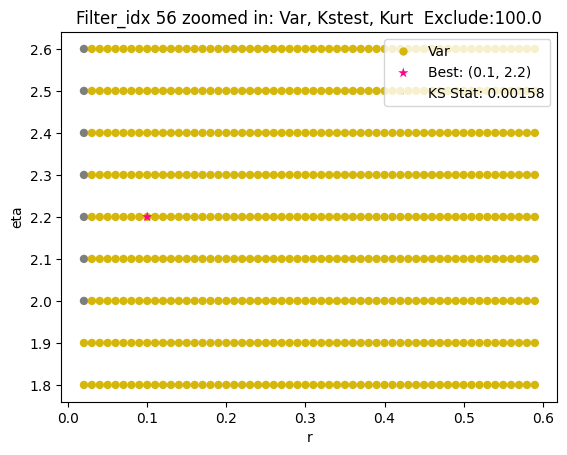

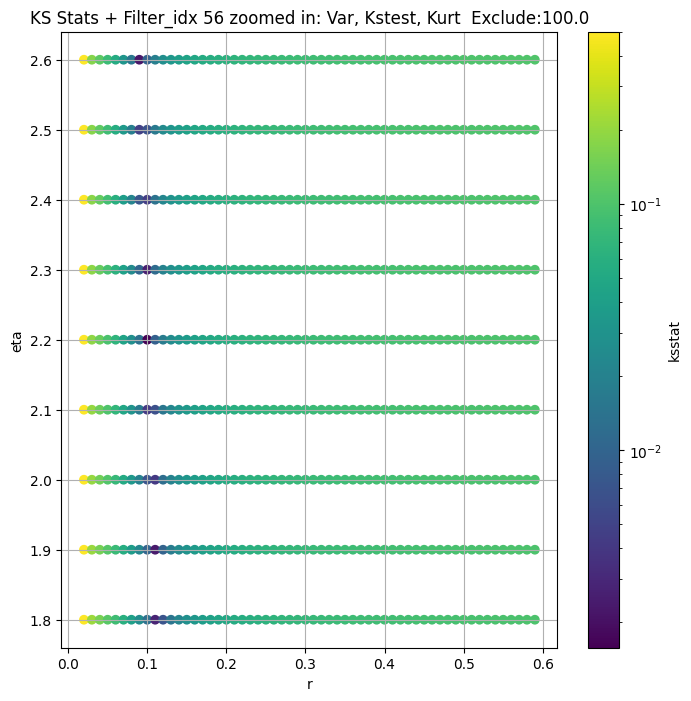

Filter_idx 57


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 57, 200.0 + 100 = 300, ksstat: 0.0058624312370073595, var: 17.59685326100499


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 57, 200.0 + 75 = 275, ksstat: 0.005441999684500987, var: 17.946756162762977


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 57, 200.0 + 50 = 250, ksstat: 0.005057031382488919, var: 18.327618260807288


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 57, 200.0 + 25 = 225, ksstat: 0.004610339997889401, var: 18.74637094083257


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 57, 200.0 + 0 = 200, ksstat: 0.0041505883901477025, var: 19.21277898717059


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 57, 200.0 + -25 = 175, ksstat: 0.003856257278956665, var: 19.740976447124684


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 57, 200.0 + -50 = 150, ksstat: 0.004210863608587023, var: 20.35319102680394


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 57, 200.0 + -75 = 125, ksstat: 0.004790019149370994, var: 21.08694576628338


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 57, 200.0 + -100 = 100, ksstat: 0.005321279586001149, var: 22.01163864390933
Number of samples: 100000, Without approximation : 786432000.0


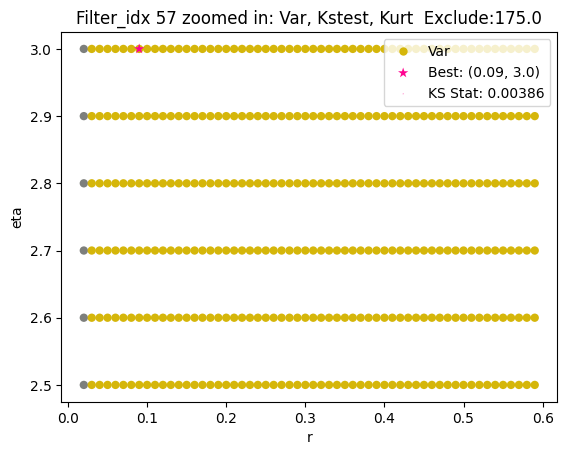

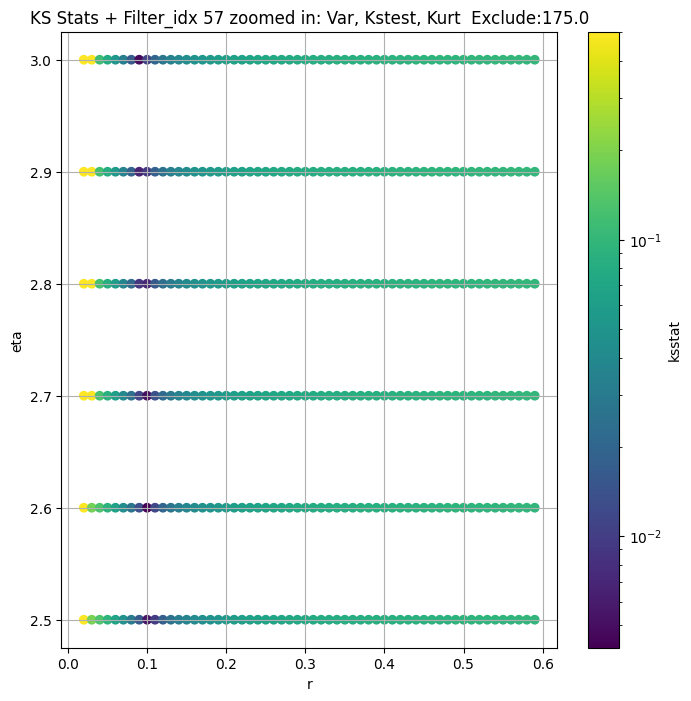

Filter_idx 58


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 58, 200.0 + 100 = 300, ksstat: 0.012269953084767693, var: 18.70459466656048


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 58, 200.0 + 75 = 275, ksstat: 0.01265046438202383, var: 19.067518064425066


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 58, 200.0 + 50 = 250, ksstat: 0.013036587198853866, var: 19.4703961149512


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 58, 200.0 + 25 = 225, ksstat: 0.013093026093971005, var: 19.924485548740385


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 58, 200.0 + 0 = 200, ksstat: 0.013799308495988205, var: 20.449981972221508


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 58, 200.0 + -25 = 175, ksstat: 0.0140292871452945, var: 21.070715573442023


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 58, 200.0 + -50 = 150, ksstat: 0.01462248089017626, var: 21.811160485358567


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 58, 200.0 + -75 = 125, ksstat: 0.015185735794865374, var: 22.716234718883843


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 58, 200.0 + -100 = 100, ksstat: 0.01611668178868192, var: 23.867477407921974
Number of samples: 100000, Without approximation : 786432000.0


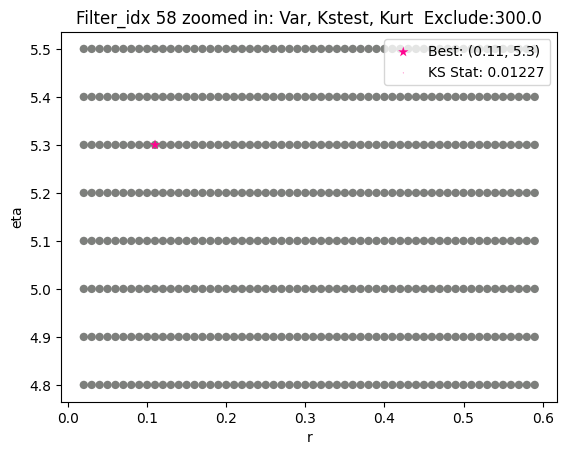

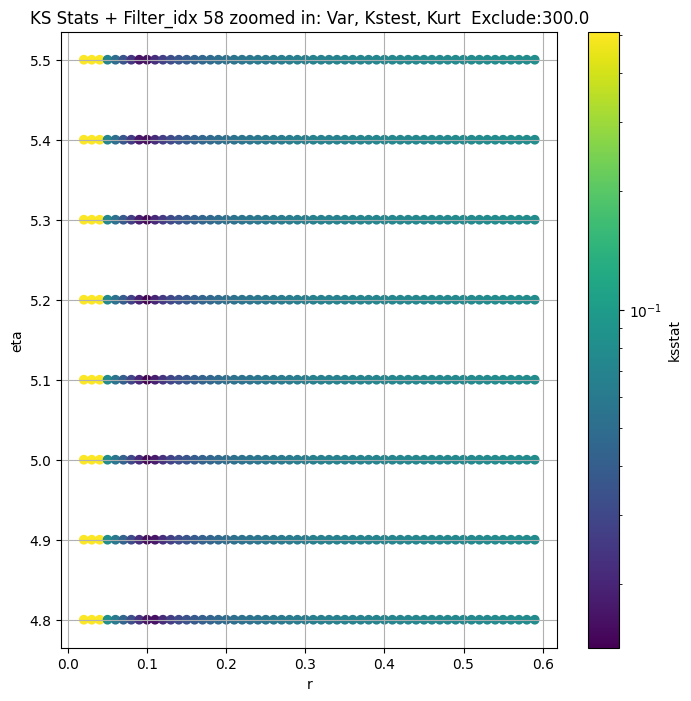

Filter_idx 59


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 59, 200.0 + 100 = 300, ksstat: 0.004843001985388895, var: 32.206184664614725


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 59, 200.0 + 75 = 275, ksstat: 0.004426359641466204, var: 32.856443272434674


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 59, 200.0 + 50 = 250, ksstat: 0.004020760511714072, var: 33.573825363791926


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 59, 200.0 + 25 = 225, ksstat: 0.0035666388403276204, var: 34.3755434451125


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 59, 200.0 + 0 = 200, ksstat: 0.003178401603137761, var: 35.286161978397764


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 59, 200.0 + -25 = 175, ksstat: 0.002782359625697471, var: 36.34172600235276


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 59, 200.0 + -50 = 150, ksstat: 0.00286715974603291, var: 37.59726643359074


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 59, 200.0 + -75 = 125, ksstat: 0.0034988338672258257, var: 39.14438495843282


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 59, 200.0 + -100 = 100, ksstat: 0.004718244661965021, var: 41.137190465551456
Number of samples: 100000, Without approximation : 786432000.0


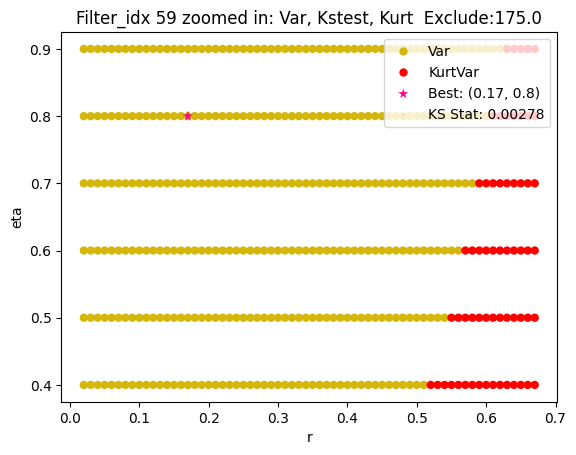

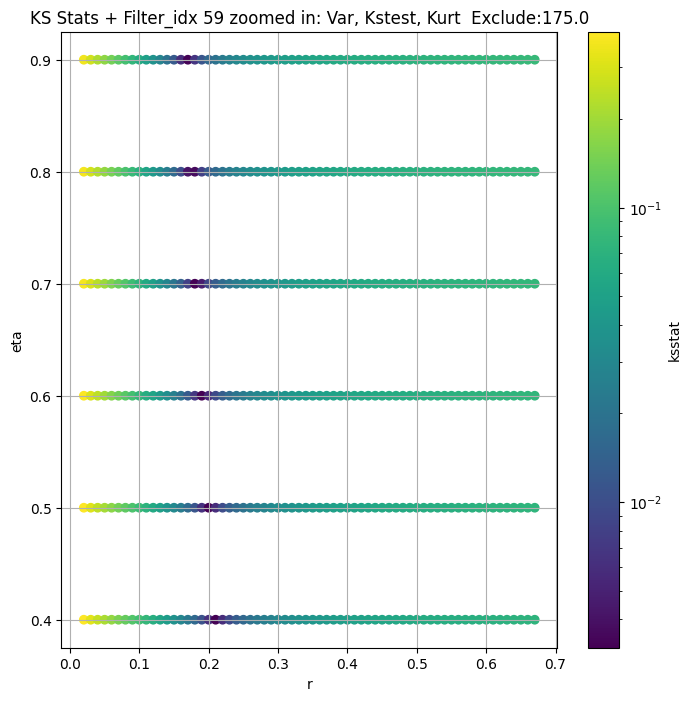

Filter_idx 60


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 200.0 + 100 = 300, ksstat: 0.01528905881770981, var: 1.6230093636089329


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 200.0 + 75 = 275, ksstat: 0.015251944820577457, var: 1.660596441080167


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 200.0 + 50 = 250, ksstat: 0.015295910037664284, var: 1.7019634578420684


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 200.0 + 25 = 225, ksstat: 0.015501538703229567, var: 1.747965155320904


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 200.0 + 0 = 200, ksstat: 0.015839410493215106, var: 1.7995922603122116


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 200.0 + -25 = 175, ksstat: 0.015966257568202746, var: 1.8586377523130237


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 200.0 + -50 = 150, ksstat: 0.01656038839291485, var: 1.9276991997181265


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 200.0 + -75 = 125, ksstat: 0.017184360067470594, var: 2.010931268936961


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 200.0 + -100 = 100, ksstat: 0.017516518875058673, var: 2.1155681474622763
Number of samples: 100000, Without approximation : 786432000.0


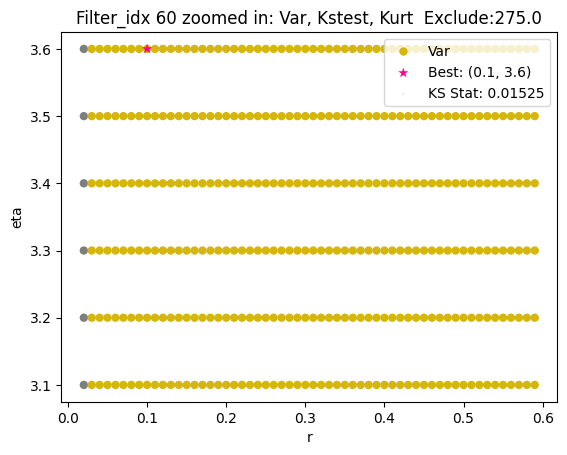

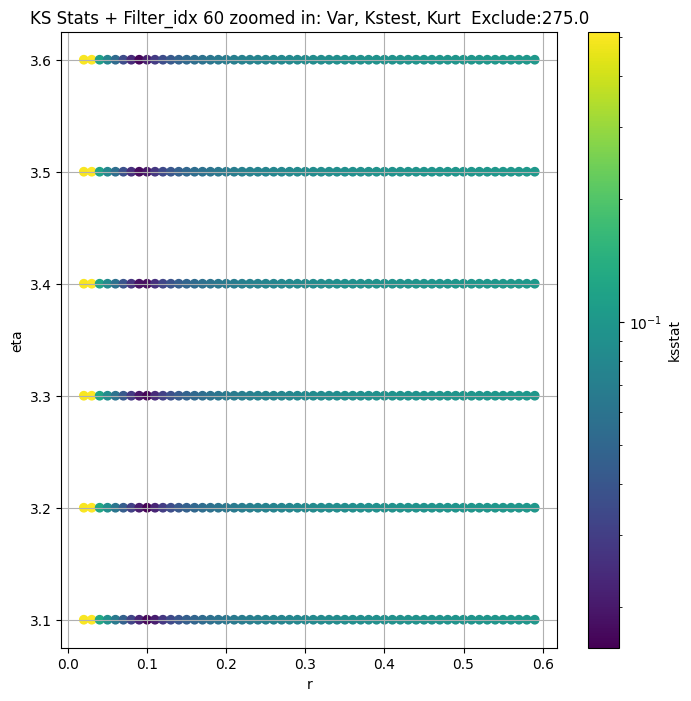

Filter_idx 61


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 61, 200.0 + 100 = 300, ksstat: 0.005084746814590035, var: 14.016800119706025


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 61, 200.0 + 75 = 275, ksstat: 0.004680656343830969, var: 14.346006718283151


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 61, 200.0 + 50 = 250, ksstat: 0.0042986702625888995, var: 14.707009350581433


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 61, 200.0 + 25 = 225, ksstat: 0.003921992238211547, var: 15.10647041245425


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 61, 200.0 + 0 = 200, ksstat: 0.003519907654316645, var: 15.552951597379858


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 61, 200.0 + -25 = 175, ksstat: 0.0033502256646129602, var: 16.058686248278725


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 61, 200.0 + -50 = 150, ksstat: 0.004262854809492178, var: 16.641422449077716


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 61, 200.0 + -75 = 125, ksstat: 0.005488062057536158, var: 17.32944263558773


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 61, 200.0 + -100 = 100, ksstat: 0.0051764001274705596, var: 18.170976835507066
Number of samples: 100000, Without approximation : 786432000.0


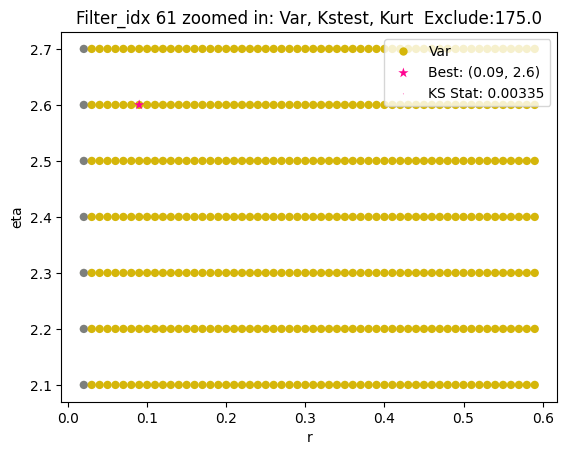

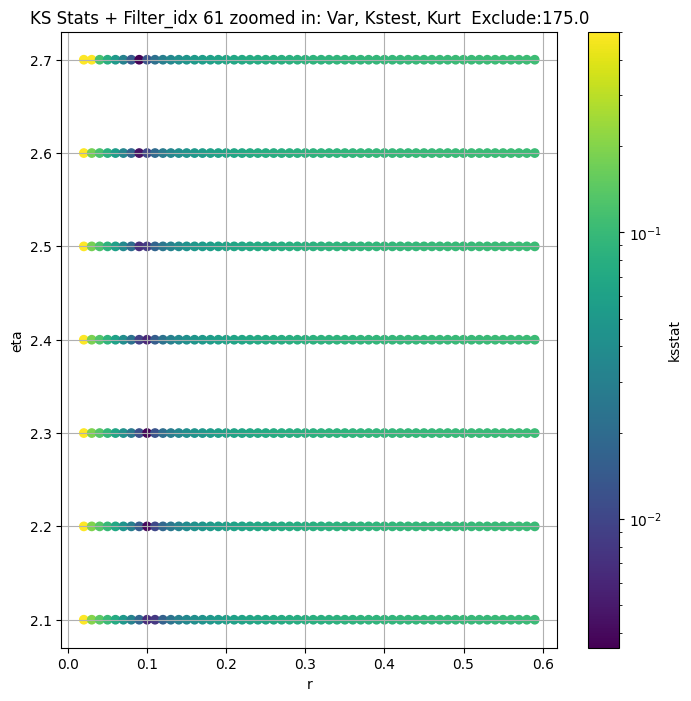

Filter_idx 62


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 62, 100.0 + 100 = 200, ksstat: 0.006715550401347303, var: 14.862886925848077


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 62, 100.0 + 75 = 175, ksstat: 0.006321657477999135, var: 15.314028056559994


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 62, 100.0 + 50 = 150, ksstat: 0.005735807119964506, var: 15.844526706942627


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 62, 100.0 + 25 = 125, ksstat: 0.005587361067819749, var: 16.489754845683237


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 62, 100.0 + 0 = 100, ksstat: 0.0053373598991489635, var: 17.314135778090947


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 62, 100.0 + -25 = 75, ksstat: 0.005528980068246037, var: 18.44999806662658


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 62, 100.0 + -50 = 50, ksstat: 0.005909845494223298, var: 20.2025445404153


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 62, 100.0 + -75 = 25, ksstat: 0.006163729471509248, var: 23.52937238901703


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 62, 100.0 + -100 = 0, ksstat: 0.020616211242914025, var: 56.22971547569739
Number of samples: 100000, Without approximation : 786432000.0


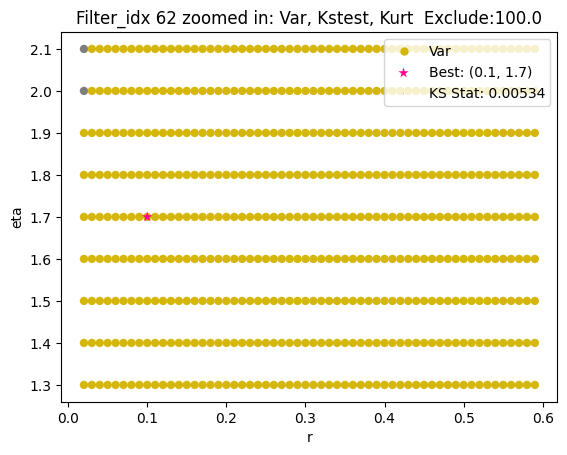

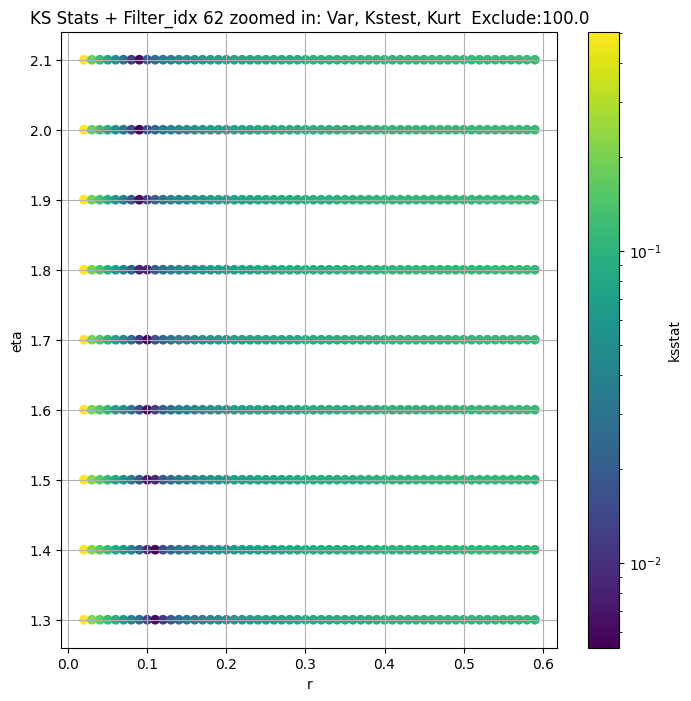

Filter_idx 63


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 63, 200.0 + 100 = 300, ksstat: 0.00633335413160474, var: 5.192294531912647


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 63, 200.0 + 75 = 275, ksstat: 0.005992646889762643, var: 5.31973944225475


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 63, 200.0 + 50 = 250, ksstat: 0.006392933950870983, var: 5.458790435620903


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 63, 200.0 + 25 = 225, ksstat: 0.006244108872269782, var: 5.611930292688618


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 63, 200.0 + 0 = 200, ksstat: 0.006373389580800803, var: 5.782450861737567


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 63, 200.0 + -25 = 175, ksstat: 0.007566840300273381, var: 5.975028916720936


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 63, 200.0 + -50 = 150, ksstat: 0.007994427617185607, var: 6.196547713890148


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 63, 200.0 + -75 = 125, ksstat: 0.009157455244842294, var: 6.457872083834383


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 63, 200.0 + -100 = 100, ksstat: 0.010155825682026332, var: 6.777668628569047
Number of samples: 100000, Without approximation : 786432000.0


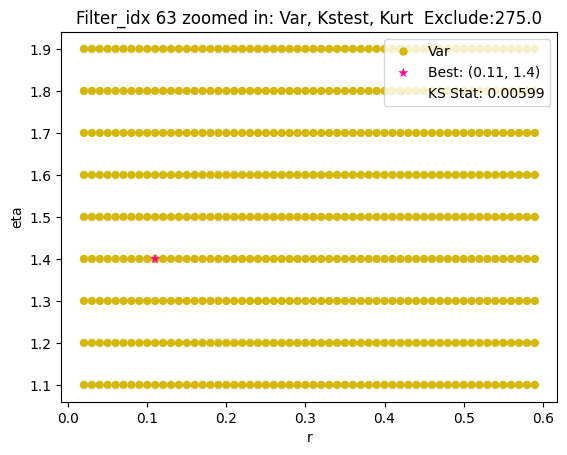

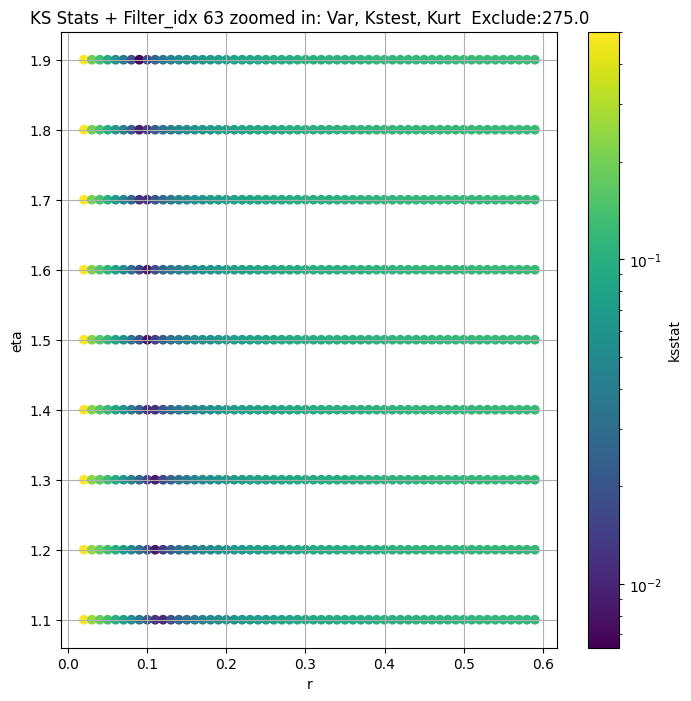

,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,initial_r,...,initial_scale,initial_exclude_cutoff,best_augmented_var,kstest_stat_cutoff_0.05,kstest_stat_best,best_r,best_eta,best_scale,best_exclude_cutoff,n_pval_0.05
filter_idx,,,,,,,,,,,,,,,,,,,,,
0,105.627108,37.405882,872.914854,1200.635499,7.004659,839.339075,786432000.0,dual_color,0.002043,0.1,...,2.571762e-15,100.0,45.998250,0.000048,0.002018,0.10,2.4,1.937997e-15,125.0,432000
2,160.716134,56.549257,1519.894028,1504.172784,6.669132,893.046912,786432000.0,dual_color,0.001901,0.1,...,4.886788e-15,100.0,68.834649,0.000048,0.001709,0.11,2.0,5.188928e-13,125.0,648000
3,59.288343,17.905150,647.920804,4685.193534,14.040535,916.223182,786432000.0,single_edge,0.006504,0.1,...,3.805328e-15,200.0,18.340643,0.000048,0.004364,0.11,1.7,2.849450e-13,275.0,96000
4,151.160931,51.854637,1313.650861,1464.834926,7.111011,828.869069,786432000.0,dual_color,0.002376,0.1,...,5.662153e-15,100.0,69.498874,0.000048,0.001247,0.10,1.9,9.988880e-15,75.0,1152000
5,60.719316,18.078568,688.166568,2347.202815,8.981808,920.485126,786432000.0,dual_color,0.005098,0.1,...,3.556848e-16,200.0,21.863551,0.000048,0.004900,0.10,2.6,5.865309e-16,150.0,81000
6,53.370521,16.667455,734.884189,3356.859484,7.065387,907.363143,786432000.0,single_edge,0.003947,0.1,...,2.701811e-16,200.0,21.032426,0.000048,0.003559,0.10,2.6,5.642344e-16,125.0,144000
7,75.992599,26.422622,442.863026,615.866020,6.994462,770.913021,786432000.0,inside_out,0.016451,0.1,...,4.523301e-17,100.0,34.630677,0.000048,0.016451,0.10,4.2,4.523301e-17,100.0,6750
8,2.395725,0.557518,66.139435,9346.824402,9.244470,970.442983,786432000.0,misc,0.021073,0.1,...,8.776220e-18,200.0,0.563403,0.000048,0.019972,0.12,2.5,4.898223e-14,300.0,4500
9,21.424416,3.685756,591.276779,12551.392811,13.515366,968.833048,786432000.0,multi_edge,0.014015,0.1,...,4.008208e-14,200.0,3.991429,0.000048,0.011098,0.09,0.9,8.790265e-17,275.0,15187


In [14]:
master_df_optimized_path = Path(os.path.join(CWD, "CSVs", 'master_df_optimized.csv'))

NUM_ITERS = dict(zip(GROUPS, [1]*len(GROUPS))) # By default, does one iteration per group
NUM_SAMPLES_OPTIMIZE = 2000
EXCLUDE_CUTOFFS_OPTIMIZE = np.arange(100, -101, -25)

if RERUN or not master_df_optimized_path.exists():

    if SKIP_OPTIMIZE_STEP:

        master_df['kstest_stat_best'] = master_df['kstest_stat_initial']
        master_df[f'best_r'] = master_df['initial_r']
        master_df[f'best_eta'] = master_df['initial_eta']
        master_df[f'best_scale'] = master_df['initial_scale']
        master_df[f'best_exclude_cutoff'] = master_df['initial_exclude_cutoff']

    else:
        for group in GROUPS: # TODO For quick testing purposes
            print(f"{GROUP.capitalize()} {group}")
            master_df.loc[group, 'kstest_stat_best'] = master_df.loc[group, 'kstest_stat_initial']
            master_df.loc[group, 'best_r'] = master_df.loc[group, 'initial_r']
            master_df.loc[group, 'best_eta'] = master_df.loc[group, 'initial_eta']
            master_df.loc[group, 'best_scale'] = master_df.loc[group, 'initial_scale']

            sample = group_data_map[group]
            if len(sample) == 0:
                continue
            initial_r, initial_eta = master_df.loc[group, 'initial_r'], master_df.loc[group, f'initial_eta']
            eps = 0.5
            group_cdfs_df = fine_cdfs_df[(np.abs(master_df.loc[group, 'initial_r'] - fine_cdfs_df['r']) < eps) & 
                                        (np.abs(master_df.loc[group, 'initial_eta'] - fine_cdfs_df['eta']) < eps)].reset_index(drop=True)
            group_cdfs = {x[0]:x[1] for x in group_cdfs_df['(r,eta),cdf']}

            for adjust_exclude_cutoff in EXCLUDE_CUTOFFS_OPTIMIZE: # -50, -25, 0, 25, 50
                
                exclude_cutoff = int(max(0, adjust_exclude_cutoff + master_df.loc[group, 'initial_exclude_cutoff']))
                
                if exclude_cutoff == 0:
                    augmented_var = np.var(group_data_map[group])
                else:
                    augmented_var = np.var(group_data_map[group][exclude_cutoff:-exclude_cutoff])                       

                group_cdfs_df['scale'] = np.clip((augmented_var / group_cdfs_df['variance']), 0,  SCALE_CAP)
                ksstats, initial_param, min_stat = gridsearch(sample, group_cdfs, debug=True, scales=group_cdfs_df['scale'])
                
                cutoff_label = generate_cutoff_label(adjust_exclude_cutoff)

                augmented_var_df.loc[group, f"kstest_stat_{cutoff_label}"] = min_stat
                group_cdfs_df[f'ksstat_exclude_{cutoff_label}'] = ksstats
                
                print(f"{GROUP} {group}, {master_df.loc[group, 'initial_exclude_cutoff']} + {adjust_exclude_cutoff} = {exclude_cutoff}, ksstat: {min_stat}, var: {augmented_var}")
                best_adjust = 0

                if min_stat < master_df.loc[group, 'kstest_stat_best']:

                    inital_min_stat = min_stat
                    inital_best_param = initial_param
                    master_df.loc[group, 'kstest_stat_best'] = min_stat
                    initial_scale = group_cdfs_df.loc[(group_cdfs_df["r"] ==  initial_param[0]) & (group_cdfs_df["eta"] ==  initial_param[1])]["scale"].iloc[0]
                    master_df.loc[group, 'best_r'], master_df.loc[group, 'best_eta'] = initial_param
                    master_df.loc[group, 'best_scale'] = initial_scale
                    master_df.loc[group, 'best_exclude_cutoff'] = exclude_cutoff
                    master_df.loc[group, 'best_augmented_var'] = augmented_var
                    augmented_var_df.loc[group, 'best_augmented_var'] = augmented_var
                    best_adjust = adjust_exclude_cutoff

                if exclude_cutoff == 0:
                    break

            cutoff_label = generate_cutoff_label(best_adjust)
            ksstats = group_cdfs_df[f"ksstat_exclude_{cutoff_label}"]
            
            print(f"Number of samples: {sample.size}, Without approximation : {master_df.loc[group, 'total_samples']}")
            
            cutoff = stats.kstwo(n=master_df.loc[group, 'total_samples']).isf(0.05)
            master_df.loc[group, 'kstest_stat_cutoff_0.05'] = cutoff

            best_scales = np.clip((master_df.loc[group, 'best_augmented_var'] / group_cdfs_df['variance']), 0,  SCALE_CAP)

            group_cdfs_df['variance'] = group_cdfs_df['variance'] * best_scales
            group_cdfs_df['kurtosis'] = group_cdfs_df['kurtosis'] * best_scales

            group_cdfs_df = add_tests_to_df(cdfs_df = group_cdfs_df, group = group, var_kurt_df = master_df, ksstats = ksstats).sort_values(['r', 'eta'])

            group_dict = rEtaKsstats_dict[group]
            group_dict.update({'r_optimize' : group_cdfs_df['r'], 'eta_optimize' : group_cdfs_df['eta'], f'ksstat_exclude_{cutoff_label}' : ksstats})
            rEtaKsstats_dict[group] = group_dict

            cols = ['pass_var', 'pass_kstest', 'pass_kurt']
            fig = combo_test_plot(group_cdfs_df, cols, 
                                plot_name=f"{GROUP.capitalize()} {group} zoomed in: {', '.join([col[5:].capitalize() for col in cols])}  Exclude:{master_df.loc[group, 'best_exclude_cutoff']}",
                                best_param=(master_df.loc[group, 'best_r'], master_df.loc[group, f'best_eta']),
                                best_ksstat=master_df.loc[group, 'kstest_stat_best'])
            fig.figure.savefig(os.path.join(CWD, "plots", f"optimized_full_grid_search_combo_plot_layer{group}.jpg"), bbox_inches = 'tight', dpi=100)
            
    master_df['n_pval_0.05'] = master_df.apply(lambda row : find_n_fixed_pval_stat(row.loc['kstest_stat_best'], row.loc['total_samples']), axis = 1)    
    master_df[['total_samples', 'initial_r', 'initial_eta', 'kstest_stat_initial', 'initial_exclude_cutoff', 'best_r', 'best_eta', 'best_scale', 'kstest_stat_best', 'best_exclude_cutoff', 'n_pval_0.05']].to_csv(os.path.join(CWD, "CSVs", 'optimized_params.csv'))
    master_df.to_csv(os.path.join(CWD, "CSVs", 'master_df_optimized.csv'))
    augmented_var_df.to_csv(augmented_var_df_path)
    pd.to_pickle(rEtaKsstats_dict, rEtaKsstats_dict_path)

rEtaKsstats_dict = pd.read_pickle(rEtaKsstats_dict_path)
master_df = pd.read_csv(master_df_optimized_path, index_col = GROUP)
augmented_var_df = pd.read_csv(augmented_var_df_path, index_col = GROUP)
master_df

## Comparing Empirical and Computed CDF/PDF

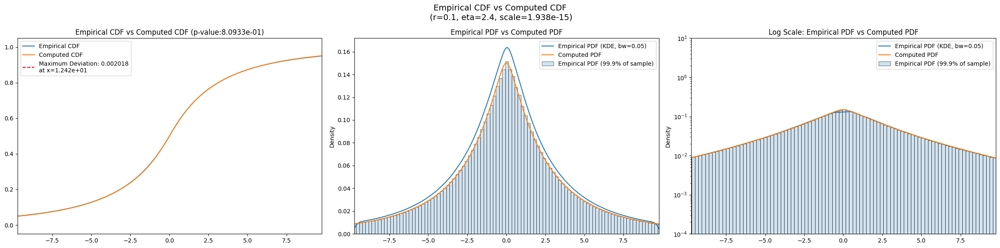

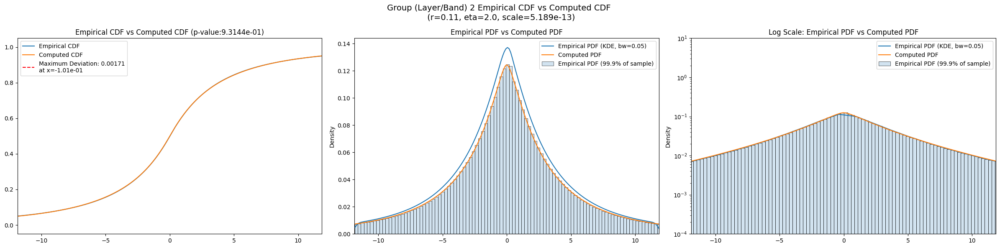

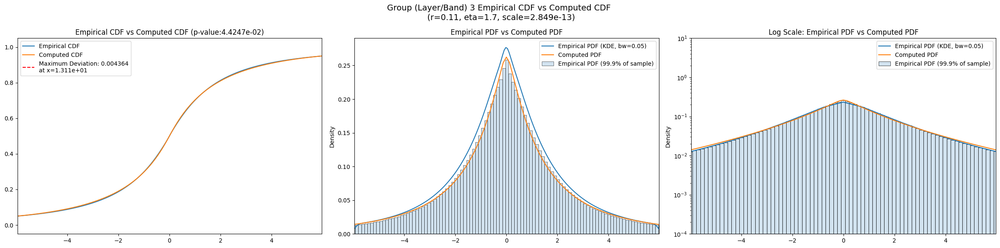

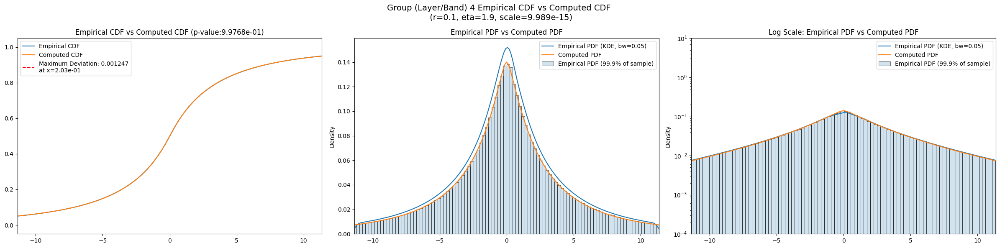

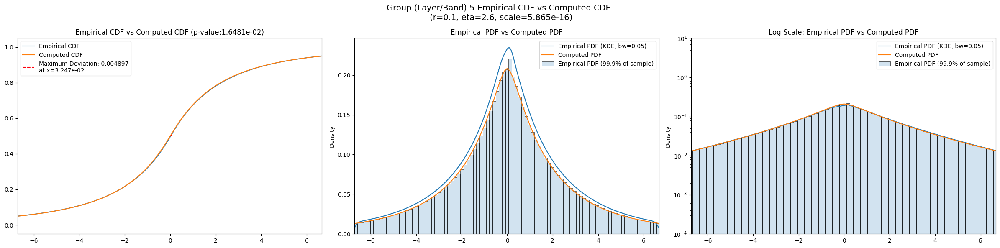

...

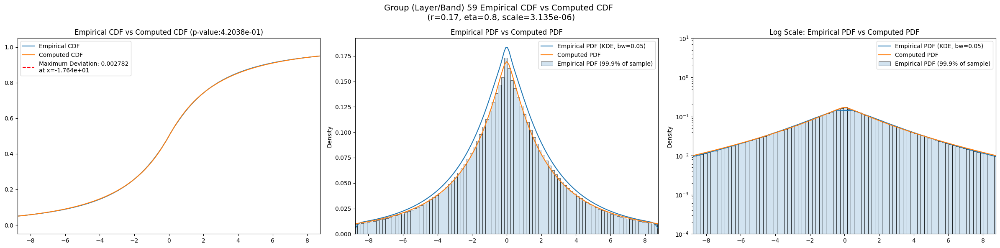

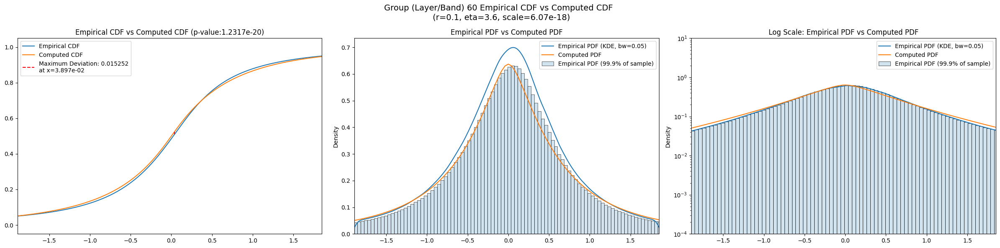

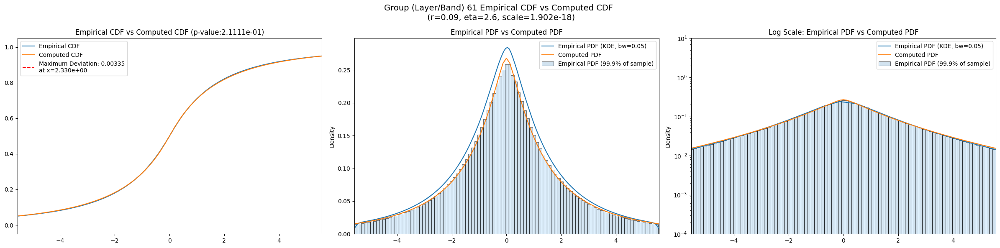

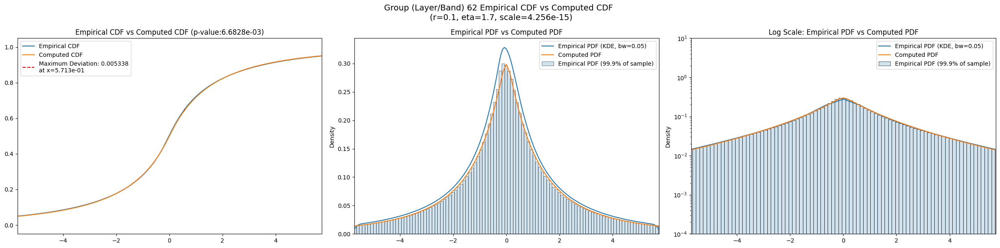

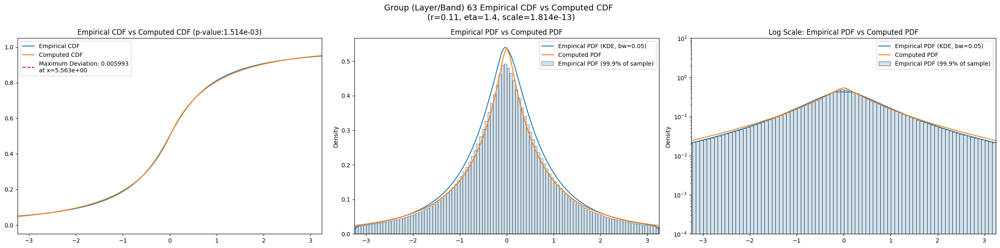

In [15]:
for group in GROUPS:
    group_info = master_df.loc[group]
    best_r = group_info['best_r']
    best_eta = group_info['best_eta']
    best_scale = group_info['best_scale']
    fig = visualize_cdf_pdf(sample = group_data_map[group], 
                    params = (best_r, best_eta, best_scale), 
                    log_scale = True,
                    group = group)
    fig.savefig(os.path.join(CWD, "plots", f'compare_cdf_pdf_layer_{group}.jpg'), bbox_inches = 'tight', dpi = 100)

## Comparing with Gaussian and Laplace Priors

In [16]:
def generate_func(sample, distro, *args, n_samples=200):
    if distro == 'gaussian' or distro == 'normal':
        def var_func(var):
            cdf = scipy.stats.norm(scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 'laplace':
        def var_func(var):
            cdf = scipy.stats.laplace(scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 't':
        def var_func(var):
            cdf = scipy.stats.t(df=2, scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 'prior_r':
        eta = args[0]
        def r_func(r):
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples)
            return compute_ksstat(sample, cdf)
        return r_func
    elif distro == 'prior_eta':
        r = args[0]
        def eta_func(eta):
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples)
            return compute_ksstat(sample, cdf)
        return eta_func
    elif distro == 'prior':
        def r_eta_func(params):
            r = params[0]
            eta = params[1]
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples, debug=False)
            return compute_ksstat(sample, cdf)
        return r_eta_func
    elif distro == 'prior_with_scale':
        def r_eta_scale_func(params):
            r = params[0]
            eta = params[1]
            scale = params[2]
            print(r, eta, scale)
            cdf = compute_prior_cdf(r = r, eta = eta, n_samples=n_samples, debug=False)
            return compute_ksstat(sample/ np.sqrt(scale), cdf)
        return r_eta_scale_func

    print("Please enter a valid argument for `distro`: 'gaussian', 'laplace', 'prior_r', 'prior_eta', 'prior','prior_with_scale', 't'")

In [17]:
master_df_path = Path(os.path.join(CWD, "CSVs", 'master_df.csv'))

if RERUN or not master_df_path.exists():
    upper_bound = int(1e6)
    for group in GROUPS:
        if len(group_data_map[group]) == 0:
            continue
        norm_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 'gaussian'), method = 'bounded', bounds = (0, upper_bound))
        laplace_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 'laplace'), method = 'bounded', bounds = (0, upper_bound))
        t_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 't'), method = 'bounded', bounds = (0, upper_bound))
        
        master_df.loc[group, 'param_gaussian'] = round_to_sigfigs(norm_result['x'], 6)
        master_df.loc[group, 'kstest_stat_gaussian'] = round_to_sigfigs(norm_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_gaussian'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_gaussian']), 6)

        master_df.loc[group, 'param_laplace'] = round_to_sigfigs(laplace_result['x'], 6)
        master_df.loc[group, 'kstest_stat_laplace'] = round_to_sigfigs(laplace_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_laplace'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_laplace']), 6)

        master_df.loc[group, 'param_laplace'] = round_to_sigfigs(laplace_result['x'], 6)
        master_df.loc[group, 'kstest_stat_laplace'] = round_to_sigfigs(laplace_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_laplace'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_laplace']), 6) 

        master_df.loc[group, 'param_t'] = round_to_sigfigs(t_result['x'], 6)
        master_df.loc[group, 'kstest_stat_t'] = round_to_sigfigs(t_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_t'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_t']), 6) 

        master_df.loc[group, 'kstest_pval_gengamma'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_best']))

    master_df.to_csv(os.path.join(CWD, "CSVs", 'master_df.csv'))
    
master_df = pd.read_csv(os.path.join(CWD, "CSVs", 'master_df.csv'), index_col = GROUP)
master_df

,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,initial_r,...,param_gaussian,kstest_stat_gaussian,kstest_pval_gaussian,param_laplace,kstest_stat_laplace,kstest_pval_laplace,param_t,kstest_stat_t,kstest_pval_t,kstest_pval_gengamma
filter_idx,,,,,,,,,,,,,,,,,,,,,
0,105.627108,37.405882,872.914854,1200.635499,7.004659,839.339075,786432000.0,dual_color,0.002043,0.1,...,4.122940,0.043396,0.0,3.639720,0.016738,0.0,2.908350,0.015388,0.0,0.0
2,160.716134,56.549257,1519.894028,1504.172784,6.669132,893.046912,786432000.0,dual_color,0.001901,0.1,...,5.001290,0.043616,0.0,4.417210,0.016907,0.0,3.509700,0.015862,0.0,0.0
3,59.288343,17.905150,647.920804,4685.193534,14.040535,916.223182,786432000.0,single_edge,0.006504,0.1,...,2.472890,0.044104,0.0,2.198940,0.019001,0.0,1.734190,0.014717,0.0,0.0
4,151.160931,51.854637,1313.650861,1464.834926,7.111011,828.869069,786432000.0,dual_color,0.002376,0.1,...,4.676870,0.046190,0.0,4.115170,0.018865,0.0,3.287210,0.019210,0.0,0.0
5,60.719316,18.078568,688.166568,2347.202815,8.981808,920.485126,786432000.0,dual_color,0.005098,0.1,...,2.873800,0.042674,0.0,2.532420,0.015563,0.0,2.022090,0.016594,0.0,0.0
6,53.370521,16.667455,734.884189,3356.859484,7.065387,907.363143,786432000.0,single_edge,0.003947,0.1,...,2.805360,0.041875,0.0,2.482710,0.015651,0.0,1.968090,0.013932,0.0,0.0
7,75.992599,26.422622,442.863026,615.866020,6.994462,770.913021,786432000.0,inside_out,0.016451,0.1,...,3.783000,0.034505,0.0,3.547970,0.017882,0.0,2.734290,0.016449,0.0,0.0
8,2.395725,0.557518,66.139435,9346.824402,9.244470,970.442983,786432000.0,misc,0.021073,0.1,...,0.463887,0.044583,0.0,0.414883,0.020540,0.0,0.325108,0.017985,0.0,0.0
9,21.424416,3.685756,591.276779,12551.392811,13.515366,968.833048,786432000.0,multi_edge,0.014015,0.1,...,0.830513,0.061612,0.0,0.747385,0.037862,0.0,0.582514,0.031566,0.0,0.0


## Results

In [18]:
import pandas as pd
import os
master_df = pd.read_csv(os.path.join(os.getcwd(), "CSVs", 'master_df.csv'), index_col = 0)

In [19]:
master_df.filter(regex="kstest_stat.*")

,kstest_stat_initial,kstest_stat_cutoff_0.05,kstest_stat_best,kstest_stat_gaussian,kstest_stat_laplace,kstest_stat_t
filter_idx,,,,,,
0,0.002043,0.000048,0.002018,0.043396,0.016738,0.015388
2,0.001901,0.000048,0.001709,0.043616,0.016907,0.015862
3,0.006504,0.000048,0.004364,0.044104,0.019001,0.014717
4,0.002376,0.000048,0.001247,0.046190,0.018865,0.019210
5,0.005098,0.000048,0.004900,0.042674,0.015563,0.016594
6,0.003947,0.000048,0.003559,0.041875,0.015651,0.013932
7,0.016451,0.000048,0.016451,0.034505,0.017882,0.016449
8,0.021073,0.000048,0.019972,0.044583,0.020540,0.017985
9,0.014015,0.000048,0.011098,0.061612,0.037862,0.031566


In [20]:
master_df.filter(regex="best.*")

,best_augmented_var,kstest_stat_best,best_r,best_eta,best_scale,best_exclude_cutoff
filter_idx,,,,,,
0,45.998250,0.002018,0.10,2.4,1.937997e-15,125.0
2,68.834649,0.001709,0.11,2.0,5.188928e-13,125.0
3,18.340643,0.004364,0.11,1.7,2.849450e-13,275.0
4,69.498874,0.001247,0.10,1.9,9.988880e-15,75.0
5,21.863551,0.004900,0.10,2.6,5.865309e-16,150.0
6,21.032426,0.003559,0.10,2.6,5.642344e-16,125.0
7,34.630677,0.016451,0.10,4.2,4.523301e-17,100.0
8,0.563403,0.019972,0.12,2.5,4.898223e-14,300.0
9,3.991429,0.011098,0.09,0.9,8.790265e-17,275.0
